We are import package to analyse,perform eda,build different models,evaluate and compare them with visualization.

In [1497]:
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")

%matplotlib inline
import numpy as np
import missingno as msno
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import ydata_profiling
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import colors as mcolors
import pickle
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import *
from sklearn import tree
from sklearn.metrics import accuracy_score,confusion_matrix
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor,plot_tree
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GridSearchCV
from yellowbrick.cluster import KElbowVisualizer,SilhouetteVisualizer
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from ydata_profiling import ProfileReport
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score as sil_score
from scipy.stats import linregress
from sklearn.ensemble import IsolationForest
from tabulate import tabulate
from collections import Counter

Now we are load the earthquake data. I have got the earthquake dataset from kaggle.

In [1498]:
df=pd.read_csv(r"C:/Users/Lenovo/Downloads/Machine Learning/Earthquake/all_month.csv")

We are performing this to get first 5 data from the dataset so we can understand the data better. We also can know what are the columns in it and what does it refers to.

In [1499]:
df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,2025-05-17T02:07:34.810Z,38.810665,-122.822334,3.03,0.31,md,9.0,75.0,0.00564,0.02,...,2025-05-17T02:09:12.695Z,"7 km NW of The Geysers, CA",earthquake,0.50,1.730,0.120,9.0,automatic,nc,nc
1,2025-05-17T02:03:31.570Z,33.971333,-116.824000,16.24,0.78,ml,23.0,54.0,0.06507,0.18,...,2025-05-17T02:07:02.926Z,"7 km NNW of Cabazon, CA",earthquake,0.33,0.710,0.173,17.0,automatic,ci,ci
2,2025-05-17T01:37:15.600Z,36.791832,-121.391335,5.27,1.22,md,8.0,123.0,0.05276,0.04,...,2025-05-17T01:52:15.949Z,"3 km SW of Ridgemark, CA",earthquake,0.37,1.050,0.120,7.0,automatic,nc,nc
3,2025-05-17T01:31:48.466Z,60.774200,-150.996600,22.20,1.30,ml,NaN,NaN,NaN,0.37,...,2025-05-17T01:33:41.485Z,"18 km ENE of Nikiski, Alaska",earthquake,NaN,0.600,NaN,NaN,automatic,ak,ak
4,2025-05-17T01:11:24.500Z,-57.115000,-67.591500,10.00,4.50,mb,25.0,146.0,3.19200,0.66,...,2025-05-17T01:32:37.040Z,"260 km S of Ushuaia, Argentina",earthquake,13.66,1.946,0.124,19.0,reviewed,us,us


Here we got information about the columns in the dataset:</br>
time:Date and time the earthquake occured.</br>
latitude:Latitude of the earthquake epicenter.</br>
longitude:Longitude of the earthquake epicenter.</br>
depth:Depth of the occured earthquke in the place of its epicenter.</br>
mag:Magnitude of the earthquake occured.</br>
magType:Type of magnitude(md-Duration magnitude,ml-local magnitude,mb-body wave magnitude,ms-surface wave magnitude,mw-moment magnitude).</br>
nst-Number of seismic stations that reported the event.</br>
gap-Azimuthal gap (in degrees) between the closest stations.</br>
dmin-Minimum distance to the nearest station (degrees).</br>
rms-Root mean square in wave amplitude.If its high it represent that there is high signal or inaccurate reading of measurment.</br>
net-Network that provides the data.</br>
id-Unique identifier of the earthquake occured.</br>
updates-Date and time when the earthqauke occured was last updated.</br>
place-Place where the earthquake occured so it can be easily identified by us.</br>
type-Type of natural disaster that occured(earthqauke,explosion).</br>
horizontalError-Horiontal location error.</br>
depthError-depth location error.</br>
magError-error in magnitude measuremnt.</br>
magNst-Number of stations used to calculate magnitude.</br>
status-	Status of the event (reviewed, automatic).</br>
locationSource-	Source of location data.</br>
magSource-	Source of magnitude data.</br>

In [1500]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9322 entries, 0 to 9321
Data columns (total 22 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   time             9322 non-null   object 
 1   latitude         9322 non-null   float64
 2   longitude        9322 non-null   float64
 3   depth            9322 non-null   float64
 4   mag              9322 non-null   float64
 5   magType          9322 non-null   object 
 6   nst              7863 non-null   float64
 7   gap              7863 non-null   float64
 8   dmin             7842 non-null   float64
 9   rms              9321 non-null   float64
 10  net              9322 non-null   object 
 11  id               9322 non-null   object 
 12  updated          9322 non-null   object 
 13  place            9322 non-null   object 
 14  type             9322 non-null   object 
 15  horizontalError  7262 non-null   float64
 16  depthError       9321 non-null   float64
 17  magError      

In this we get information of dataset like number of rows, number of columns, data types of columns.

In [1501]:
df.describe()

,latitude,longitude,depth,mag,nst,gap,dmin,rms,horizontalError,depthError,magError,magNst
count,9322.000000,9322.000000,9322.000000,9322.000000,7863.000000,7863.000000,7842.000000,9321.000000,7262.000000,9321.000000,7844.000000,7863.000000
mean,38.776965,-111.465961,21.482881,1.533558,23.517868,110.773876,0.467401,0.255477,1.683026,2.377984,0.176219,18.810886
std,19.453289,64.626982,51.131155,1.294392,23.854369,64.156888,1.950282,0.264021,3.179959,5.648885,0.103498,31.888973
min,-60.624000,-179.967700,-3.470000,-1.650000,2.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,33.893000,-149.462550,2.730000,0.730000,10.000000,65.000000,0.013400,0.070000,0.260000,0.430000,0.106000,7.000000
50%,38.817001,-122.103750,7.000000,1.300000,17.000000,92.000000,0.051850,0.160000,0.430000,0.710000,0.160000,12.000000
75%,51.637900,-114.424750,14.097500,2.000000,28.000000,145.000000,0.122300,0.360000,0.949168,1.700000,0.220000,21.000000
max,86.294500,179.889400,629.500000,7.400000,474.000000,358.180000,40.444000,1.610000,41.690000,135.200000,2.090000,825.000000


In this we describe the dataset like count of non-nul values in each columns,mean,standard deviation,minimum,25%-first quantile,50-median,75%-third quantile and maximum 

In [1502]:
df.describe(include="all")

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
count,9322,9322.000000,9322.000000,9322.000000,9322.000000,9322,7863.000000,7863.000000,7842.000000,9321.000000,...,9322,9322,9322,7262.000000,9321.000000,7844.000000,7863.000000,9322,9322,9322
unique,9322,NaN,NaN,NaN,NaN,10,NaN,NaN,NaN,NaN,...,9322,5280,5,NaN,NaN,NaN,NaN,2,15,15
top,2025-05-17T02:07:34.810Z,NaN,NaN,NaN,NaN,ml,NaN,NaN,NaN,NaN,...,2025-05-17T02:09:12.695Z,"7 km NW of The Geysers, CA",earthquake,NaN,NaN,NaN,NaN,reviewed,nc,nc
freq,1,NaN,NaN,NaN,NaN,5812,NaN,NaN,NaN,NaN,...,1,131,9091,NaN,NaN,NaN,NaN,7688,2191,2191
mean,NaN,38.776965,-111.465961,21.482881,1.533558,NaN,23.517868,110.773876,0.467401,0.255477,...,NaN,NaN,NaN,1.683026,2.377984,0.176219,18.810886,NaN,NaN,NaN
std,NaN,19.453289,64.626982,51.131155,1.294392,NaN,23.854369,64.156888,1.950282,0.264021,...,NaN,NaN,NaN,3.179959,5.648885,0.103498,31.888973,NaN,NaN,NaN
min,NaN,-60.624000,-179.967700,-3.470000,-1.650000,NaN,2.000000,10.000000,0.000000,0.000000,...,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN
25%,NaN,33.893000,-149.462550,2.730000,0.730000,NaN,10.000000,65.000000,0.013400,0.070000,...,NaN,NaN,NaN,0.260000,0.430000,0.106000,7.000000,NaN,NaN,NaN
50%,NaN,38.817001,-122.103750,7.000000,1.300000,NaN,17.000000,92.000000,0.051850,0.160000,...,NaN,NaN,NaN,0.430000,0.710000,0.160000,12.000000,NaN,NaN,NaN
75%,NaN,51.637900,-114.424750,14.097500,2.000000,NaN,28.000000,145.000000,0.122300,0.360000,...,NaN,NaN,NaN,0.949168,1.700000,0.220000,21.000000,NaN,NaN,NaN


In this we have include object type dataset also so we can have a overview of non-number data type also.

In [1503]:
df.columns

Index(['time', 'latitude', 'longitude', 'depth', 'mag', 'magType', 'nst',
       'gap', 'dmin', 'rms', 'net', 'id', 'updated', 'place', 'type',
       'horizontalError', 'depthError', 'magError', 'magNst', 'status',
       'locationSource', 'magSource'],
      dtype='object')

We can get what are the columns in the dataset.

In [1504]:
df.shape

(9322, 22)

We get how many rows and columns in the dataset. Now,we have (9322,22) in this dataset.

In [1505]:
report=ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 22/22 [00:00<00:00, 26.09it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Using this automatic eda code,we an get overview of dataset,variables in the dataset,interaction between the data like correlation,missing values.

In [1506]:
df.shape

(9322, 22)

In [1507]:
df.drop(['id', 'time', 'updated'], axis=1, inplace=True, errors='ignore')

Here, we are droping the id,time,updates columns from the dataset.It will not affect the dataset or dependent on any data.

In [1508]:
df.head()

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,38.810665,-122.822334,3.03,0.31,md,9.0,75.0,0.00564,0.02,nc,"7 km NW of The Geysers, CA",earthquake,0.50,1.730,0.120,9.0,automatic,nc,nc
1,33.971333,-116.824000,16.24,0.78,ml,23.0,54.0,0.06507,0.18,ci,"7 km NNW of Cabazon, CA",earthquake,0.33,0.710,0.173,17.0,automatic,ci,ci
2,36.791832,-121.391335,5.27,1.22,md,8.0,123.0,0.05276,0.04,nc,"3 km SW of Ridgemark, CA",earthquake,0.37,1.050,0.120,7.0,automatic,nc,nc
3,60.774200,-150.996600,22.20,1.30,ml,NaN,NaN,NaN,0.37,ak,"18 km ENE of Nikiski, Alaska",earthquake,NaN,0.600,NaN,NaN,automatic,ak,ak
4,-57.115000,-67.591500,10.00,4.50,mb,25.0,146.0,3.19200,0.66,us,"260 km S of Ushuaia, Argentina",earthquake,13.66,1.946,0.124,19.0,reviewed,us,us


We check the dataset to know whether the columns we dropped are not in the dataset.

In [1509]:
df.shape

(9322, 19)

Again we check the shape of the dataset after dropping some of the columns.

In [1510]:
def check_data(df):
    List=[]
    columns=df.columns
    for cols in columns:
        null_val=df[cols].isnull().sum()
        unique_val=df[cols].nunique()
        dtypes=df[cols].dtypes
        List.append([cols,null_val,unique_val,dtypes])
    df_check=pd.DataFrame(List)
    df_check.columns=["columns","null_val","unique_val","dtypes"]
    return df_check

check_data(df)    

,columns,null_val,unique_val,dtypes
0,latitude,0,7731,float64
1,longitude,0,8037,float64
2,depth,0,3789,float64
3,mag,0,534,float64
4,magType,0,10,object
5,nst,1459,164,float64
6,gap,1459,661,float64
7,dmin,1480,5817,float64
8,rms,1,487,float64
9,net,0,15,object


We get the null values,unique values and type of datas.

<Axes: >

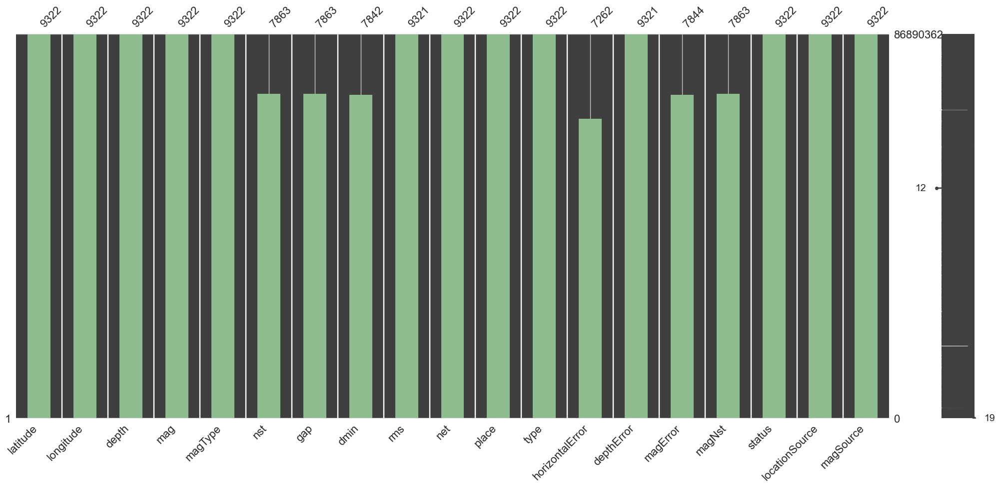

In [1511]:
msno.matrix(df)
msno.bar(df,color="DarkSeaGreen")

It visulaize the miising value of each columns.

In [1512]:
df.isnull().sum().sum()

9397

We get numerical value of sum of null values.

In [1513]:
df=df.dropna()

We drop the null values so it does not affect the dataset during the processing part.

In [1514]:
df.isnull().sum().sum()

0

After dropping the null values we have no null values remaining in the dataset.So there will be no effect on the model due to null values.

In [1515]:
df.shape

(7223, 19)

Now we again check the shape of the dataset. Before dropping the null value the shape of the dataset was (9322, 19) ,after dropping the null value it shows (7223, 19). So there is a difference of (2099,3).

In [1516]:
df.duplicated().sum()

0

Now we check for the duplicates data in the dataset(i.e.,if the same value is repreated in the column).

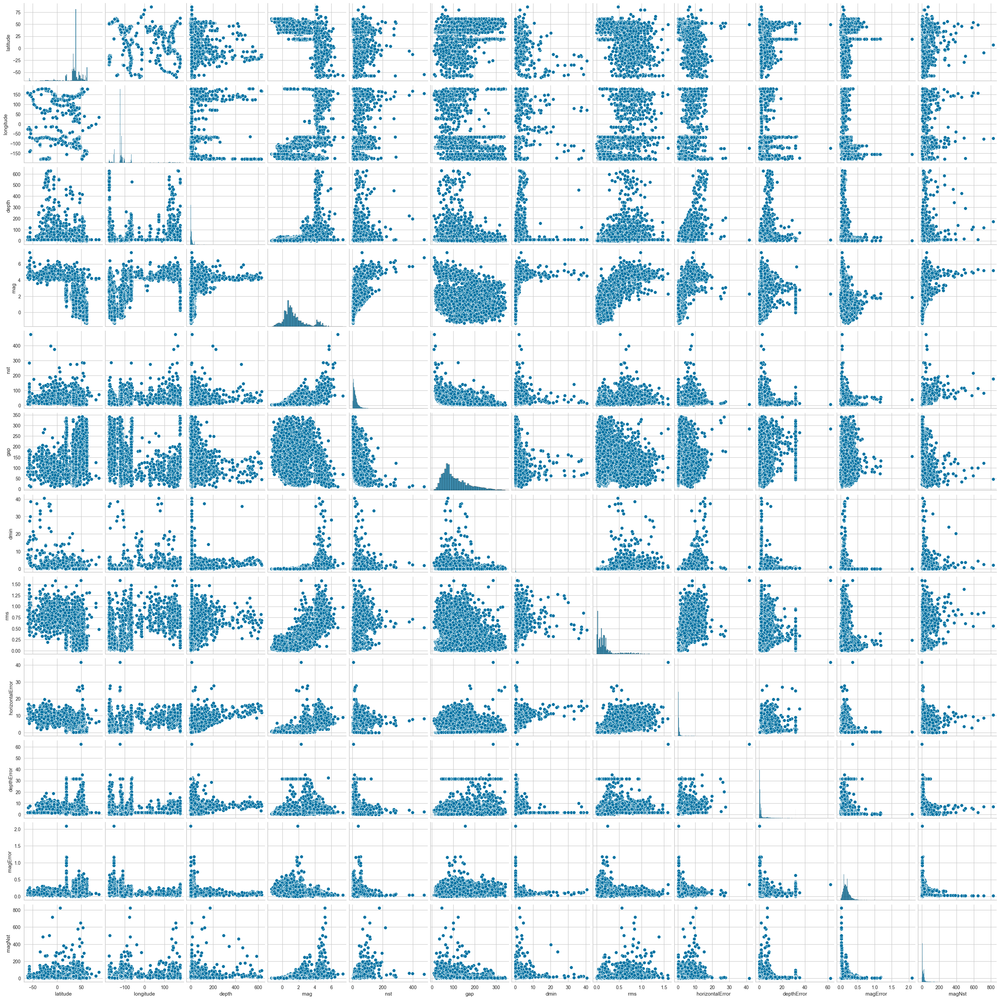

In [1517]:
sns.pairplot(data=df, palette="viridis")

We uses paiplot to check the distribution of the residuals. The residuals are normally distributed, which is a good sign.

In [1518]:
df['place'].unique()

array(['7 km NW of The Geysers, CA', '7 km NNW of Cabazon, CA',
       '3 km SW of Ridgemark, CA', ..., '38 km SSW of La Tirana, Chile',
       '7 km WNW of Templeton, CA', '11 km NE of Rosarito, B.C., MX'],
      dtype=object)

Since place is the object we check for its unique values.It represent the place where the earthquake occured.

In [1519]:
df['status'].unique()

array(['automatic', 'reviewed'], dtype=object)

Status is the object we check for its unique values.It represent the status of the disaster.

In [1520]:
df['locationSource'].unique()

array(['nc', 'ci', 'us', 'uw', 'av', 'mb', 'hv', 'pr', 'uu', 'tx', 'nm',
       'se'], dtype=object)

locationSource is the object so we check for its unique values.It represent the source of the location.

In [1521]:
df['magType'].unique()

array(['md', 'ml', 'mb', 'mww', 'mb_lg', 'mwr', 'mlv'], dtype=object)

Since magType is the object we check for its unique values.It represent the type of magnitude of the earthquake occured.

In [1522]:
df['net'].unique()

array(['nc', 'ci', 'us', 'uw', 'av', 'mb', 'hv', 'pr', 'uu', 'tx', 'nm',
       'se'], dtype=object)

Since net is the object we check for its unique values.It represent the the network that provides the data.

In [1523]:
df['type'].unique()

array(['earthquake', 'explosion', 'quarry blast'], dtype=object)

Since type is the object we check for its unique values.It represent the type of natural disaster occured or  to be occured.

In [1524]:
df['magSource'].unique()

array(['nc', 'ci', 'us', 'uw', 'av', 'mb', 'hv', 'pr', 'uu', 'tx', 'nm',
       'se'], dtype=object)

Since magSource is the object we check for its unique values.It represent the source of the magnitiude.

In [1525]:
df.head()

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,38.810665,-122.822334,3.03,0.31,md,9.0,75.0,0.00564,0.02,nc,"7 km NW of The Geysers, CA",earthquake,0.50,1.730,0.120,9.0,automatic,nc,nc
1,33.971333,-116.824000,16.24,0.78,ml,23.0,54.0,0.06507,0.18,ci,"7 km NNW of Cabazon, CA",earthquake,0.33,0.710,0.173,17.0,automatic,ci,ci
2,36.791832,-121.391335,5.27,1.22,md,8.0,123.0,0.05276,0.04,nc,"3 km SW of Ridgemark, CA",earthquake,0.37,1.050,0.120,7.0,automatic,nc,nc
4,-57.115000,-67.591500,10.00,4.50,mb,25.0,146.0,3.19200,0.66,us,"260 km S of Ushuaia, Argentina",earthquake,13.66,1.946,0.124,19.0,reviewed,us,us
5,61.296900,-146.529700,10.00,2.50,ml,33.0,52.0,0.35200,1.30,us,"20 km NNW of Valdez, Alaska",earthquake,1.41,1.961,0.042,74.0,reviewed,us,us


In [1526]:
#l1=LabelEncoder()
#df["place"]=l1.fit_transform(df["place"])
#df["status"]=l1.fit_transform(df["status"])

In [1527]:
#df['time'] = pd.to_datetime(df['time'], errors='coerce')

In [1528]:
#df['date_only'] = df['time'].dt.date   # Extracts only the date part (YYYY-MM-DD)
#df['time_only'] = df['time'].dt.time

In [1529]:
#print(df[['time', 'date_only', 'time_only']].head())

In [1530]:
df

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,38.810665,-122.822334,3.03,0.31,md,9.0,75.0,0.005640,0.02,nc,"7 km NW of The Geysers, CA",earthquake,0.50,1.730,0.120,9.0,automatic,nc,nc
1,33.971333,-116.824000,16.24,0.78,ml,23.0,54.0,0.065070,0.18,ci,"7 km NNW of Cabazon, CA",earthquake,0.33,0.710,0.173,17.0,automatic,ci,ci
2,36.791832,-121.391335,5.27,1.22,md,8.0,123.0,0.052760,0.04,nc,"3 km SW of Ridgemark, CA",earthquake,0.37,1.050,0.120,7.0,automatic,nc,nc
4,-57.115000,-67.591500,10.00,4.50,mb,25.0,146.0,3.192000,0.66,us,"260 km S of Ushuaia, Argentina",earthquake,13.66,1.946,0.124,19.0,reviewed,us,us
5,61.296900,-146.529700,10.00,2.50,ml,33.0,52.0,0.352000,1.30,us,"20 km NNW of Valdez, Alaska",earthquake,1.41,1.961,0.042,74.0,reviewed,us,us
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9315,32.395667,-116.947000,8.48,1.59,ml,18.0,167.0,0.211900,0.13,ci,"11 km NE of Rosarito, B.C., MX",earthquake,0.55,1.460,0.175,19.0,reviewed,ci,ci
9316,38.812000,-122.737663,0.56,1.06,md,12.0,130.0,0.028730,0.04,nc,"2 km WSW of Cobb, CA",earthquake,0.28,0.840,0.210,13.0,automatic,nc,nc
9317,38.791168,-122.780167,2.87,1.40,md,26.0,92.0,0.006382,0.02,nc,"3 km NW of The Geysers, CA",earthquake,0.27,0.510,0.130,30.0,automatic,nc,nc
9318,33.044333,-116.595833,14.63,0.99,ml,36.0,39.0,0.086600,0.17,ci,"4 km S of Julian, CA",earthquake,0.25,0.430,0.228,23.0,reviewed,ci,ci


In [1531]:
df.columns

Index(['latitude', 'longitude', 'depth', 'mag', 'magType', 'nst', 'gap',
       'dmin', 'rms', 'net', 'place', 'type', 'horizontalError', 'depthError',
       'magError', 'magNst', 'status', 'locationSource', 'magSource'],
      dtype='object')

In [1532]:
#df['updated'] = pd.to_datetime(df['updated'], errors='coerce')

In [1533]:
#df['date'] = df['updated'].dt.date   # Extracts only the date part (YYYY-MM-DD)
#df['time1'] = df['updated'].dt.time

In [1534]:
#print(df[['updated', 'date', 'time1']].head())

In [1535]:
df.dtypes

latitude           float64
longitude          float64
depth              float64
mag                float64
magType             object
nst                float64
gap                float64
dmin               float64
rms                float64
net                 object
place               object
type                object
horizontalError    float64
depthError         float64
magError           float64
magNst             float64
status              object
locationSource      object
magSource           object
dtype: object

We are the checking the datatypes of the columns in the dataset. So we can seperate the numeric and categorical columns.And we also convert the categorical columns into numerical columns.

In [1536]:
for ifc in df.select_dtypes(include='float64').columns:
    if(df[ifc].skew()>0.5):
        print(ifc,'skewed')
        df[ifc]=df[ifc].fillna(df[ifc].median())
    else:
        print(ifc,'Normal')
        df[ifc]=df[ifc].fillna(df[ifc].mean()) 

latitude Normal
longitude skewed
depth skewed
mag skewed
nst skewed
gap skewed
dmin skewed
rms skewed
horizontalError skewed
depthError skewed
magError skewed
magNst skewed


We are checking for the skewness for numeric columns only.Skewness is a measure of the asymmetry of the distribution of values in a dataset.

latitude


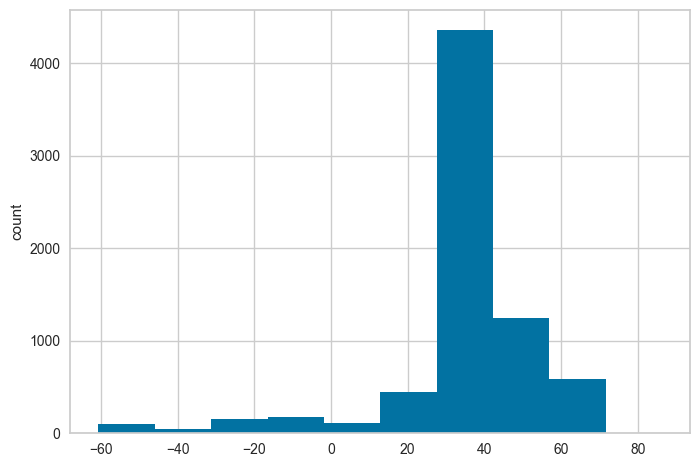

longitude


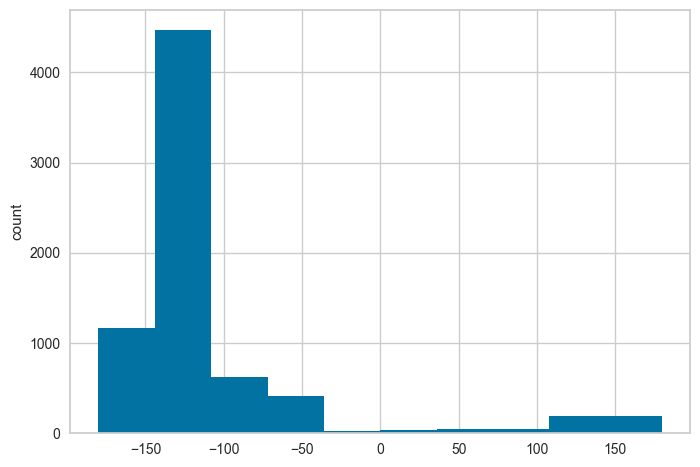

depth


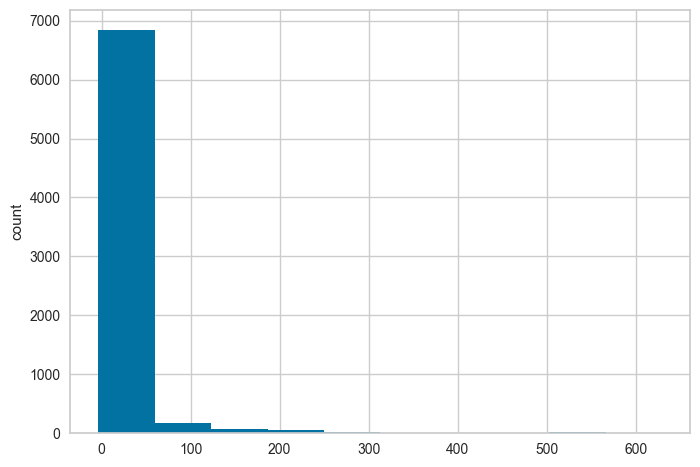

mag


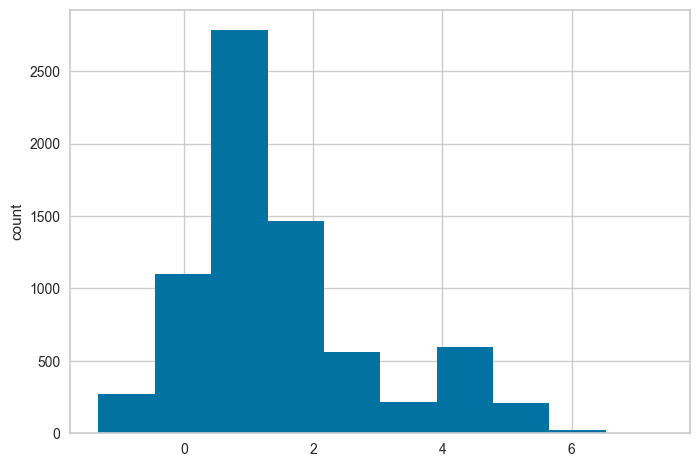

nst


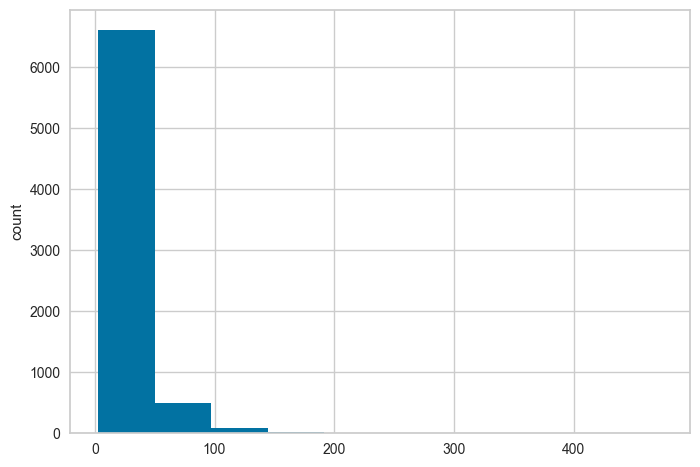

gap


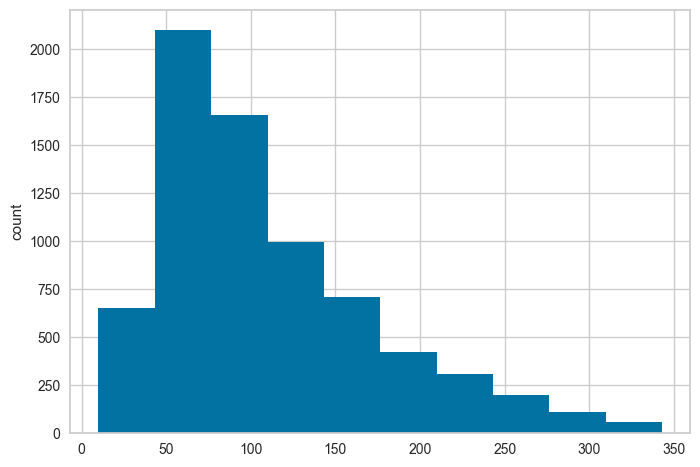

dmin


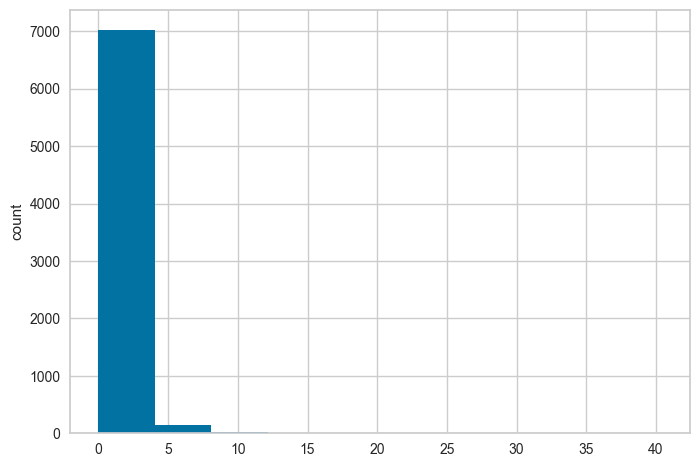

rms


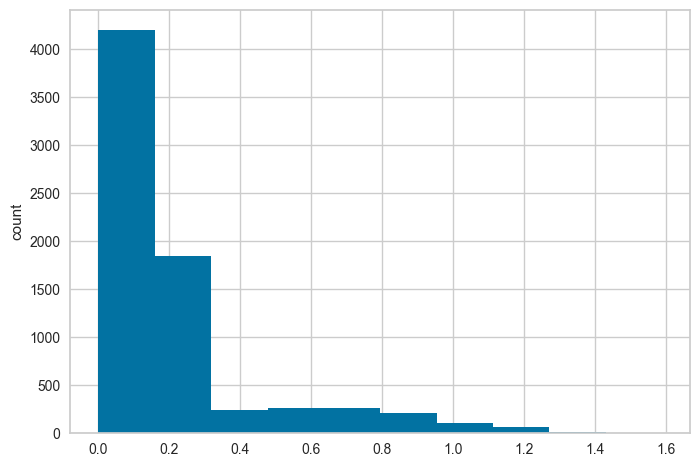

horizontalError


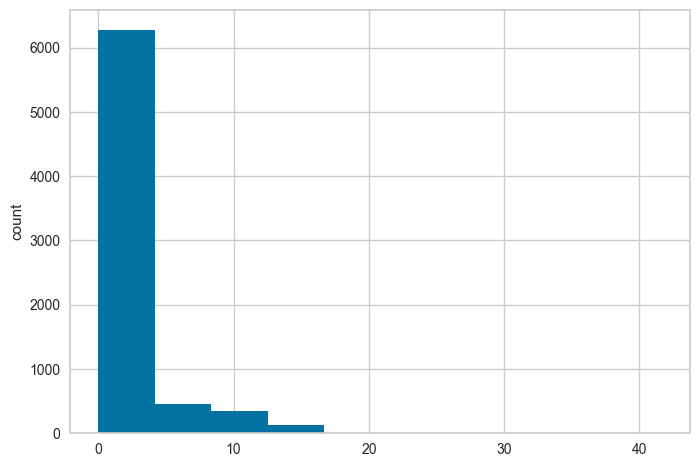

depthError


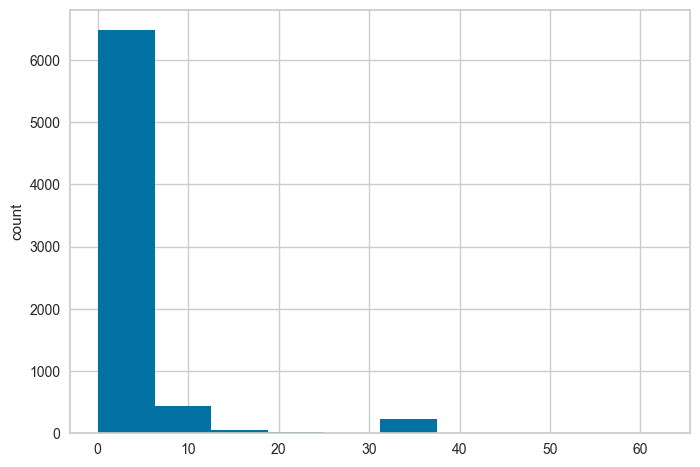

magError


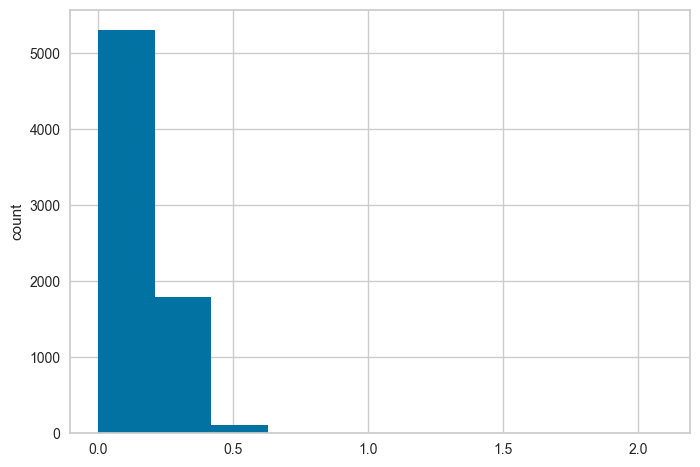

magNst


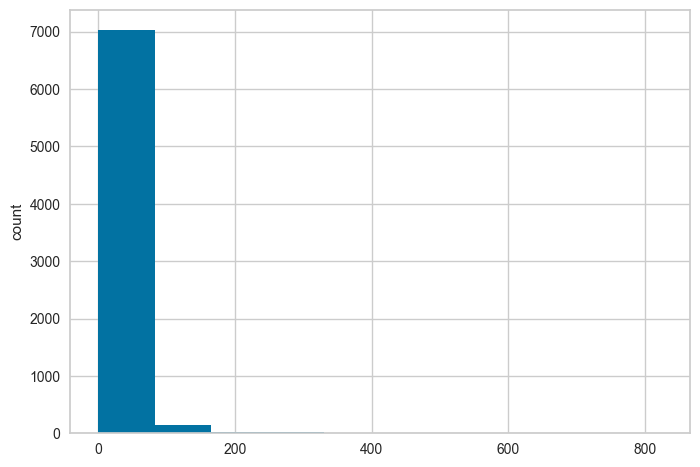

In [1537]:
for i in df.select_dtypes(include='float64').columns:
    plt.hist(df[i])
    print(i)
    plt.ylabel("count")
    plt.show()

It shows the visulazation of histogram of each columns. We are finding it for numeric value only.Its is the basically the frequency distribution of range.

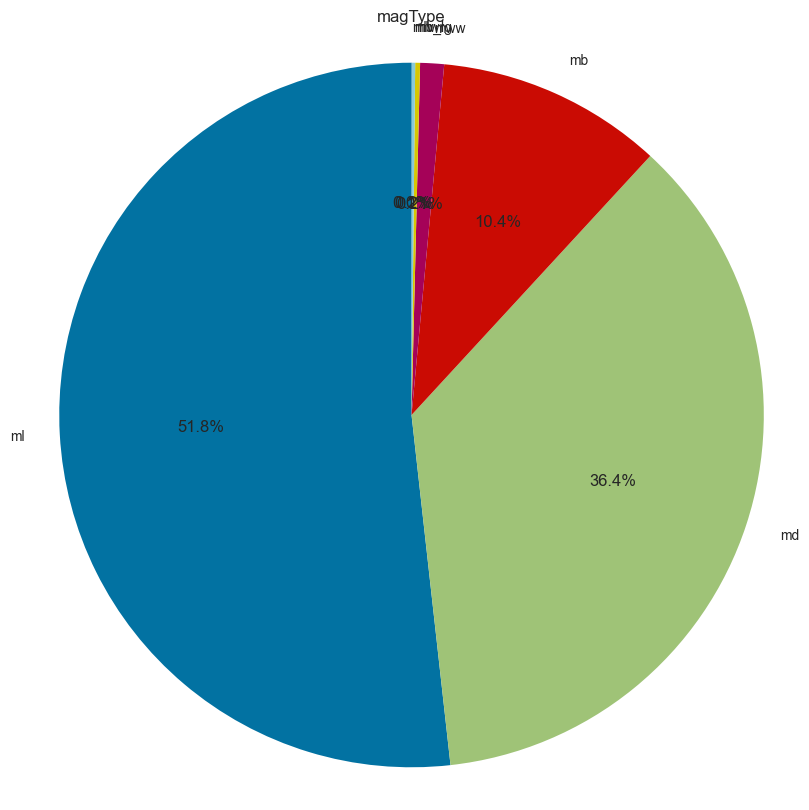

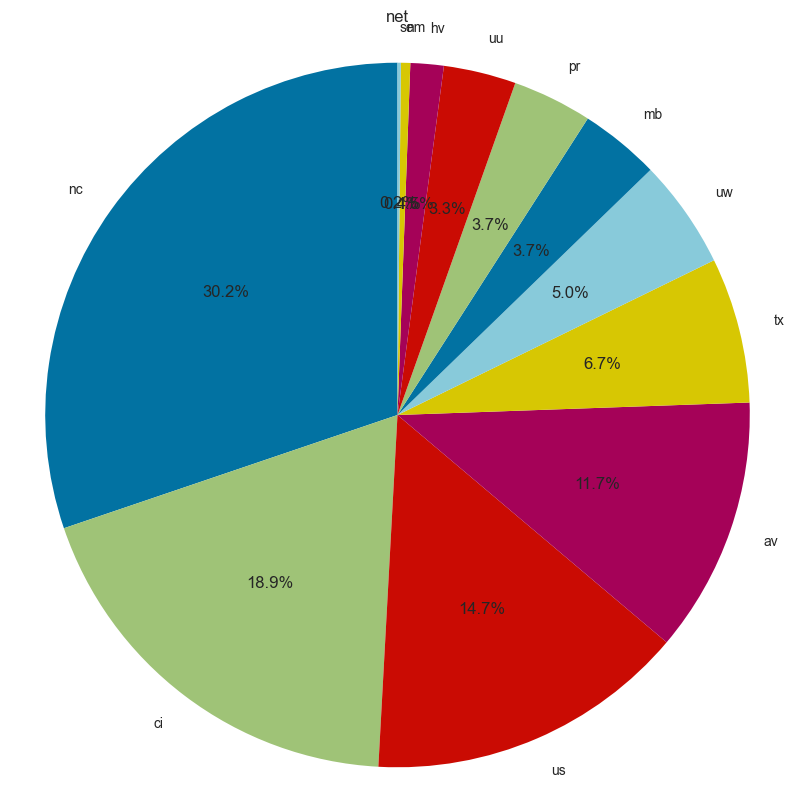

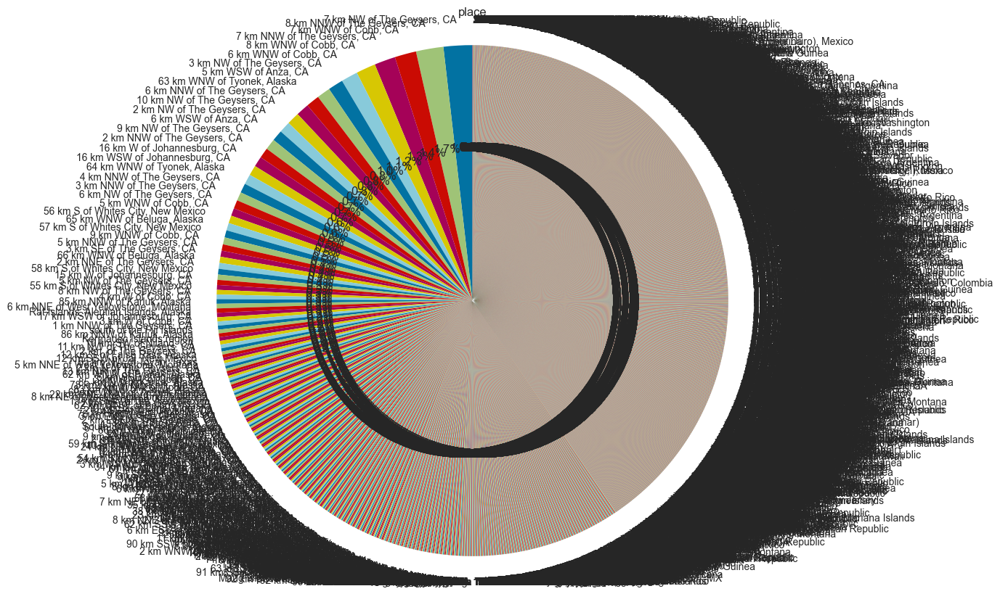

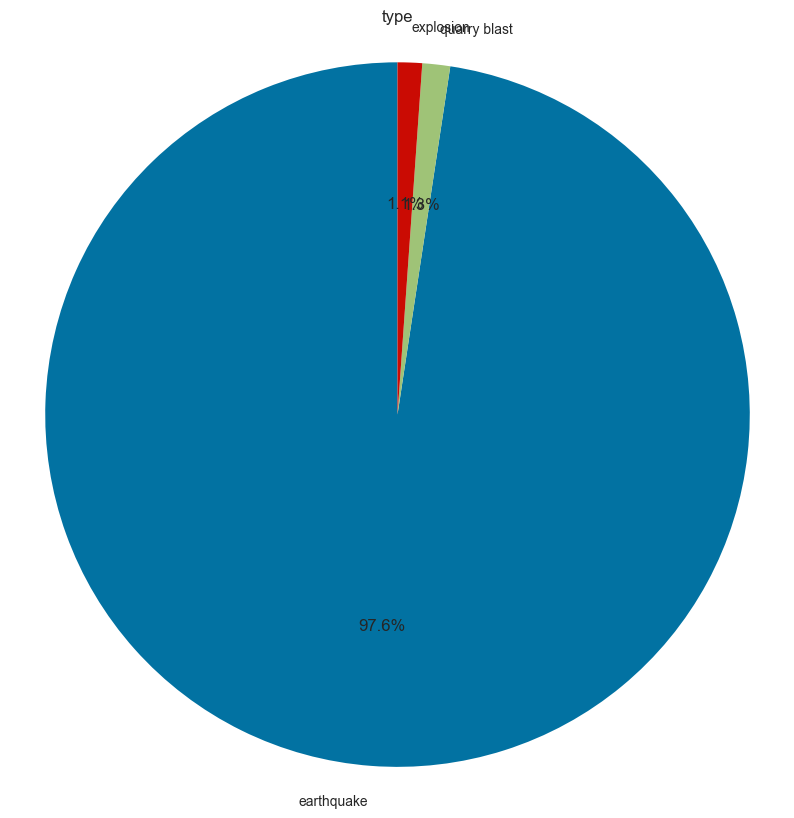

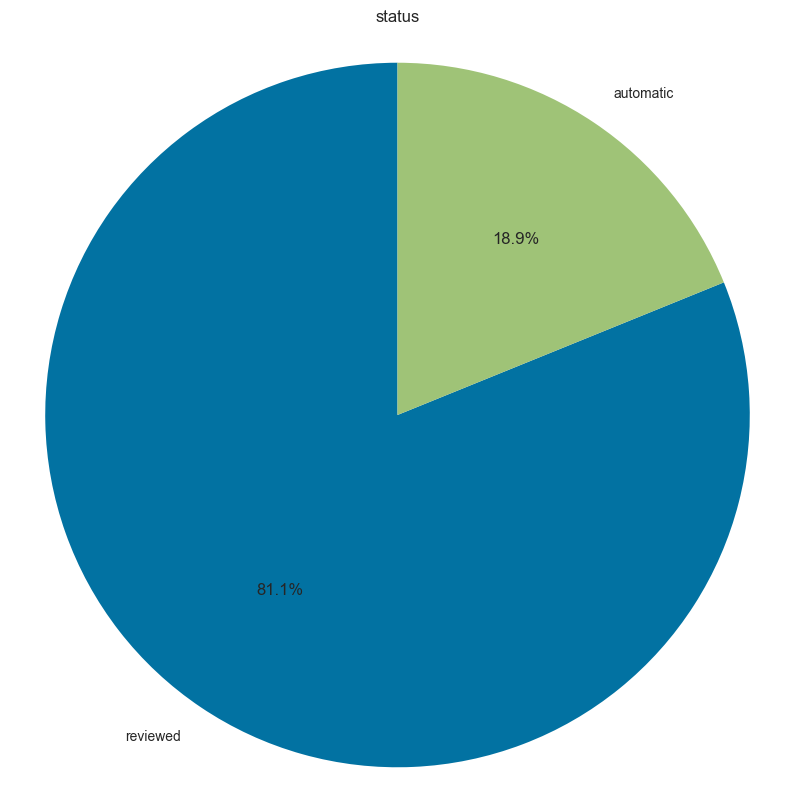

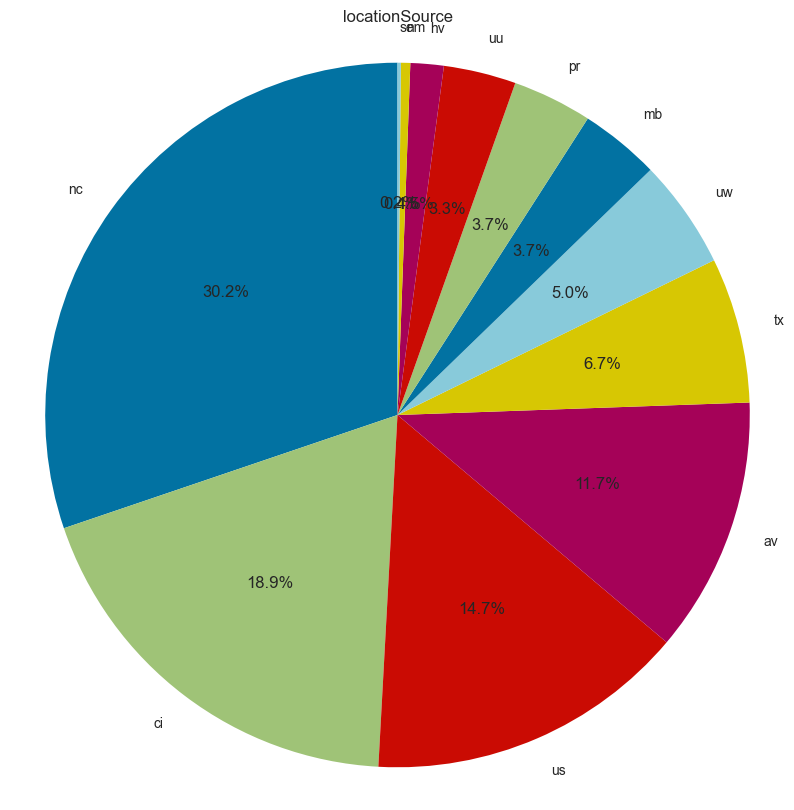

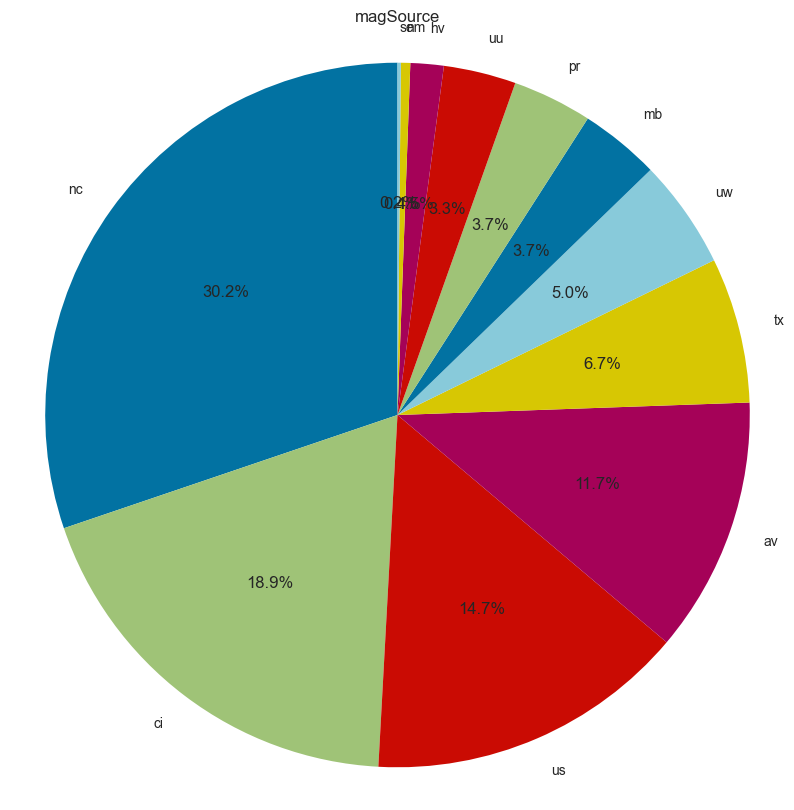

In [1538]:
for i in df.select_dtypes(include='object_'):
    plt.figure(figsize=(10, 10))
    cnt=df[i].value_counts()
    plt.title(i)
    plt.pie(cnt, labels=cnt.index, autopct='%1.1f%%', startangle=90)
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

It shows the visulazation of pie chart of each columns. We are finding it for categorical value only.Its is the basically the frequency distribution of range.

In [1539]:
#df['time'].value_counts()

In [1540]:
#df['updated'].value_counts()

In [1541]:
df

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,38.810665,-122.822334,3.03,0.31,md,9.0,75.0,0.005640,0.02,nc,"7 km NW of The Geysers, CA",earthquake,0.50,1.730,0.120,9.0,automatic,nc,nc
1,33.971333,-116.824000,16.24,0.78,ml,23.0,54.0,0.065070,0.18,ci,"7 km NNW of Cabazon, CA",earthquake,0.33,0.710,0.173,17.0,automatic,ci,ci
2,36.791832,-121.391335,5.27,1.22,md,8.0,123.0,0.052760,0.04,nc,"3 km SW of Ridgemark, CA",earthquake,0.37,1.050,0.120,7.0,automatic,nc,nc
4,-57.115000,-67.591500,10.00,4.50,mb,25.0,146.0,3.192000,0.66,us,"260 km S of Ushuaia, Argentina",earthquake,13.66,1.946,0.124,19.0,reviewed,us,us
5,61.296900,-146.529700,10.00,2.50,ml,33.0,52.0,0.352000,1.30,us,"20 km NNW of Valdez, Alaska",earthquake,1.41,1.961,0.042,74.0,reviewed,us,us
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9315,32.395667,-116.947000,8.48,1.59,ml,18.0,167.0,0.211900,0.13,ci,"11 km NE of Rosarito, B.C., MX",earthquake,0.55,1.460,0.175,19.0,reviewed,ci,ci
9316,38.812000,-122.737663,0.56,1.06,md,12.0,130.0,0.028730,0.04,nc,"2 km WSW of Cobb, CA",earthquake,0.28,0.840,0.210,13.0,automatic,nc,nc
9317,38.791168,-122.780167,2.87,1.40,md,26.0,92.0,0.006382,0.02,nc,"3 km NW of The Geysers, CA",earthquake,0.27,0.510,0.130,30.0,automatic,nc,nc
9318,33.044333,-116.595833,14.63,0.99,ml,36.0,39.0,0.086600,0.17,ci,"4 km S of Julian, CA",earthquake,0.25,0.430,0.228,23.0,reviewed,ci,ci


In [1542]:
df.dtypes

latitude           float64
longitude          float64
depth              float64
mag                float64
magType             object
nst                float64
gap                float64
dmin               float64
rms                float64
net                 object
place               object
type                object
horizontalError    float64
depthError         float64
magError           float64
magNst             float64
status              object
locationSource      object
magSource           object
dtype: object

In [1543]:
df['type'].value_counts()

type
earthquake      7050
quarry blast      92
explosion         81
Name: count, dtype: int64

The number of occurrences of each unique value.The distribution of event types (like 'earthquake', 'quarry blast', etc.) in the dataset

In [1544]:
df['place'].value_counts()

place
7 km NW of The Geysers, CA                   131
8 km NNW of The Geysers, CA                  125
7 km WNW of Cobb, CA                          98
7 km NNW of The Geysers, CA                   96
8 km WNW of Cobb, CA                          89
                                            ... 
92 km NE of Cruz Bay, U.S. Virgin Islands      1
98 km NNW of Karluk, Alaska                    1
33 km NNW of Shwebo, Burma (Myanmar)           1
218 km SSE of Ushuaia, Argentina               1
11 km NE of Rosarito, B.C., MX                 1
Name: count, Length: 3658, dtype: int64

The number of occurrences of each unique value.The place where the disaster occurs.

In [1545]:
df.dtypes

latitude           float64
longitude          float64
depth              float64
mag                float64
magType             object
nst                float64
gap                float64
dmin               float64
rms                float64
net                 object
place               object
type                object
horizontalError    float64
depthError         float64
magError           float64
magNst             float64
status              object
locationSource      object
magSource           object
dtype: object

<Axes: xlabel='count', ylabel='type'>

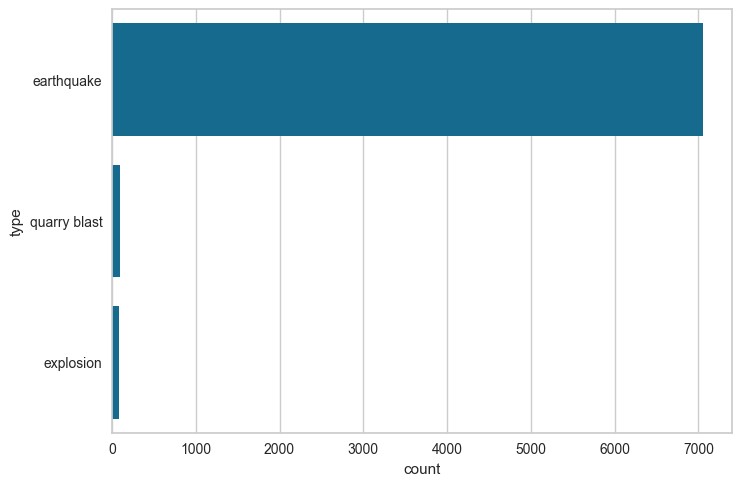

In [1546]:
sns.countplot(y='type', data=df, order=df['type'].value_counts().index)                  

It visualise the horizontal bar plot of each unique value in the type column.

<Axes: xlabel='count', ylabel='magType'>

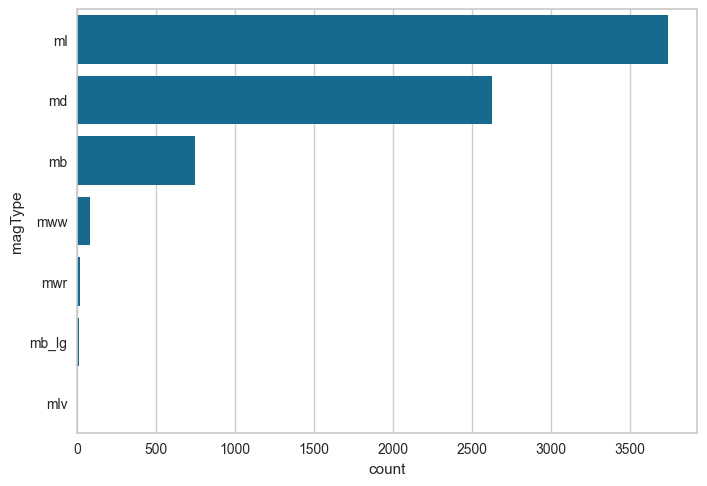

In [1547]:
sns.countplot(y='magType', data=df, order=df['magType'].value_counts().index)    

It visualise the horizontal bar plot of each unique value in the magType column.

<Axes: xlabel='count', ylabel='locationSource'>

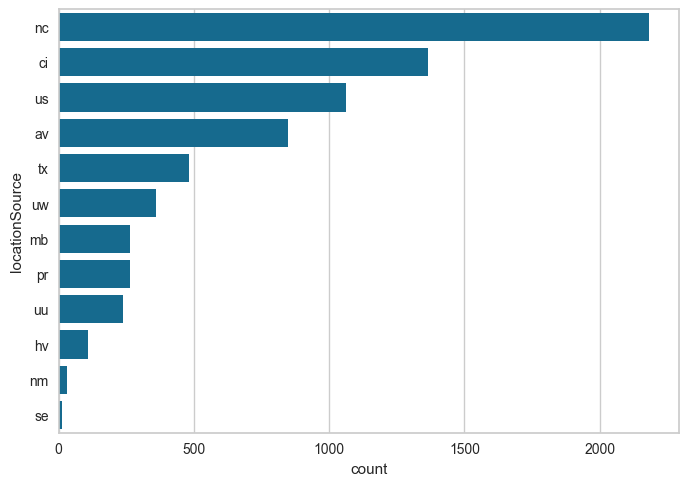

In [1548]:
sns.countplot(y='locationSource', data=df, order=df['locationSource'].value_counts().index)  

It visualise the horizontal bar plot of each unique value in the lacationSource column.

<Axes: xlabel='count', ylabel='magSource'>

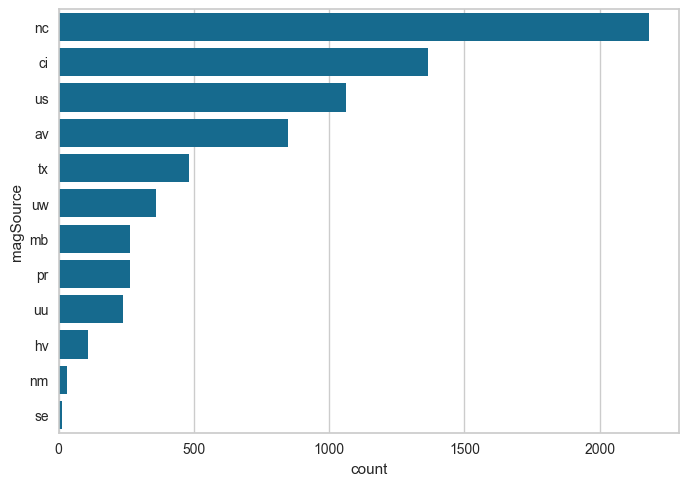

In [1549]:
sns.countplot(y='magSource', data=df, order=df['magSource'].value_counts().index)  

It visualise the horizontal bar plot of each unique value in the magSource column.

<Axes: xlabel='count', ylabel='net'>

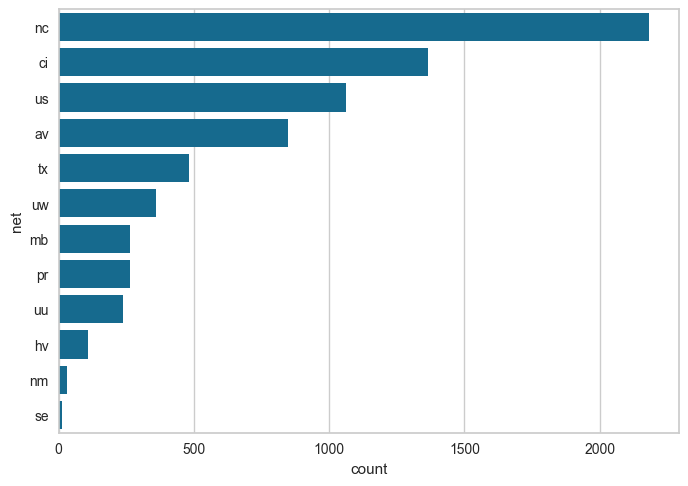

In [1550]:
sns.countplot(y='net', data=df, order=df['net'].value_counts().index)  

It visualise the horizontal bar plot of each unique value in the net column.

In [1551]:
#sns.countplot(y='id', data=df, order=df['id'].value_counts().index)  

In [1552]:
#sns.countplot(y='date_only', data=df, order=df['date_only'].value_counts().index)  

In [1553]:
#sns.countplot(y='time_only', data=df, order=df['time_only'].value_counts().index) 

In [1554]:
#sns.countplot(y='date', data=df, order=df['date'].value_counts().index) 

In [1555]:
#sns.countplot(y='time1', data=df, order=df['time1'].value_counts().index) 

Index(['latitude', 'longitude', 'depth', 'mag', 'nst', 'gap', 'dmin', 'rms',
       'horizontalError', 'depthError', 'magError', 'magNst'],
      dtype='object')


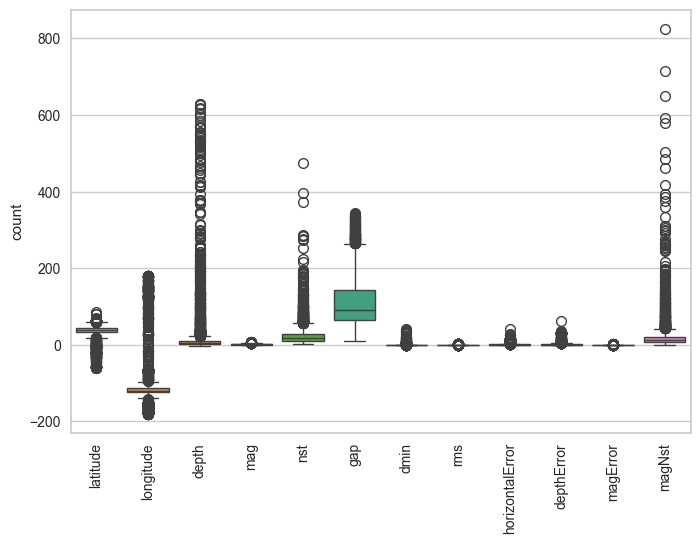

In [1556]:
ddd = df.select_dtypes(include=['float64','int32']).columns
print(ddd)
sns.boxplot(df[ddd])
plt.xticks(rotation='vertical')
plt.ylabel("count")
plt.show()

Here with the boxplot visualization we analyse the outliers in each columns.

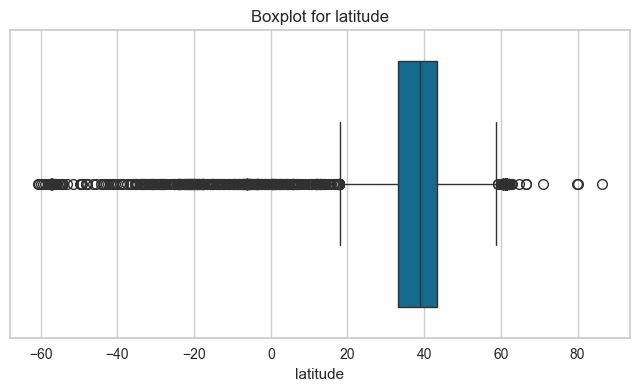

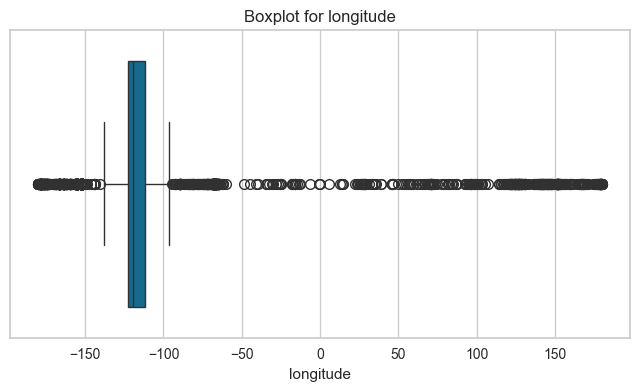

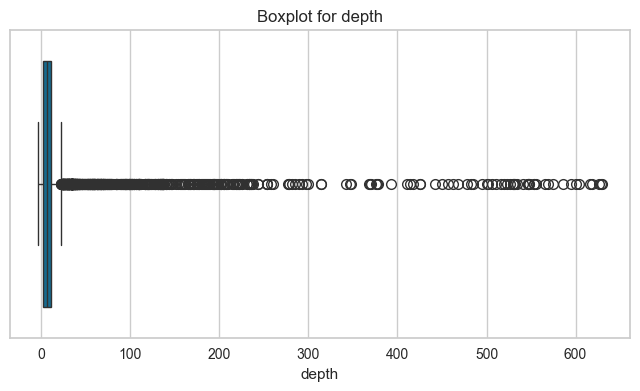

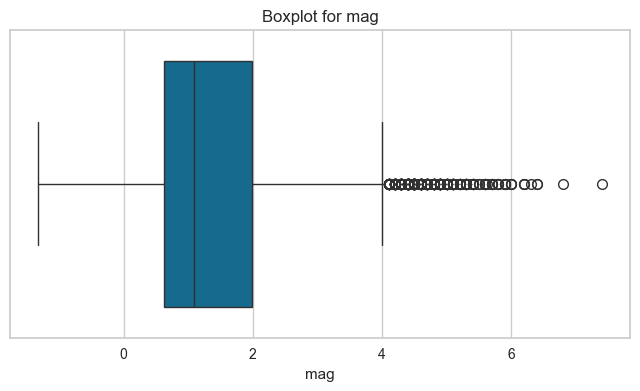

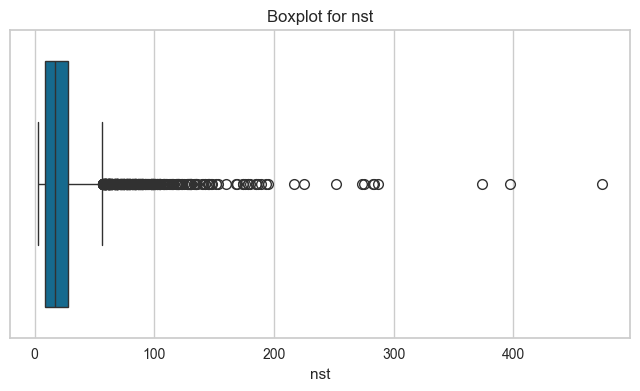

...

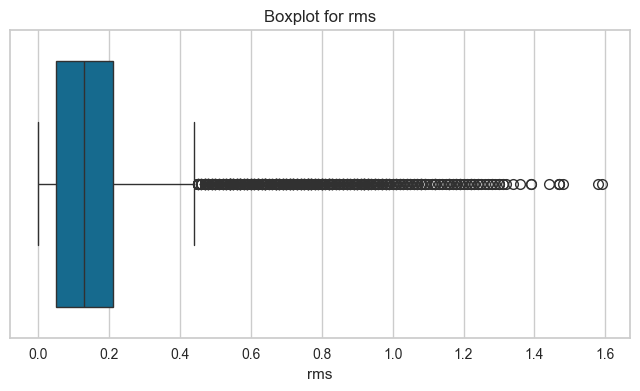

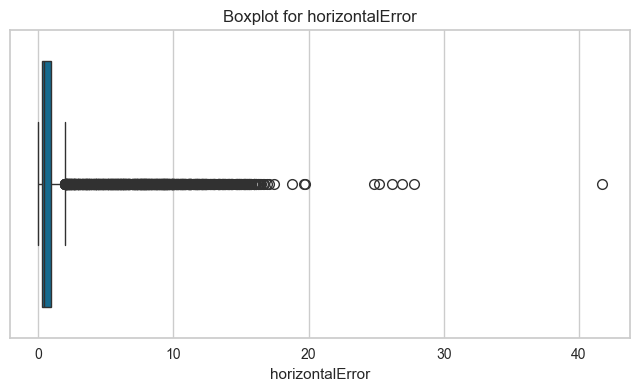

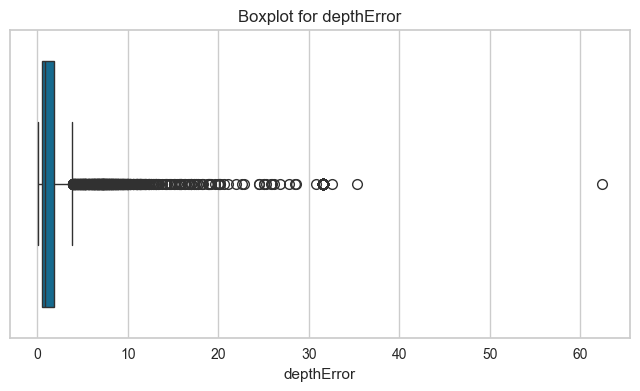

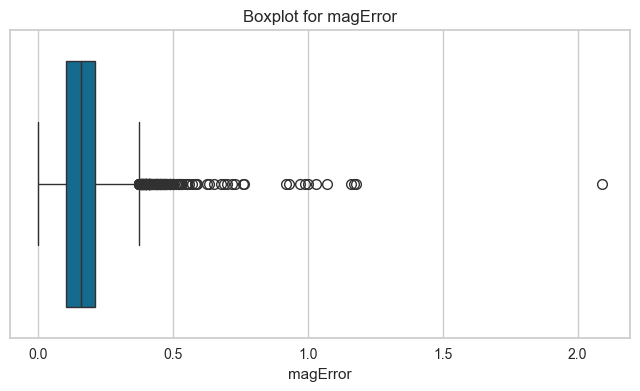

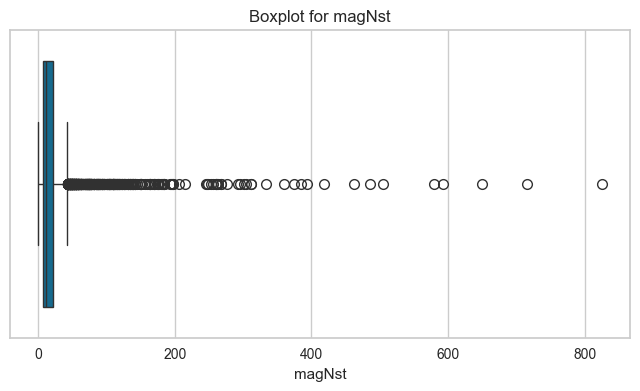

In [1557]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

Here with the boxplot visualization we analyse the outliers in each columns.Outliers affect the processing of the data,so we need to remove them before processing the data.

In [1558]:
out_list = ['latitude','longitude','depth','mag','nst','gap','dmin','rms','horizontalError','depthError','magError','magNst']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

Since every column in the dataset has outliers. First we remove the outliers from all the columns using the Interquartile Range (IQR) method.

In [1559]:
df.shape

(3113, 19)

We check the shape of the dataset after removing the outliers from every column.Before removing outliers the dataset has (7223.19) and after removing the outliers it has (3113,19).So the difference is(4110,19).

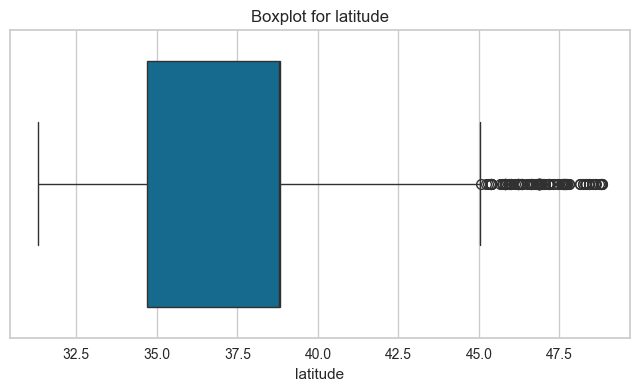

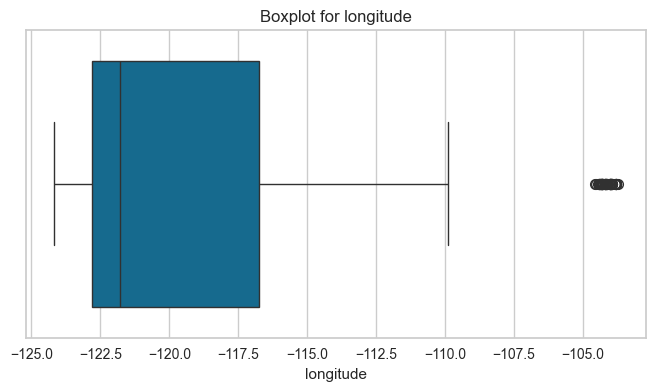

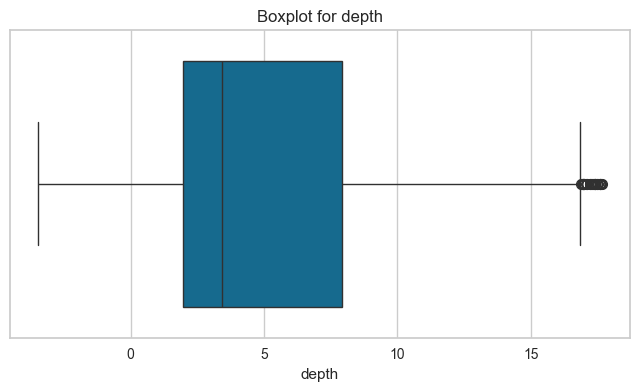

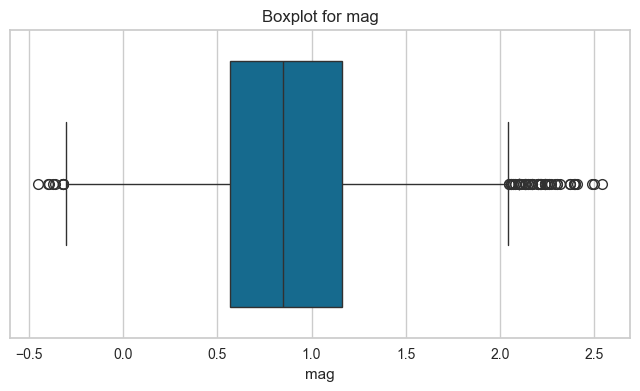

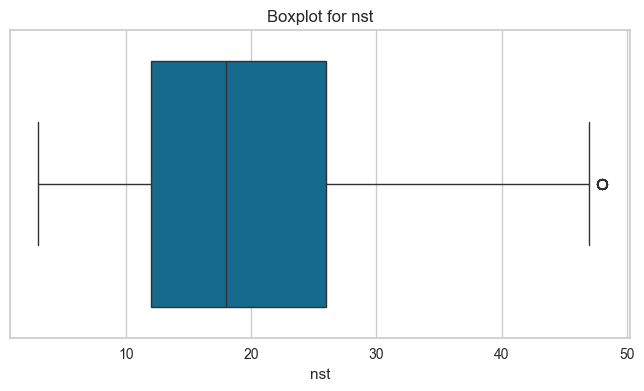

...

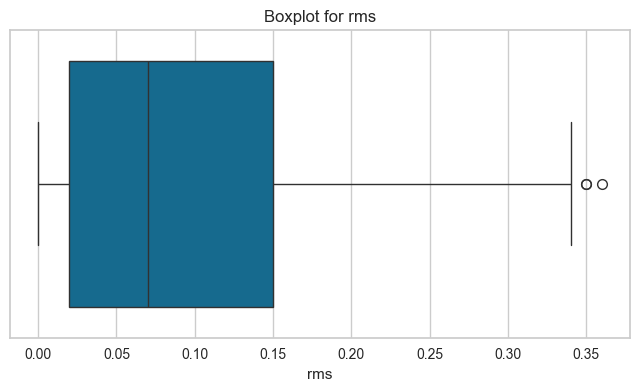

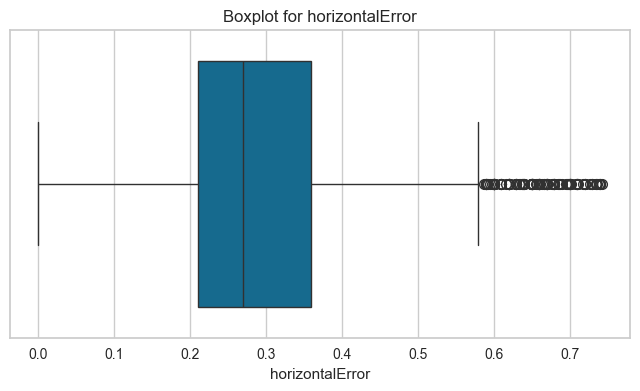

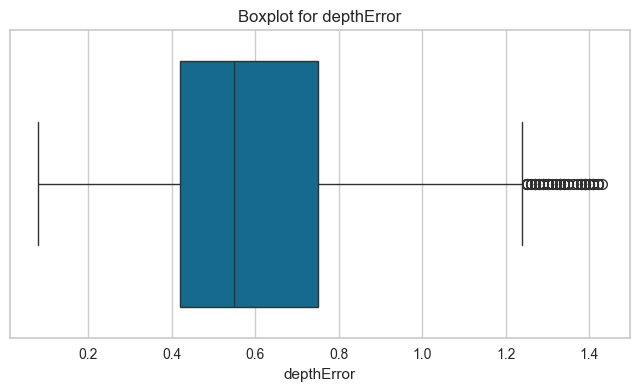

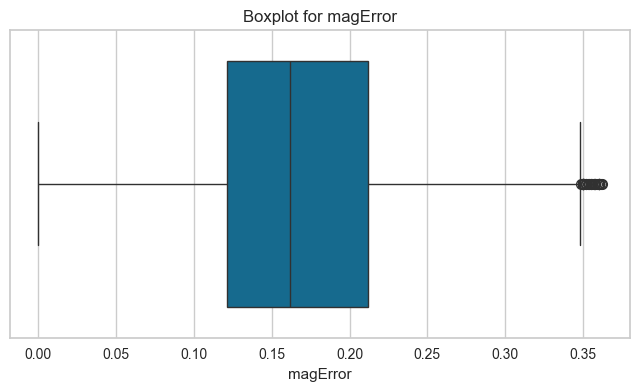

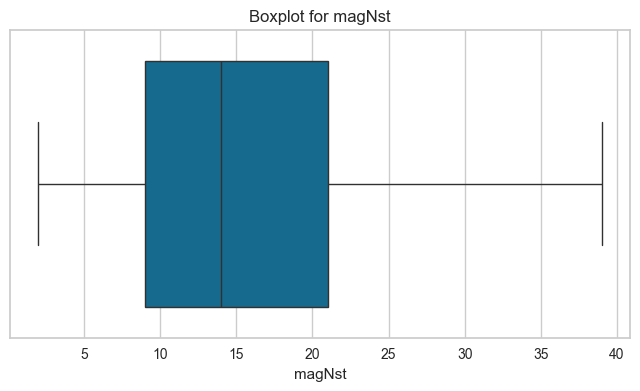

In [1560]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

We again check for the outliers in the data.It seems that there are outiers in ['latitude','longitude','depth','mag','nst','gap','dmin','rms','horizontalError','depthError','magError'].

In [1561]:
df.dtypes

latitude           float64
longitude          float64
depth              float64
mag                float64
magType             object
nst                float64
gap                float64
dmin               float64
rms                float64
net                 object
place               object
type                object
horizontalError    float64
depthError         float64
magError           float64
magNst             float64
status              object
locationSource      object
magSource           object
dtype: object

In [1562]:
out_list = ['latitude','longitude','depth','mag','nst','gap','dmin','rms','horizontalError','depthError','magError']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

We again apply Interquartile Range (IQR) method to eliminate the outliers from the data.We repeate this process until there are no outliers present in dataset.

In [1563]:
df.shape

(2375, 19)

Before we had (3113,19),now again removing the outiers we have (2375,19).So the difference is (738,19).

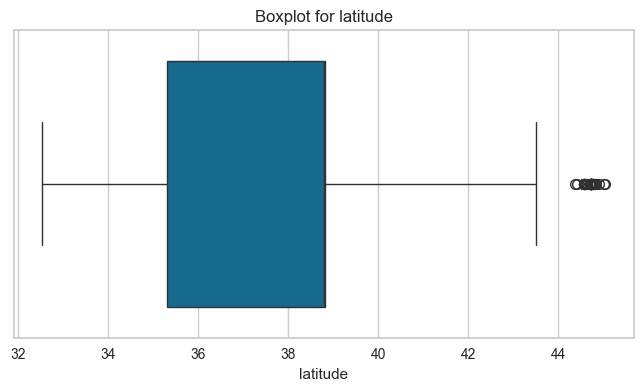

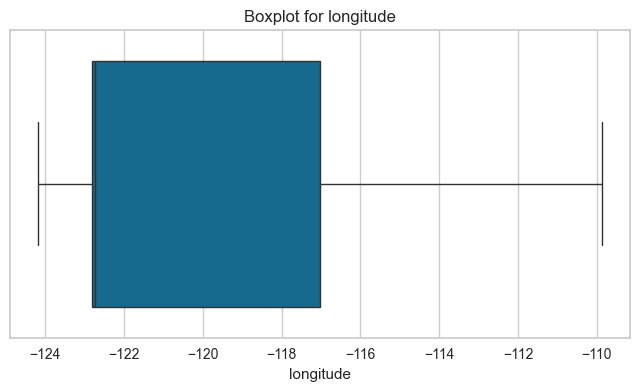

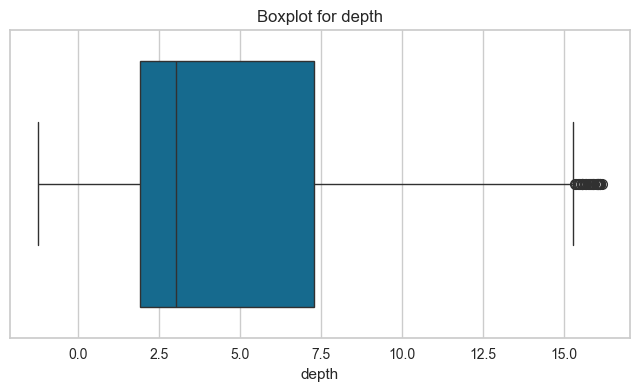

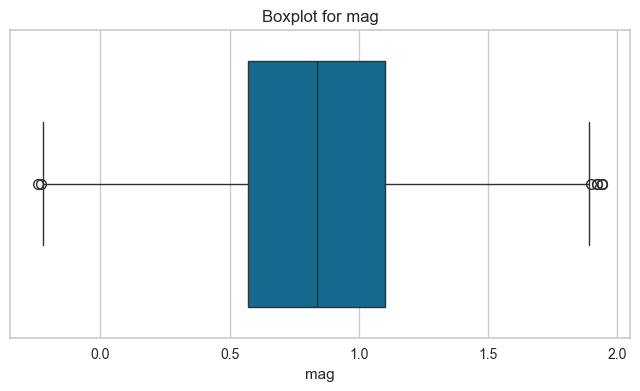

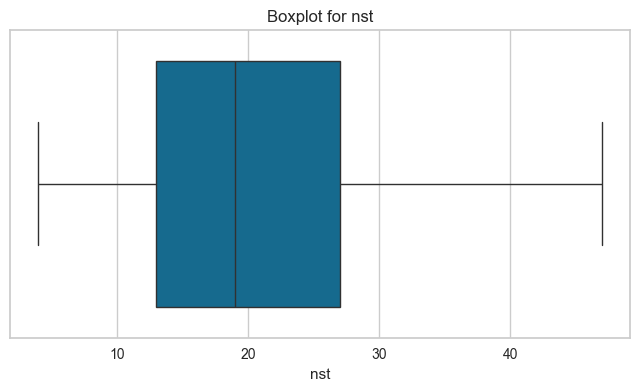

...

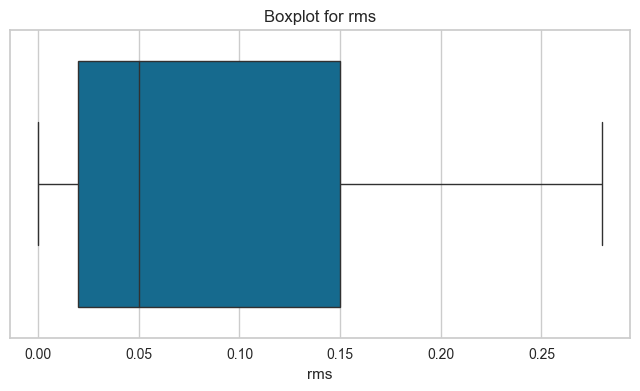

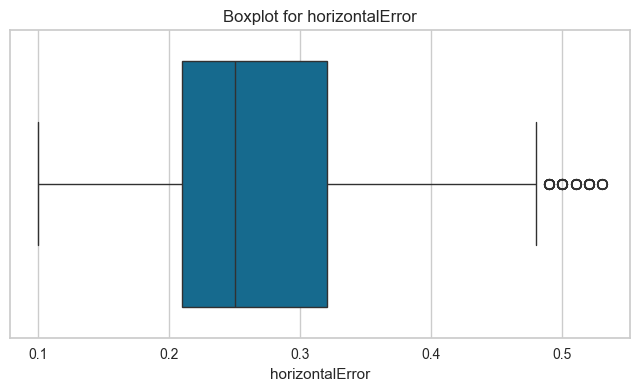

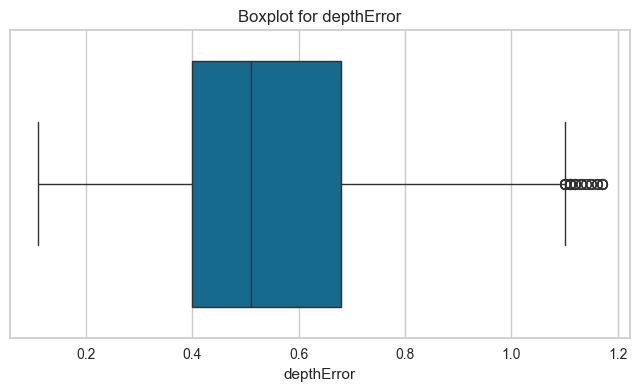

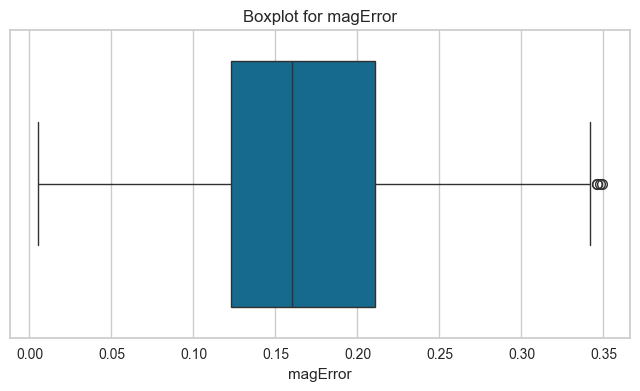

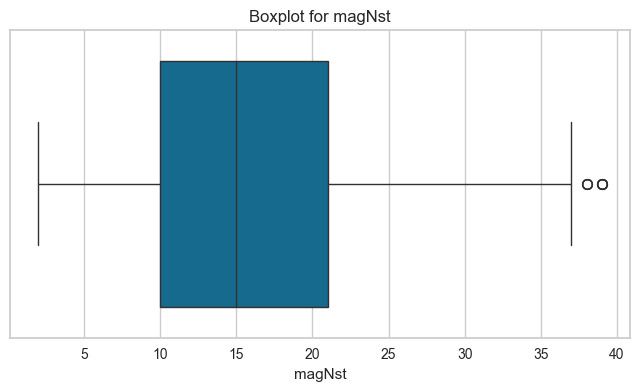

In [1564]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

It seems we have still outliers in ['latitude','depth','mag','gap','dmin','horizontalError','depthError','magError','magNst'].

In [1565]:
out_list = ['latitude','depth','mag','gap','dmin','horizontalError','depthError','magError','magNst']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1566]:
df.shape

(1950, 19)

Before we had (2975,19) and now we have (1950,19).The difference is (425,19).

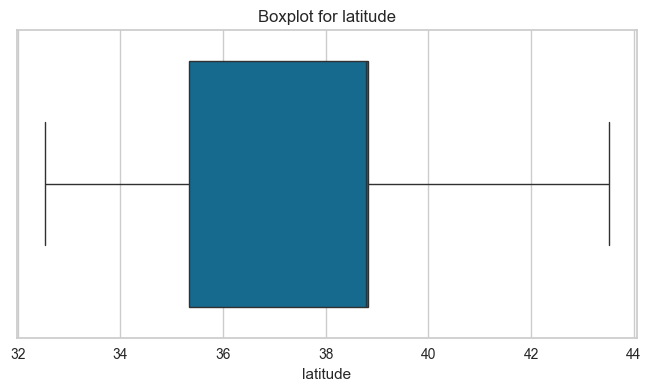

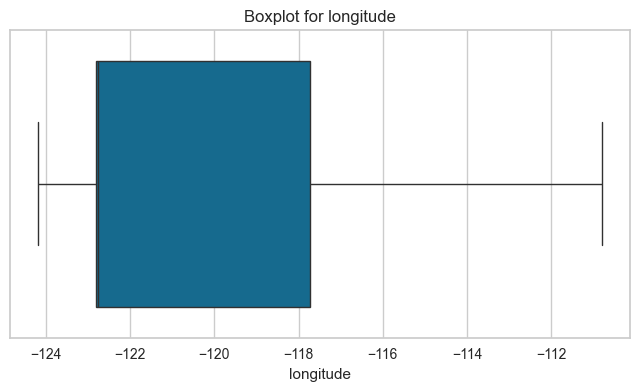

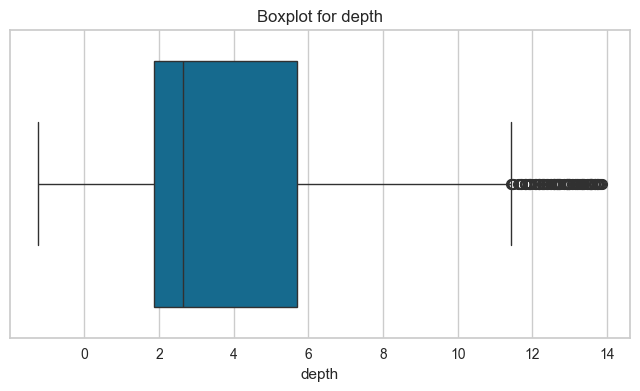

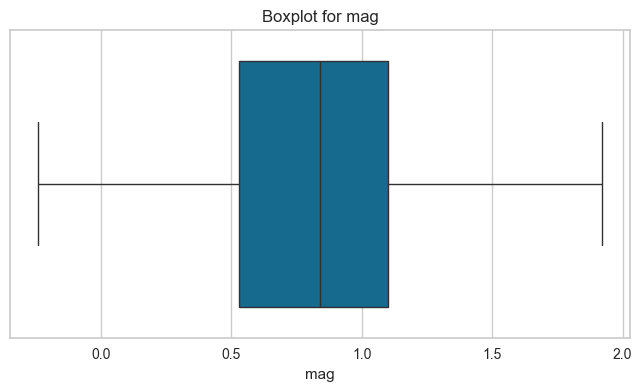

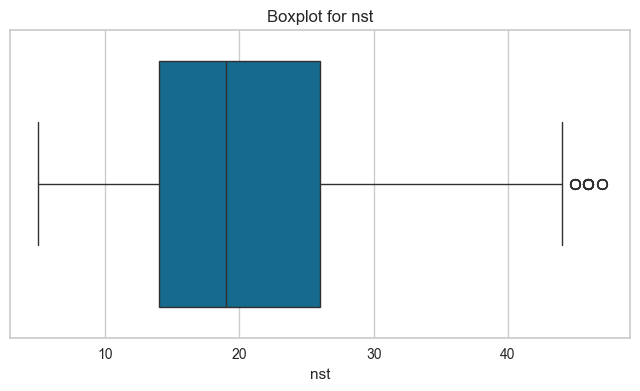

...

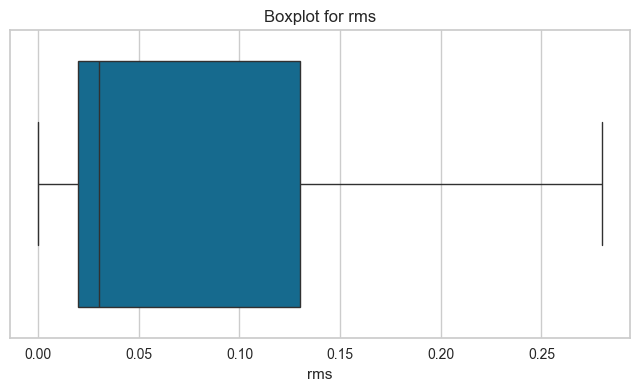

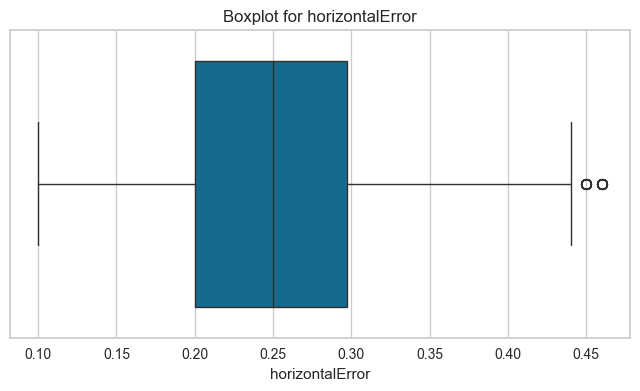

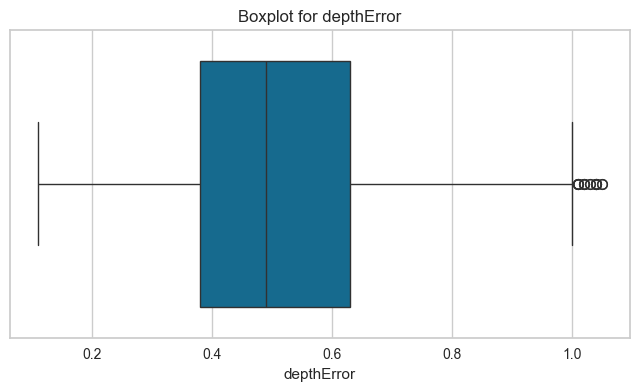

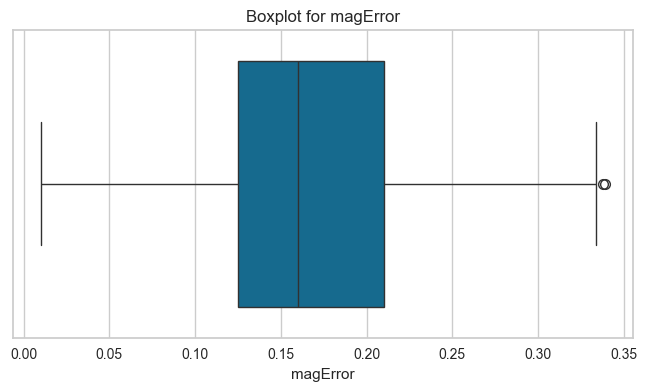

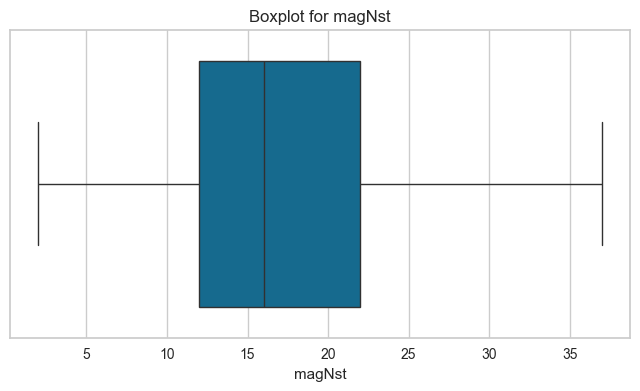

In [1567]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

We have outliers in ['depth','nst','gap','dmin','horizontalError','depthError','magError'].

In [1568]:
out_list = ['depth','nst','gap','dmin','horizontalError','depthError','magError']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1569]:
df.shape

(1648, 19)

Before it was (1950,19) and now we have (1648,19).The difference is (302,19).

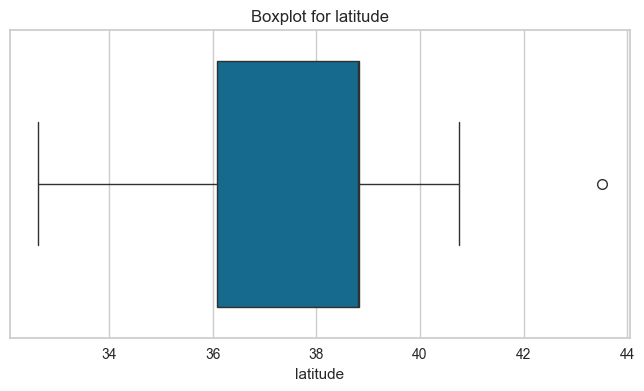

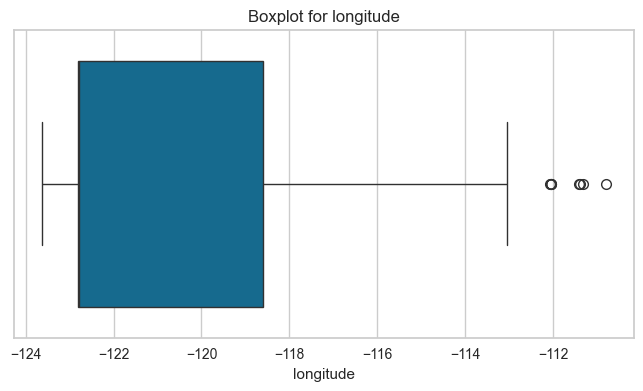

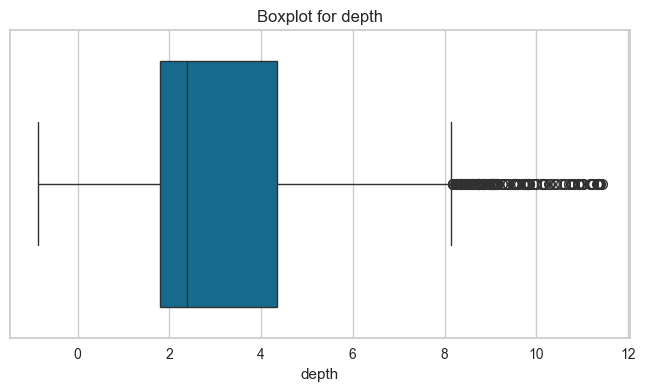

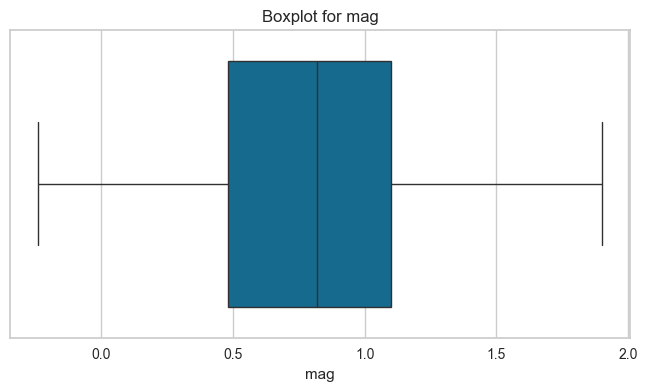

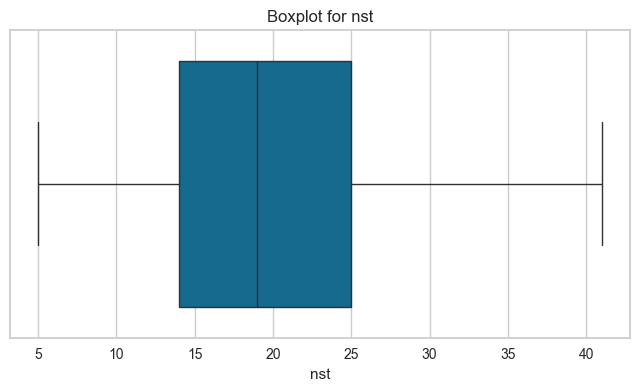

...

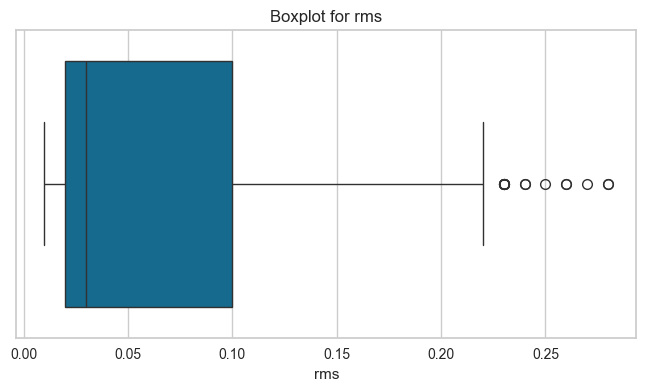

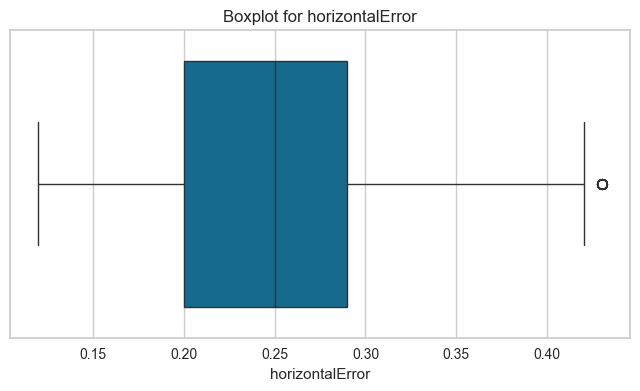

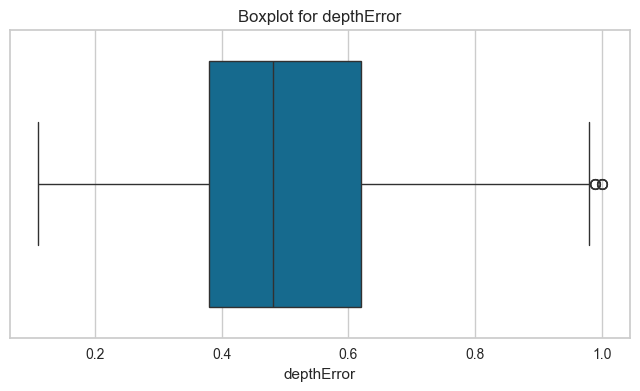

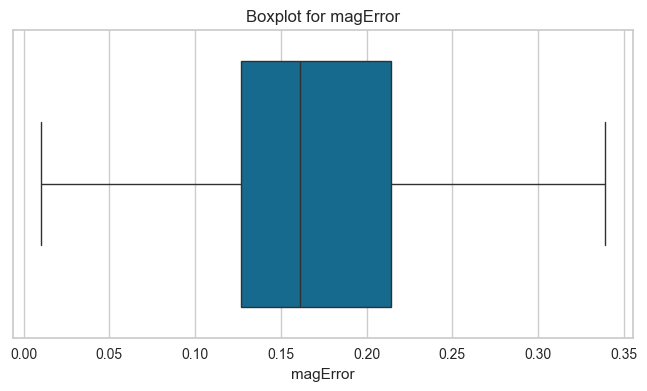

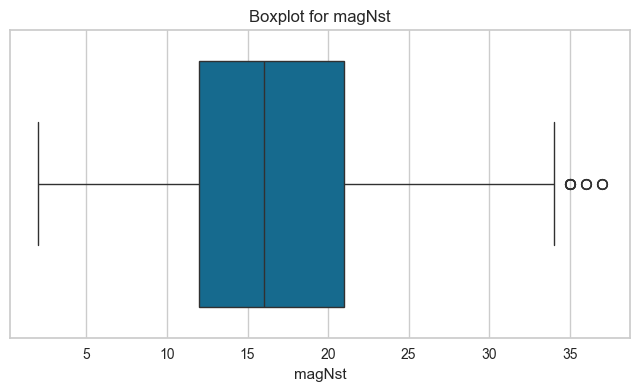

In [1570]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()


We have outliers in ['latitude','longitude','depth','gap','dmin','rms','horizontalError','depthError','magNst'].

In [1571]:
out_list = ['latitude','longitude','depth','gap','dmin','rms','horizontalError','depthError','magNst']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1572]:
df.shape

(1021, 19)

Before it was (1648,19) and now it is (1021,19). The difference is (627,19).

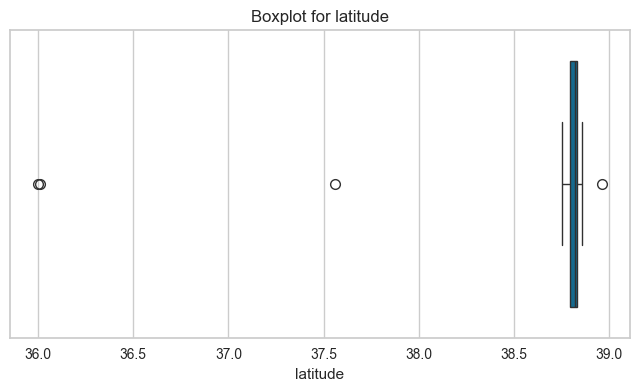

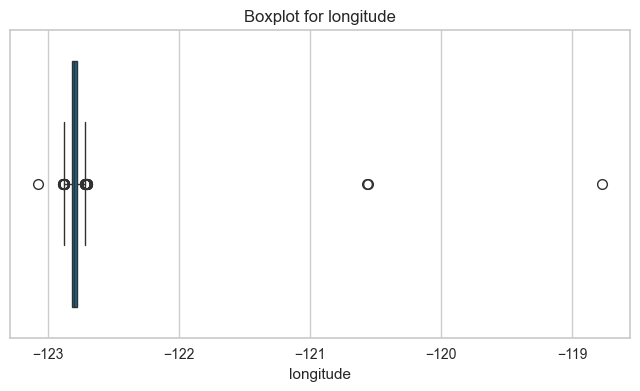

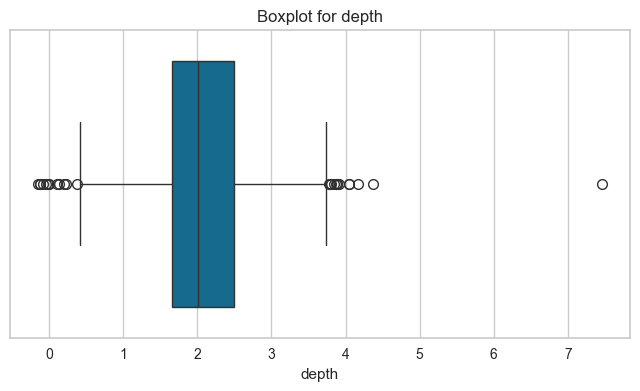

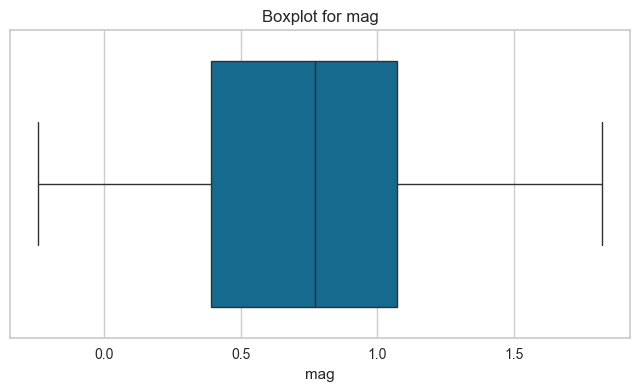

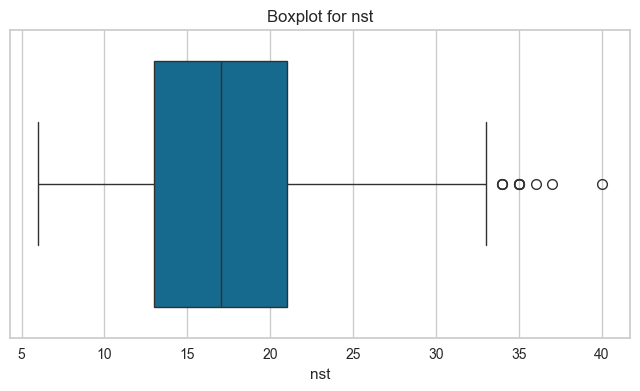

...

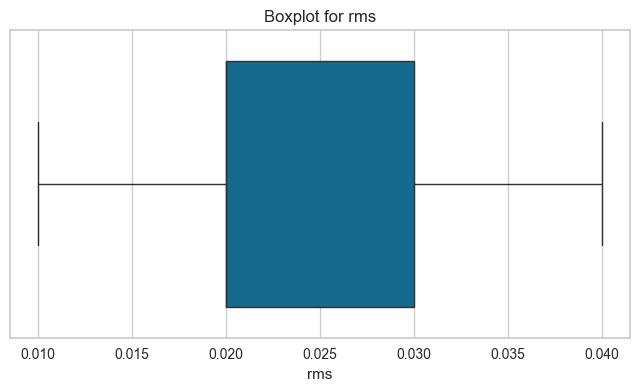

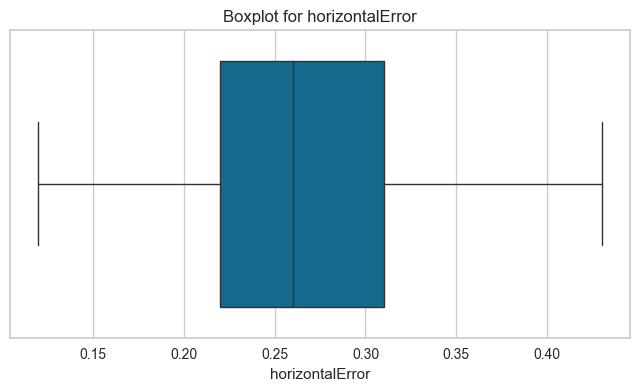

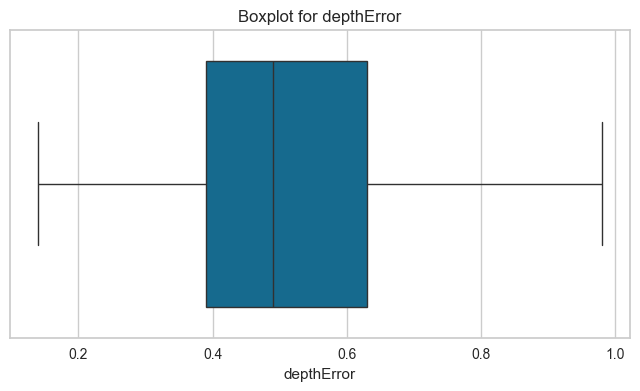

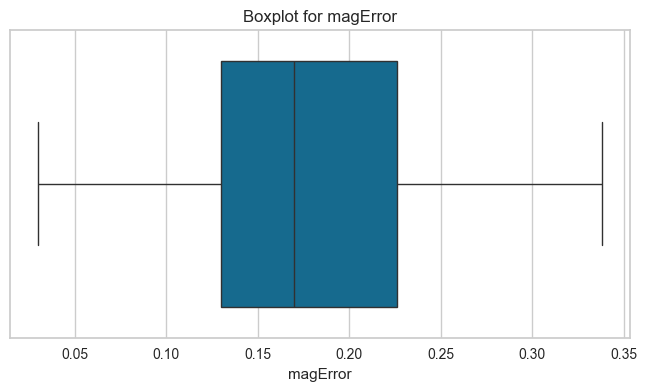

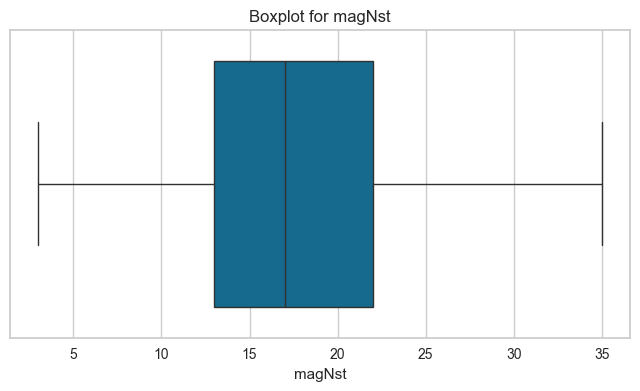

In [1573]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

It has outliers in ['latitude','longitude','depth','nst','gap','dmin'].

In [1574]:
out_list = ['latitude','longitude','depth','nst','gap','dmin']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1575]:
df.shape

(954, 19)

Before we had (1021,19) and now we have (954,19). The difference is (67,19).

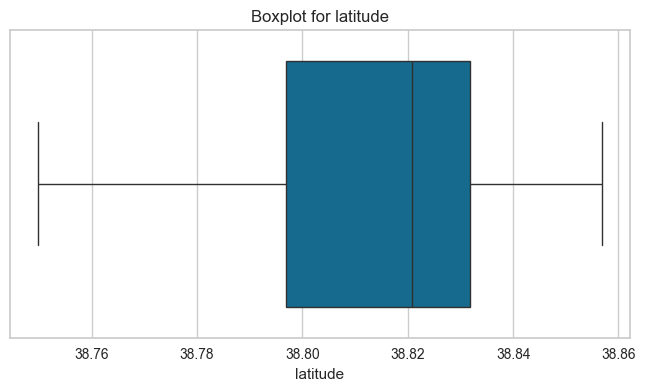

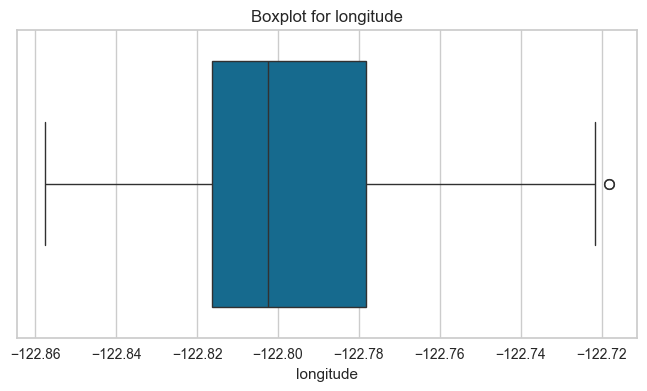

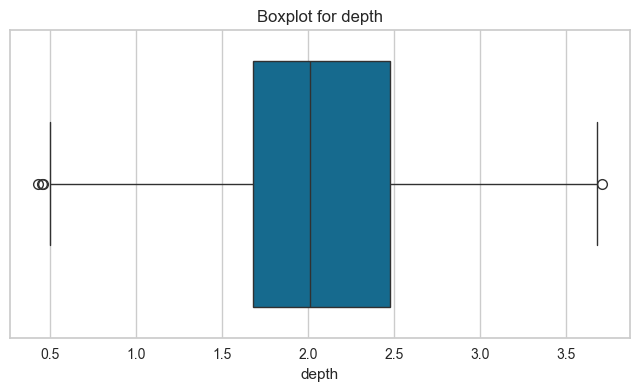

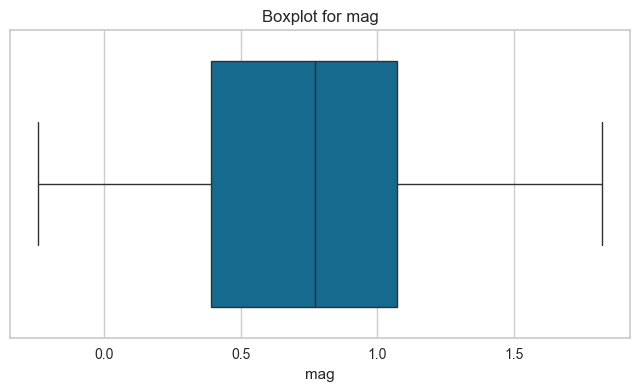

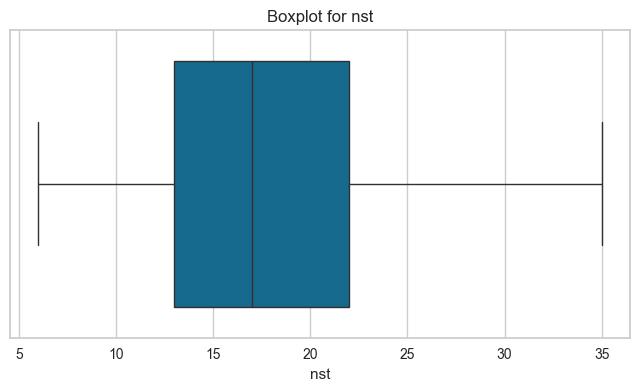

...

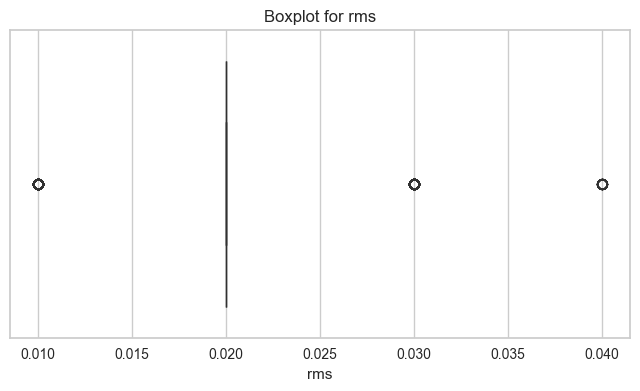

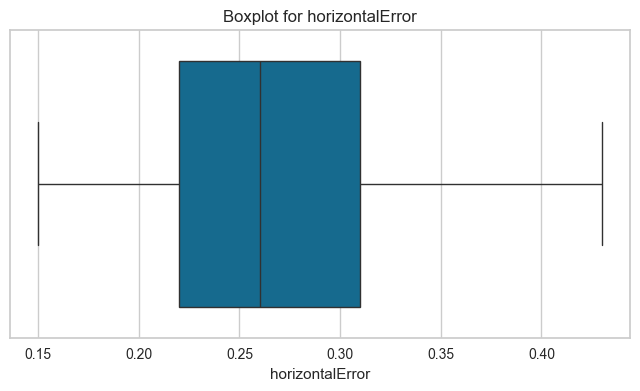

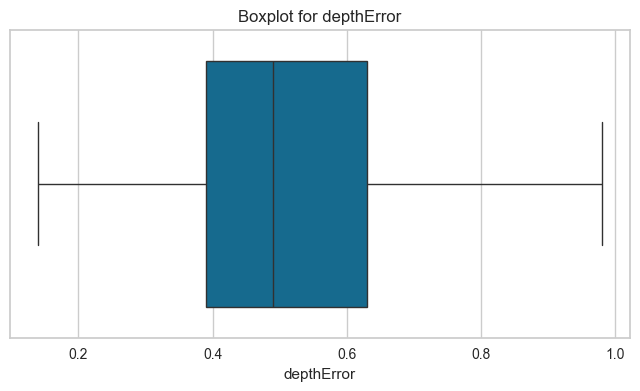

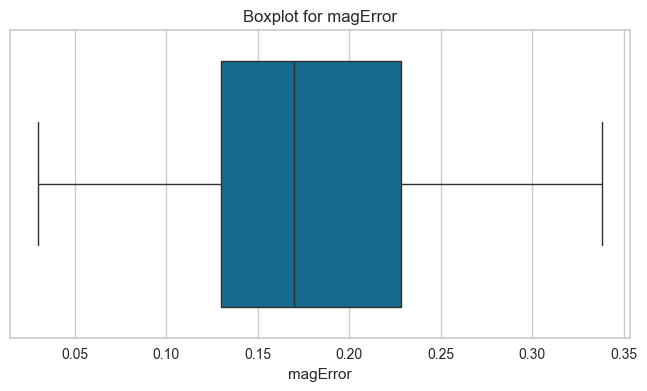

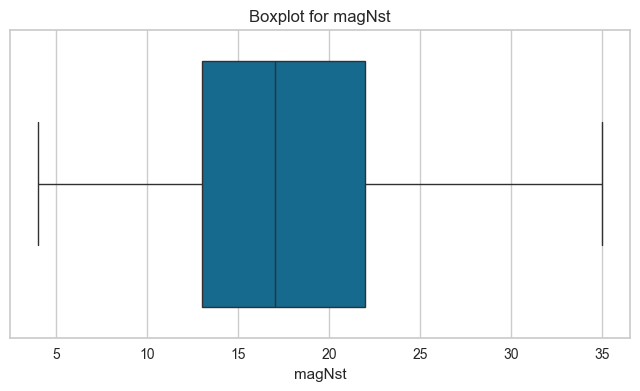

In [1576]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()


We have outliers in ['longitude','rms','depth','gap'].

In [1577]:
out_list = ['longitude','rms','depth','gap']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1578]:
df.shape

(503, 19)

Before we have (954,19) and we have (503,19). The difference is (451,19).

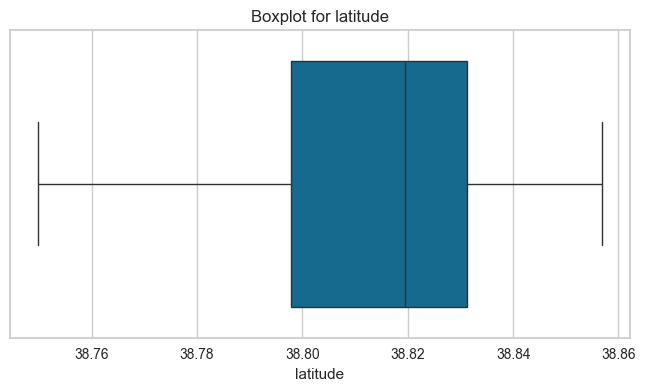

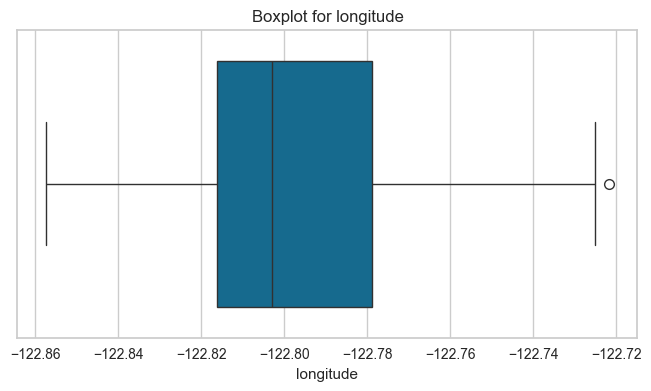

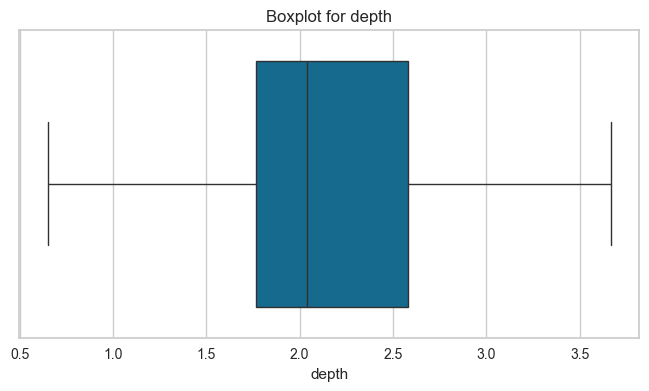

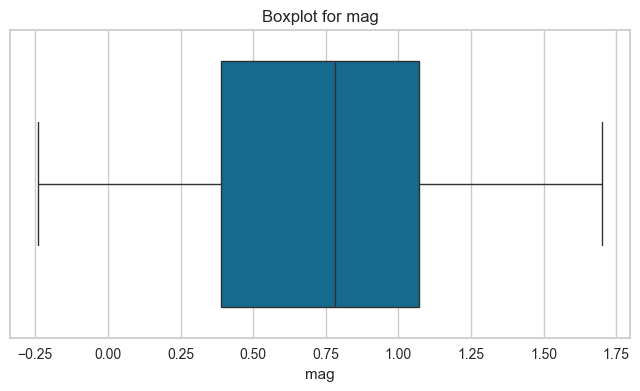

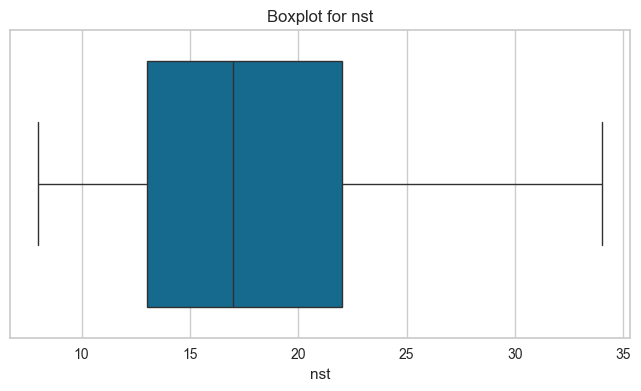

...

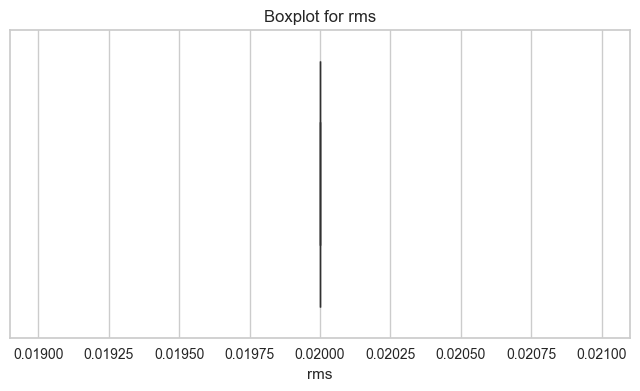

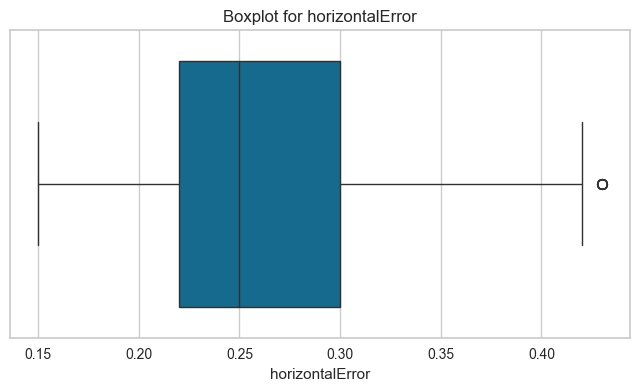

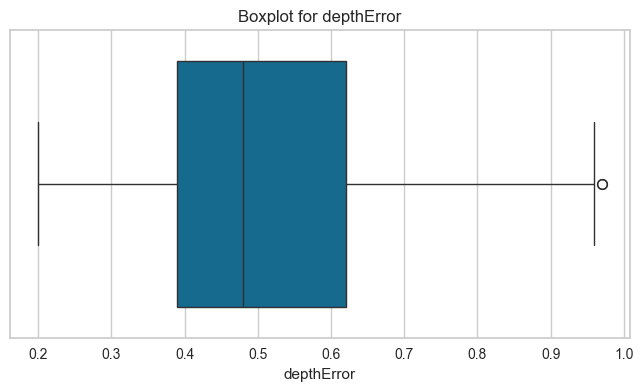

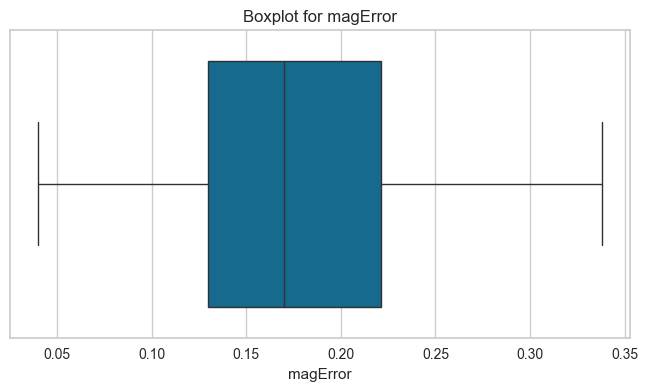

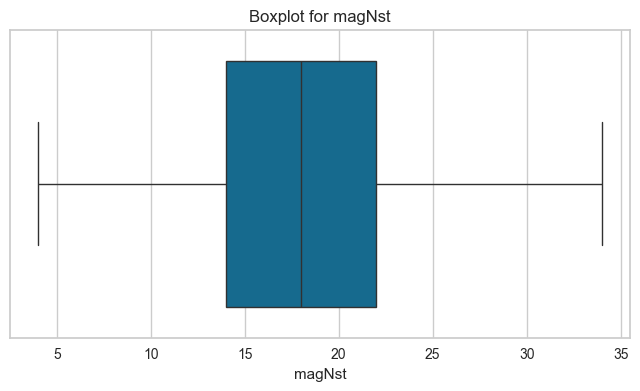

In [1579]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

We have outliers in ['longitude','dmin','horizontalError']. In rms columns after removing the outliers, the data has become a single value. So it no more impact on  the process and analyse of the data.

In [1580]:
out_list = ['longitude','dmin','horizontalError']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1581]:
df.shape

(490, 19)

Before we had (503,19) and now we have (490,19). The difference is (13,19).

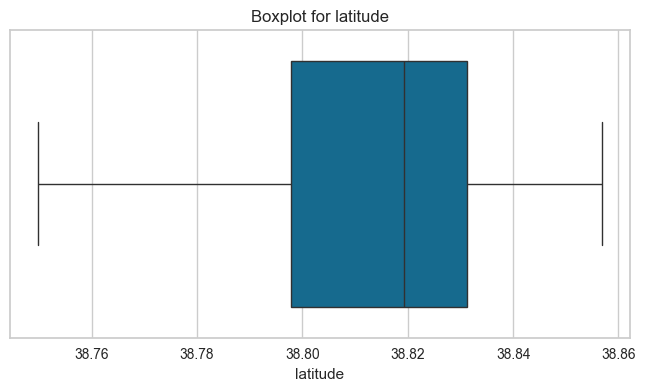

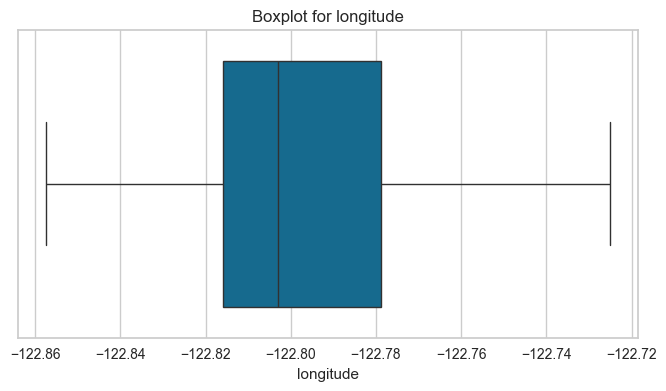

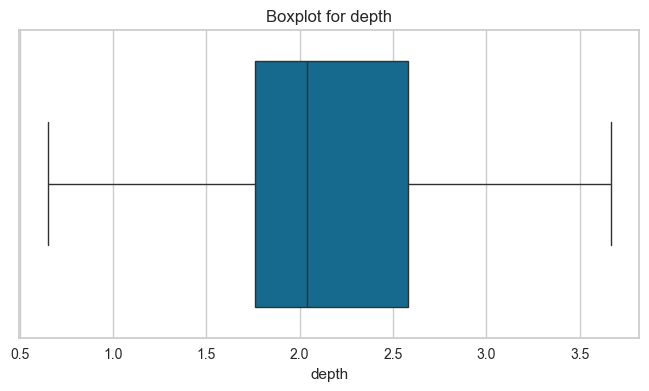

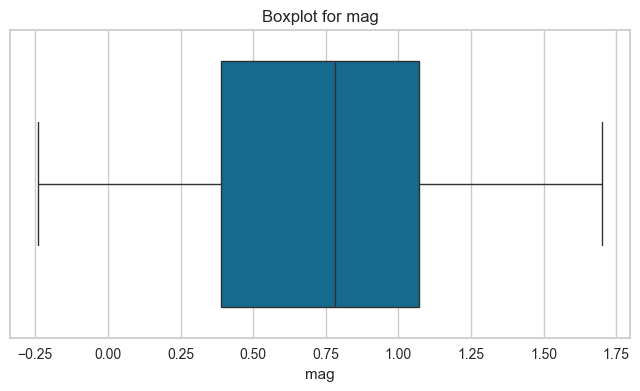

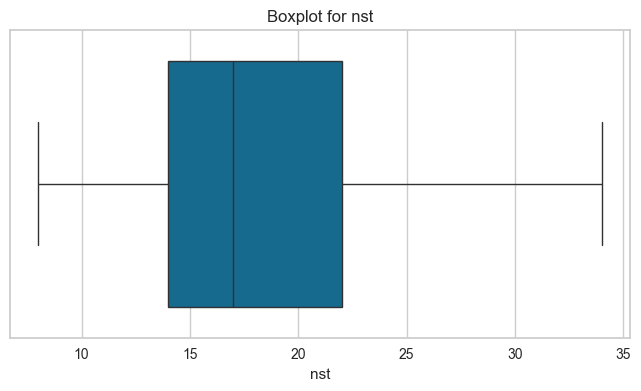

...

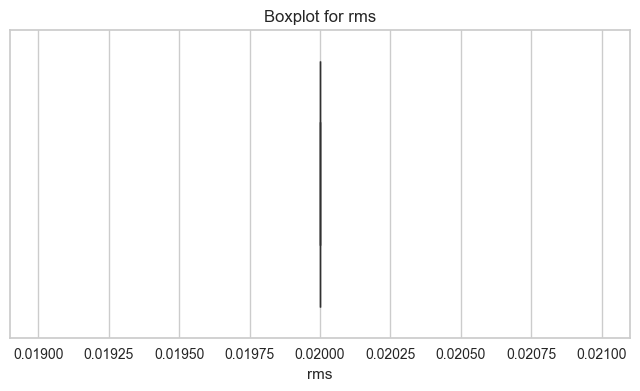

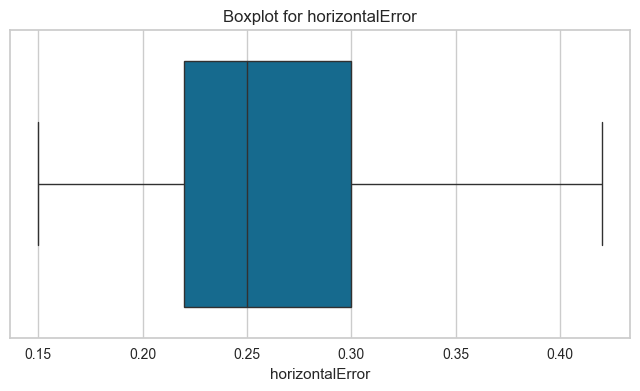

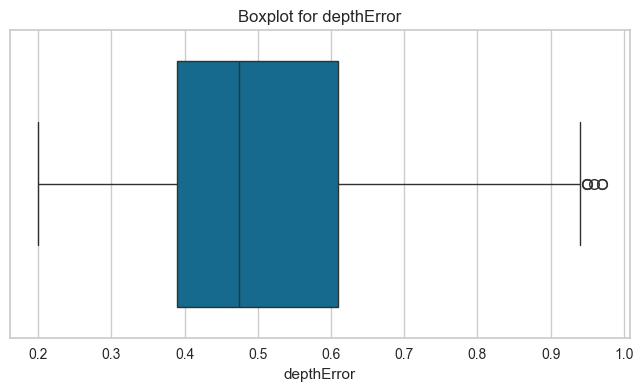

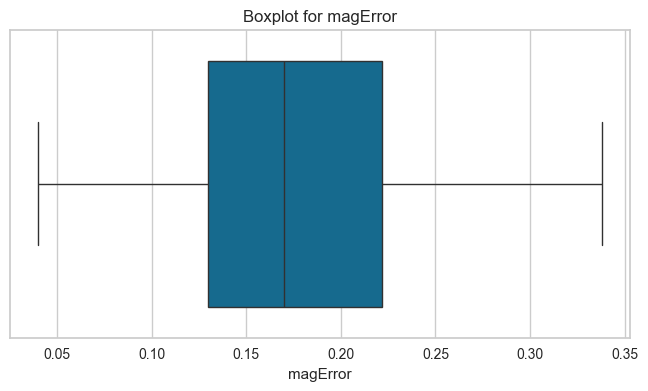

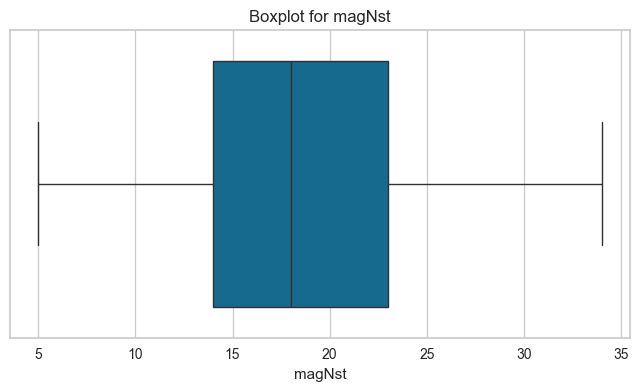

In [1582]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

We have the outliers in ['dmin','depthError'].

In [1583]:
out_list = ['dmin','depthError']

for i in out_list:
    Q1 = df[i].quantile(0.25)
    Q3 = df[i].quantile(0.75)
    
    IQR = Q3-Q1
    
    df = df[(df[i]>= Q1-1.5*IQR) & (df[i]<= Q3+1.5*IQR)]

In [1584]:
df.shape

(483, 19)

Before we had (490,19) and now we had (483,19). The difference is (4,19).

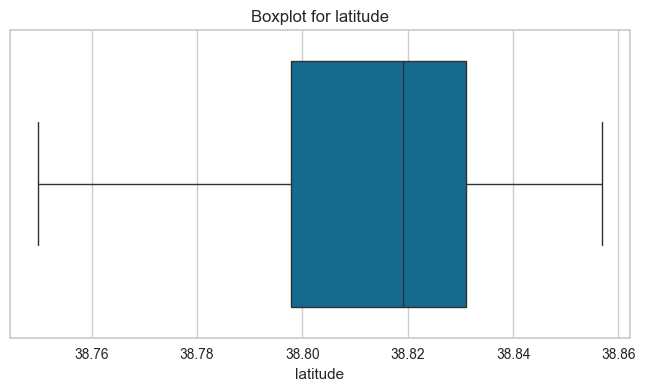

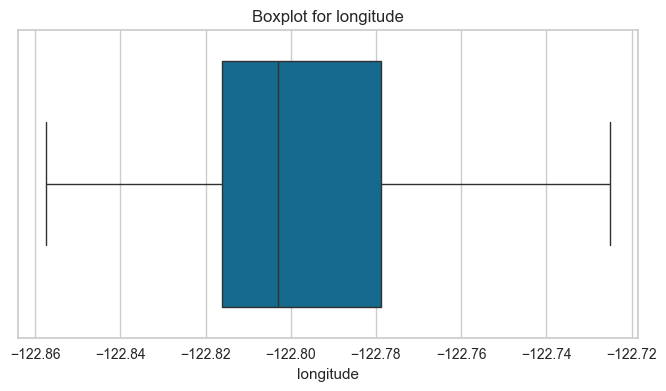

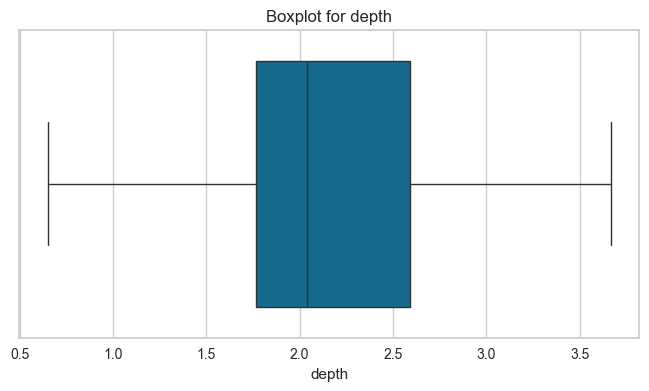

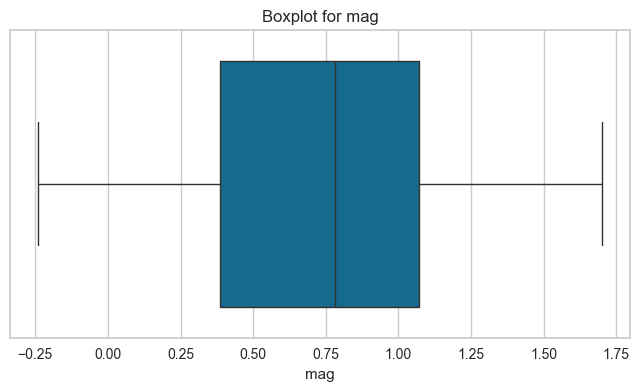

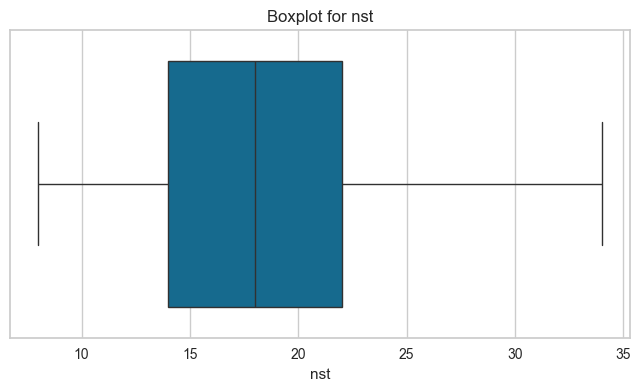

...

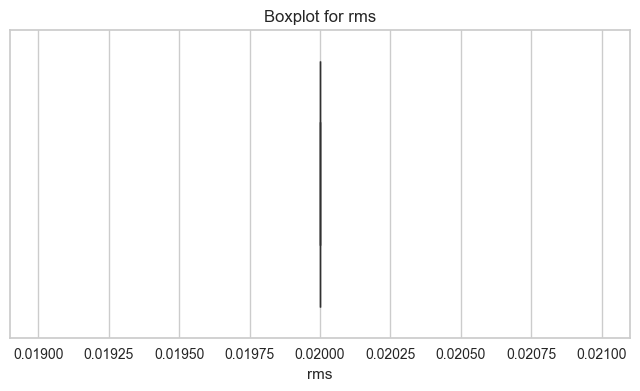

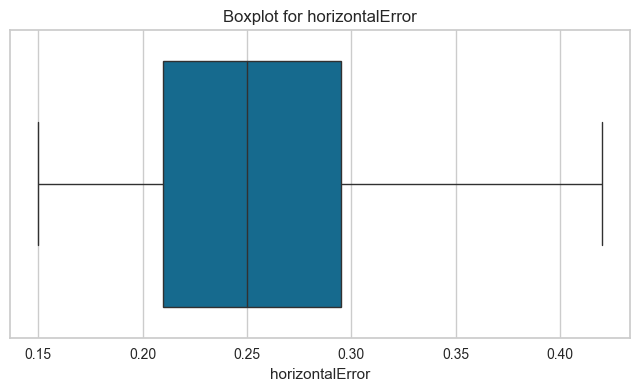

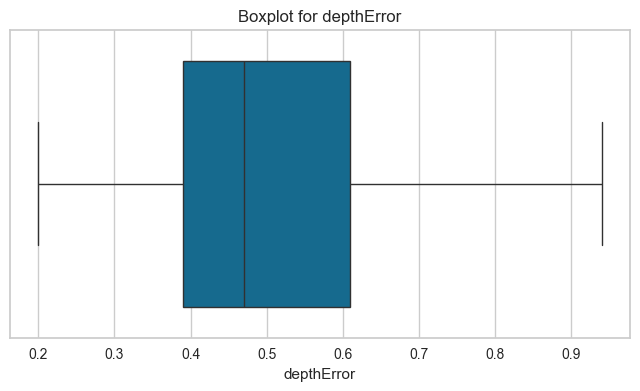

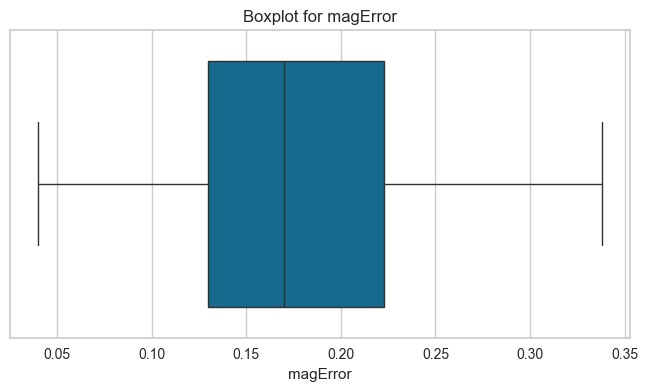

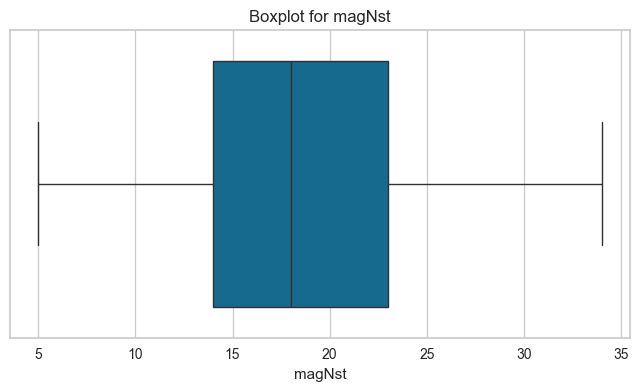

In [1585]:
for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot for {col}')
    plt.show()

Now we have removed all the outliers in the dataset. There will be no disturbance in the processing of the data. Now we can proceed with the analysis of the data.Finally the shae of the data is (483,19).

In [1586]:
df

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
20,38.823002,-122.807335,2.75,1.08,md,17.0,61.0,0.002175,0.02,nc,"7 km NNW of The Geysers, CA",earthquake,0.28,0.50,0.26,18.0,automatic,nc,nc
74,38.818668,-122.812836,3.13,0.76,md,17.0,95.0,0.005189,0.02,nc,"7 km NW of The Geysers, CA",earthquake,0.27,0.67,0.07,18.0,automatic,nc,nc
76,38.836498,-122.782837,2.03,0.82,md,17.0,67.0,0.006166,0.02,nc,"5 km WNW of Cobb, CA",earthquake,0.26,0.50,0.18,18.0,automatic,nc,nc
78,38.828499,-122.800163,2.11,1.04,md,18.0,43.0,0.012520,0.02,nc,"7 km WNW of Cobb, CA",earthquake,0.24,0.56,0.26,19.0,automatic,nc,nc
81,38.828499,-122.800835,1.87,1.05,md,19.0,48.0,0.012850,0.02,nc,"7 km WNW of Cobb, CA",earthquake,0.22,0.66,0.08,20.0,automatic,nc,nc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9276,38.837334,-122.801834,2.14,0.71,md,11.0,84.0,0.009038,0.02,nc,"7 km WNW of Cobb, CA",earthquake,0.33,0.93,0.09,12.0,automatic,nc,nc
9282,38.836834,-122.798836,2.04,1.14,md,25.0,67.0,0.006816,0.02,nc,"7 km WNW of Cobb, CA",earthquake,0.19,0.36,0.12,28.0,automatic,nc,nc
9288,38.847000,-122.848167,1.40,0.77,md,13.0,103.0,0.012980,0.02,nc,"11 km NW of The Geysers, CA",earthquake,0.28,0.49,0.14,17.0,automatic,nc,nc
9296,38.831501,-122.819832,1.95,1.05,md,17.0,58.0,0.011120,0.02,nc,"8 km NNW of The Geysers, CA",earthquake,0.25,0.43,0.29,20.0,automatic,nc,nc


After removing the outliers, we can see the changes in the dataset and its shape. We have reduced large number of data from the dataset. Now we can proces and analyse the data. Since it will take less time to process and analyse it.

In [1587]:
le = LabelEncoder()

for i in df.columns:

    if df[i].dtype == "object":

        df[i] = le.fit_transform(df[i])
        print(le.classes_)

['md']
['nc']
['1 km E of The Geysers, CA' '1 km ENE of The Geysers, CA'
 '1 km N of The Geysers, CA' '1 km NE of The Geysers, CA'
 '1 km NNE of The Geysers, CA' '1 km NNW of The Geysers, CA'
 '1 km SE of The Geysers, CA' '10 km NW of The Geysers, CA'
 '10 km WNW of Cobb, CA' '11 km NW of The Geysers, CA'
 '11 km WNW of Cobb, CA' '2 km  of The Geysers, CA'
 '2 km E of The Geysers, CA' '2 km ENE of The Geysers, CA'
 '2 km ESE of The Geysers, CA' '2 km N of The Geysers, CA'
 '2 km NE of The Geysers, CA' '2 km NNE of The Geysers, CA'
 '2 km NNW of The Geysers, CA' '2 km NW of The Geysers, CA'
 '2 km SE of The Geysers, CA' '3 km  of The Geysers, CA'
 '3 km E of The Geysers, CA' '3 km ENE of The Geysers, CA'
 '3 km ESE of The Geysers, CA' '3 km NNW of The Geysers, CA'
 '3 km NW of The Geysers, CA' '3 km SE of The Geysers, CA'
 '3 km SSE of The Geysers, CA' '3 km W of Cobb, CA' '3 km WNW of Cobb, CA'
 '4 km  of The Geysers, CA' '4 km NNW of The Geysers, CA'
 '4 km NW of The Geysers, CA' '4 k

We uses LabelEncoder to convert all categorical (object-type) columns into numeric columns. This is necessary because many machine learning algorithms can only handle numeric data.Since for training the model we only can use numeric columns, so we convert it otherwise it will show error during th model trainig.

In [1588]:
df.head()

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
20,38.823002,-122.807335,2.75,1.08,0,17.0,61.0,0.002175,0.02,0,44,0,0.28,0.50,0.26,18.0,0,0,0
74,38.818668,-122.812836,3.13,0.76,0,17.0,95.0,0.005189,0.02,0,45,0,0.27,0.67,0.07,18.0,0,0,0
76,38.836498,-122.782837,2.03,0.82,0,17.0,67.0,0.006166,0.02,0,40,0,0.26,0.50,0.18,18.0,0,0,0
78,38.828499,-122.800163,2.11,1.04,0,18.0,43.0,0.012520,0.02,0,46,0,0.24,0.56,0.26,19.0,0,0,0
81,38.828499,-122.800835,1.87,1.05,0,19.0,48.0,0.012850,0.02,0,46,0,0.22,0.66,0.08,20.0,0,0,0


After converting object type columns to numeric type columns. We check the data and find that every column has become numeric value.Now we can perform mathematical operations on these columns.

<Axes: xlabel='latitude', ylabel='Density'>

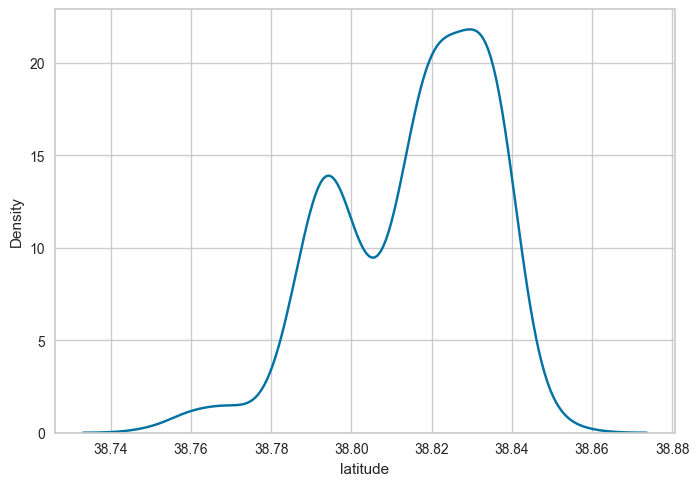

In [1589]:
sns.kdeplot(x='latitude',data=df)

It shows the  Kernel Density Estimate (KDE) for the latitude column, showing the distribution's shape smoothly.It helps visualize where the values of latitude are concentrated or sparse in the dataset.Two peaks around latitudes 38.79 and 38.82, indicating these are the most common locations for earthquake events in the dataset.The sharp drop after 38.83 suggests fewer events occurred beyond that latitude range.

<Axes: xlabel='longitude', ylabel='Density'>

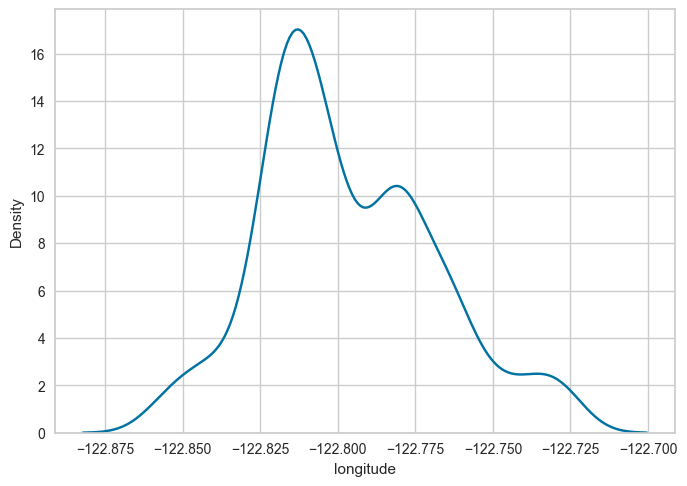

In [1590]:
sns.kdeplot(x='longitude',data=df)

The most earthquake events are concentrated around the -122.825 to -122.800 longitude range, with a prominent peak near -122.82.There is a gradual decline in event density as we move eastward beyond -122.775, indicating fewer earthquakes in that direction.

<Axes: xlabel='depth', ylabel='Density'>

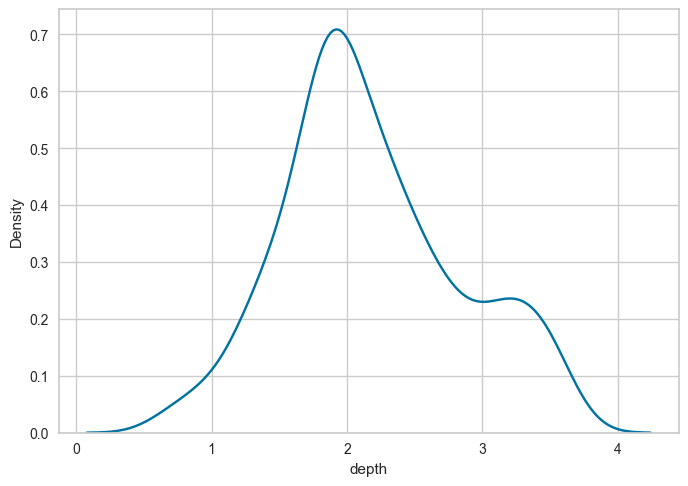

In [1591]:
sns.kdeplot(x='depth',data=df)

The most earthquakes occurred at a depth of around 2 km, with a sharp peak in density at that point.There is a slight secondary rise near 3.2 km, but overall, deeper earthquakes are significantly less frequent.

<Axes: xlabel='mag', ylabel='Density'>

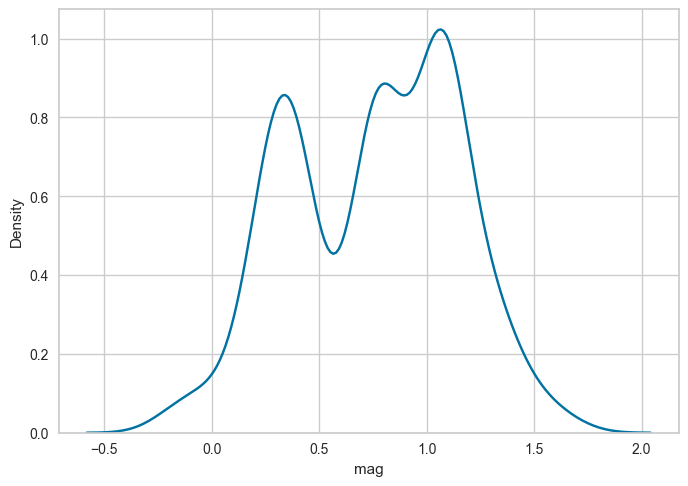

In [1592]:
sns.kdeplot(x='mag',data=df)

The earthquake magnitudes are most frequently around 1.0 and 0.4, with clear peaks at these points.This indicates a two common ranges of low-magnitude seismic activity in the dataset.

<Axes: xlabel='magType', ylabel='Density'>

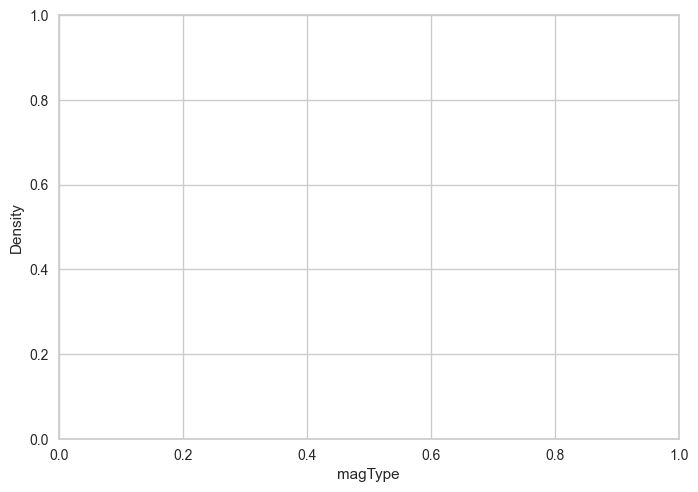

In [1593]:
sns.kdeplot(x='magType',data=df)

magType is empty because it represents categorical data.It is not suitable for non-numeric or encoded category columns.

<Axes: xlabel='nst', ylabel='Density'>

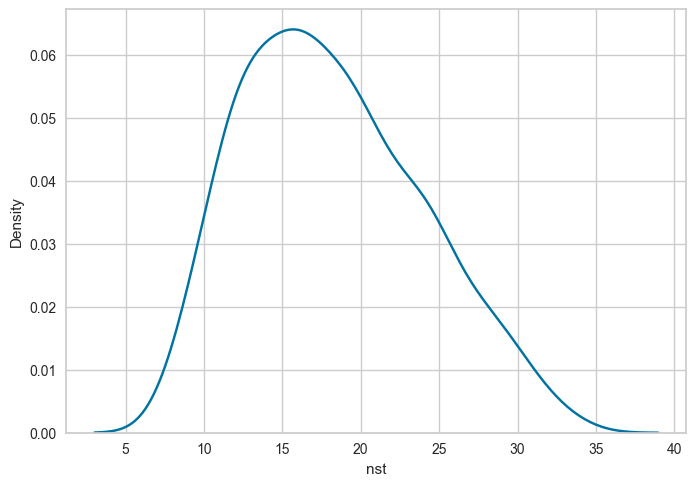

In [1594]:
sns.kdeplot(x='nst',data=df)

It shows a right-skewed distribution, with most earthquakes being recorded by around 15–20 stations.Fewer events are detected by very low or very high numbers of stations, indicating a typical moderate detection range.

<Axes: xlabel='gap', ylabel='Density'>

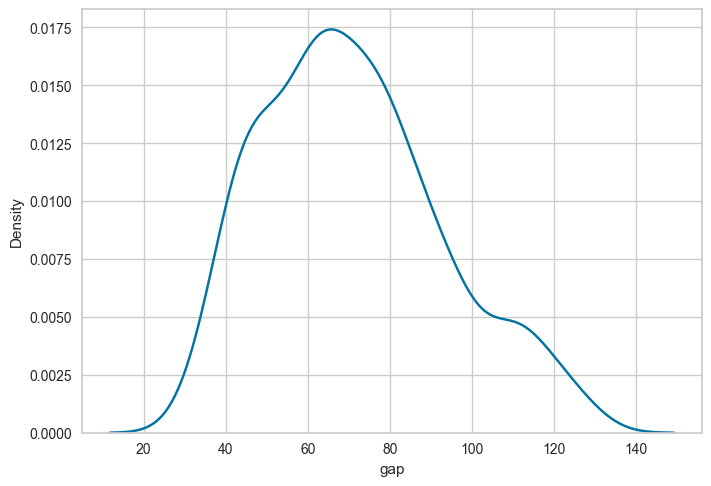

In [1595]:
sns.kdeplot(x='gap',data=df)

It is slightly right-skewed, peaking around 65–70 degrees.Most earthquake events have gap values between 40 and 100, suggesting relatively well-distributed station coverage during detection.

<Axes: xlabel='dmin', ylabel='Density'>

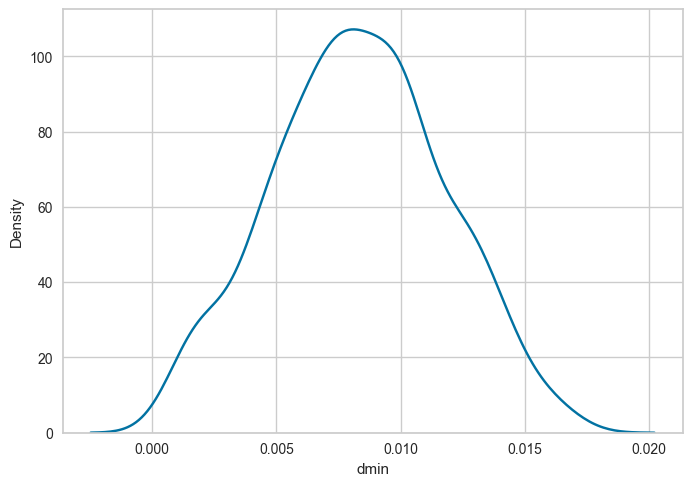

In [1596]:
sns.kdeplot(x='dmin',data=df)

It shows a peak density around 0.009, indicating most earthquakes were detected relatively close to at least one station.The distribution is slightly right-skewed, suggesting a few events occurred at greater distances from the nearest station.

<Axes: xlabel='rms', ylabel='Density'>

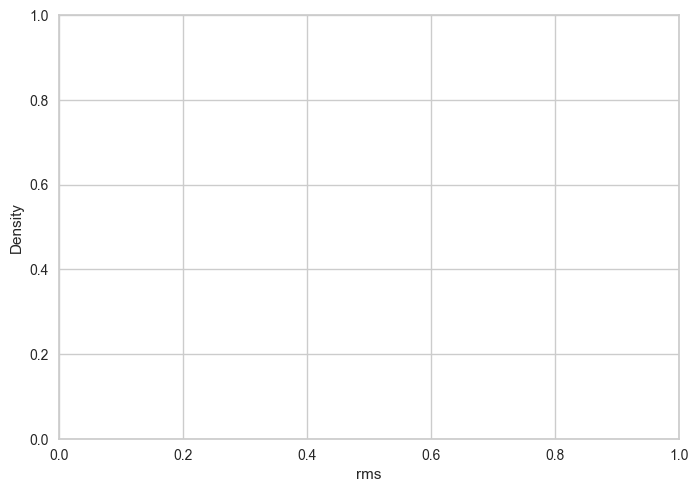

In [1597]:
sns.kdeplot(x='rms',data=df)

After removing all outliers in rms it doesnt have more data to plot.But it only have one value to all the data points.So it doent have the same shape as the original data.

<Axes: xlabel='net', ylabel='Density'>

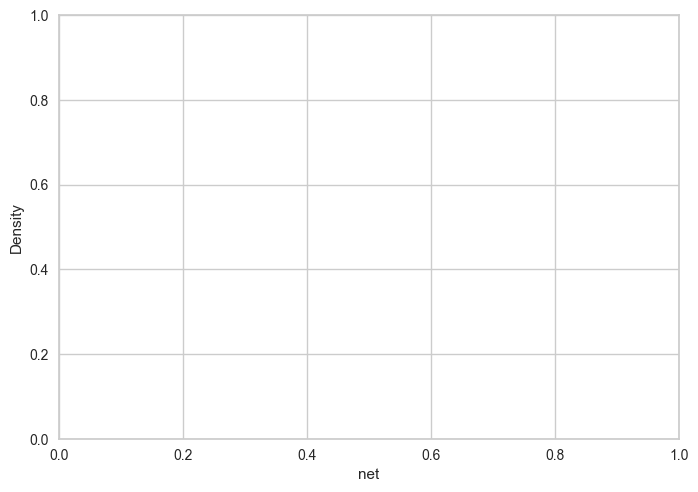

In [1598]:
sns.kdeplot(x='net',data=df)

net is empty because it represents categorical data.It is not suitable for non-numeric or encoded category columns.

In [1599]:
#sns.kdeplot(x='id',data=df)

<Axes: xlabel='place', ylabel='Density'>

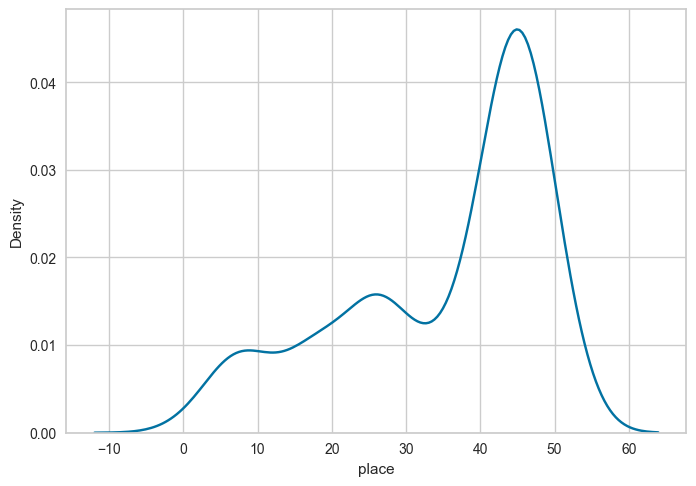

In [1600]:
sns.kdeplot(x='place',data=df)

It has a prominent peak around 45 and smaller peaks around 10 and 25. This suggests that the "place" data clusters around specific values, indicating possible groupings or categories within the data.

<Axes: xlabel='type', ylabel='Density'>

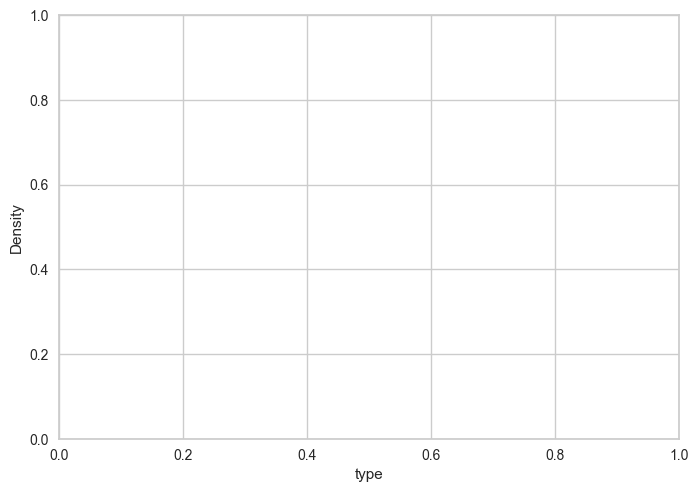

In [1601]:
sns.kdeplot(x='type',data=df)

type is empty because it represents categorical data.It is not suitable for non-numeric or encoded category columns.

<Axes: xlabel='horizontalError', ylabel='Density'>

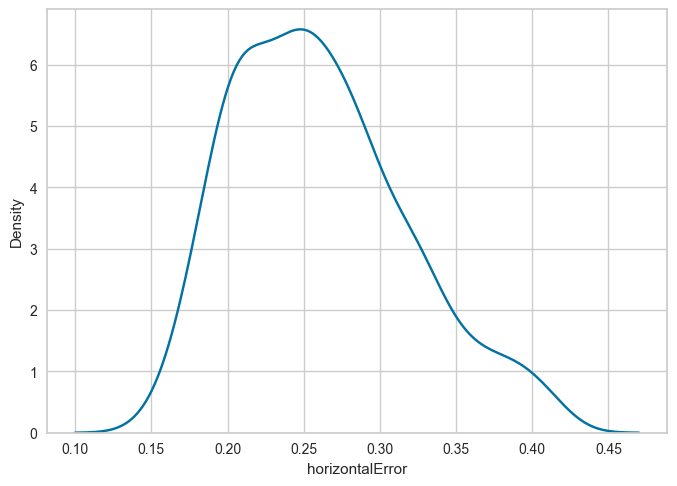

In [1602]:
sns.kdeplot(x='horizontalError',data=df)

The horizontalError is right-skewed, with the highest density around 0.23, indicating most values are concentrated there.

<Axes: xlabel='depthError', ylabel='Density'>

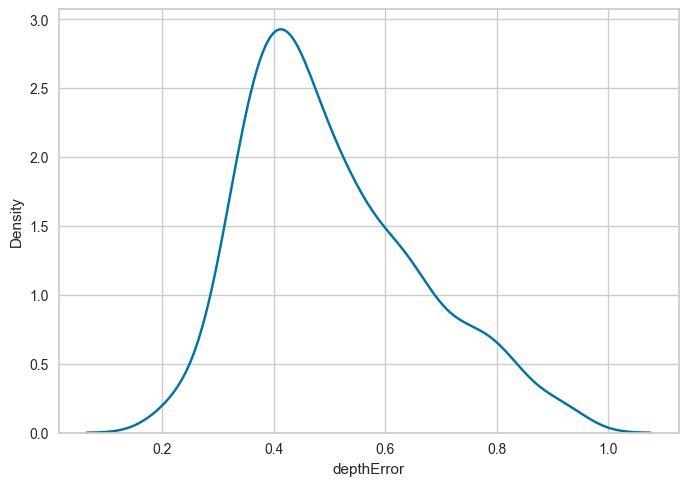

In [1603]:
sns.kdeplot(x='depthError',data=df)

The depthError is unimodal and slightly right-skewed, with the peak density around 0.4. This indicates that most depth error values cluster near 0.4, with fewer instances of higher error values beyond that point.

<Axes: xlabel='magError', ylabel='Density'>

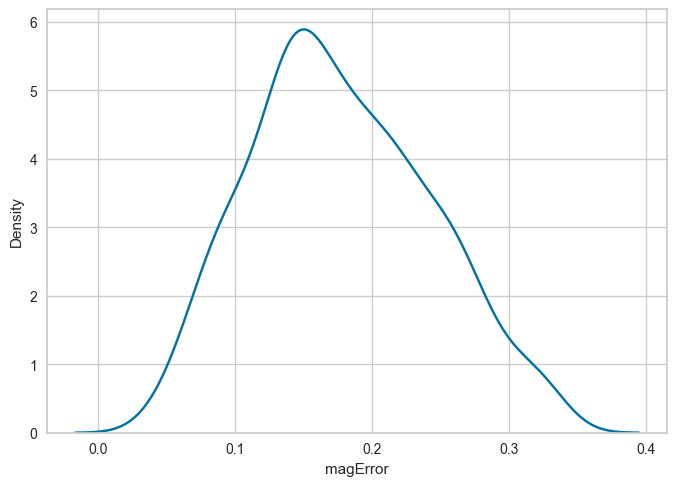

In [1604]:
sns.kdeplot(x='magError',data=df)

The magError shows a unimodal distribution peaking around 0.15, indicating that most magnitude error values lie in this range.

<Axes: xlabel='magNst', ylabel='Density'>

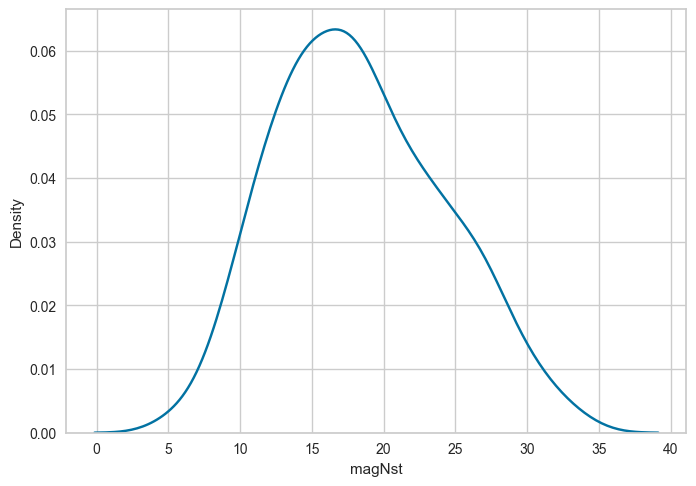

In [1605]:
sns.kdeplot(x='magNst',data=df)

The magNst (number of stations used to determine magnitude) is unimodal and slightly right-skewed, peaking around 17 stations.

<Axes: xlabel='status', ylabel='Density'>

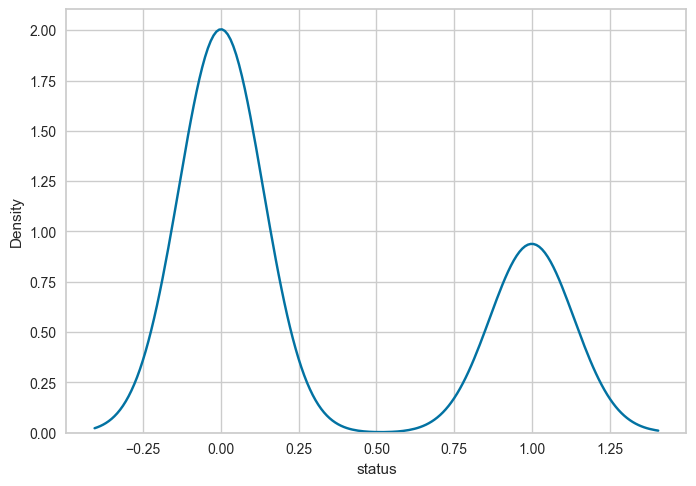

In [1606]:
sns.kdeplot(x='status',data=df)

The status is likely a binary variable, indicating two distinct categories such as “inactive” (0) and “active” (1).

<Axes: xlabel='locationSource', ylabel='Density'>

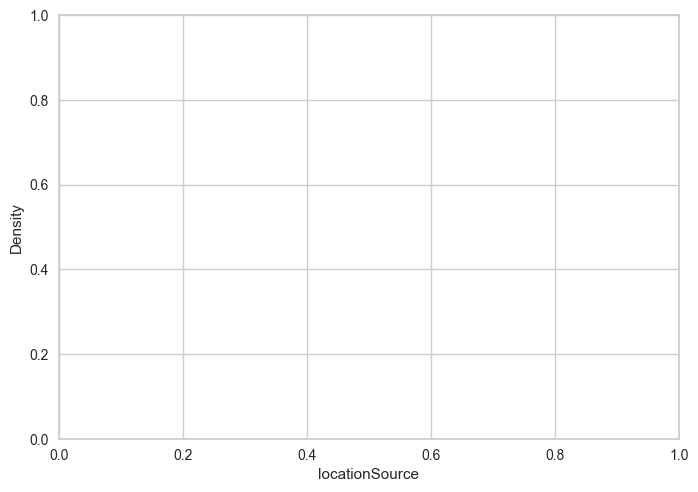

In [1607]:
sns.kdeplot(x='locationSource',data=df)

loocationSource is empty because it represents categorical data.It is not suitable for non-numeric or encoded category columns.

<Axes: xlabel='magSource', ylabel='Density'>

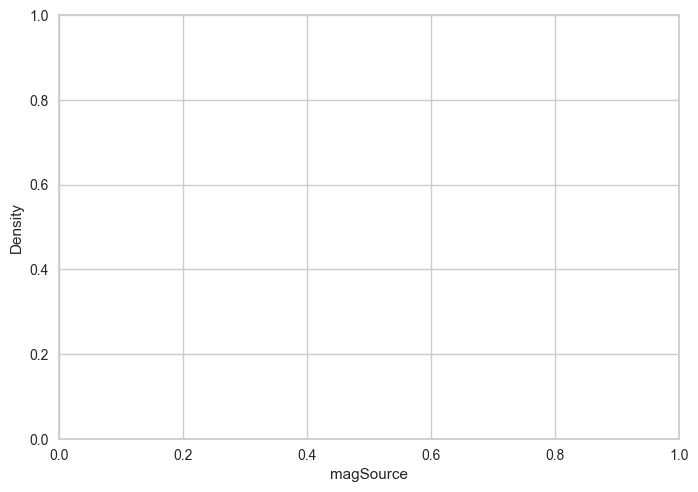

In [1608]:
sns.kdeplot(x='magSource',data=df)

magSource is empty because it represents categorical data.It is not suitable for non-numeric or encoded category columns.

In [1609]:
#sns.kdeplot(x='date_only',data=df)

In [1610]:
#sns.kdeplot(x='time_only',data=df)

In [1611]:
#sns.kdeplot(x='date',data=df)

In [1612]:
#sns.kdeplot(x='time1',data=df)

<Axes: >

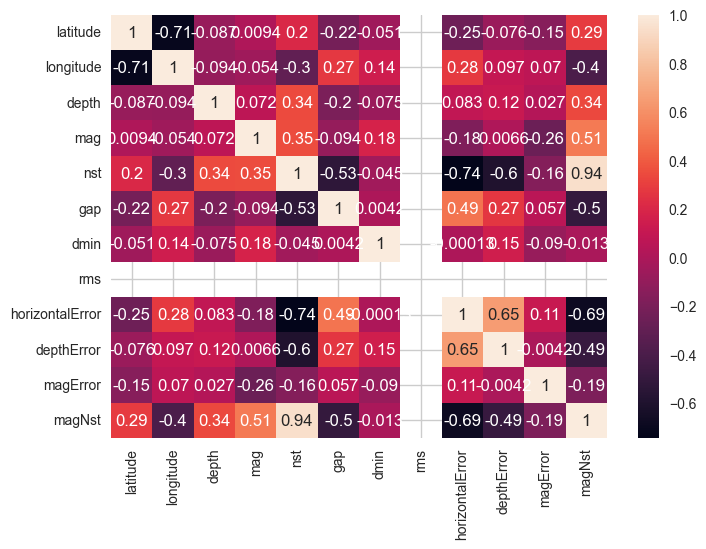

In [1613]:
df=df.select_dtypes(include='float64')
sns.heatmap(df.corr(),annot=True)

The heatmap shows strong negative correlation between latitude and longitude (-0.71), and a strong positive correlation between nst and magNst (0.94). Also, horizontalError is highly negatively correlated with nst (-0.74), suggesting higher station counts reduce location error.

In [1614]:
df=df.drop(['rms'],axis=1)

We remove rms from the dataset because it has only single value and it also doesnot have much effect on the model.

In [1615]:
df.head()

,latitude,longitude,depth,mag,nst,gap,dmin,horizontalError,depthError,magError,magNst
20,38.823002,-122.807335,2.75,1.08,17.0,61.0,0.002175,0.28,0.50,0.26,18.0
74,38.818668,-122.812836,3.13,0.76,17.0,95.0,0.005189,0.27,0.67,0.07,18.0
76,38.836498,-122.782837,2.03,0.82,17.0,67.0,0.006166,0.26,0.50,0.18,18.0
78,38.828499,-122.800163,2.11,1.04,18.0,43.0,0.012520,0.24,0.56,0.26,19.0
81,38.828499,-122.800835,1.87,1.05,19.0,48.0,0.012850,0.22,0.66,0.08,20.0


After removing rms column we are checking the dataset.

In [1616]:
df.corr()

,latitude,longitude,depth,mag,nst,gap,dmin,horizontalError,depthError,magError,magNst
latitude,1.000000,-0.711091,-0.086911,0.009380,0.204736,-0.222306,-0.050518,-0.251589,-0.076356,-0.145416,0.288656
longitude,-0.711091,1.000000,-0.093879,-0.053758,-0.304054,0.271019,0.141914,0.280852,0.097257,0.069936,-0.399133
depth,-0.086911,-0.093879,1.000000,0.071838,0.341475,-0.199129,-0.074564,0.083466,0.116030,0.026510,0.338247
mag,0.009380,-0.053758,0.071838,1.000000,0.348169,-0.094272,0.180612,-0.180938,0.006640,-0.261756,0.511000
nst,0.204736,-0.304054,0.341475,0.348169,1.000000,-0.528712,-0.044705,-0.744754,-0.596043,-0.161947,0.944650
gap,-0.222306,0.271019,-0.199129,-0.094272,-0.528712,1.000000,0.004192,0.490297,0.267090,0.057075,-0.502002
dmin,-0.050518,0.141914,-0.074564,0.180612,-0.044705,0.004192,1.000000,-0.000127,0.151491,-0.090261,-0.013053
horizontalError,-0.251589,0.280852,0.083466,-0.180938,-0.744754,0.490297,-0.000127,1.000000,0.646268,0.112791,-0.690140
depthError,-0.076356,0.097257,0.116030,0.006640,-0.596043,0.267090,0.151491,0.646268,1.000000,-0.004191,-0.487890
magError,-0.145416,0.069936,0.026510,-0.261756,-0.161947,0.057075,-0.090261,0.112791,-0.004191,1.000000,-0.186007


The correlation matrix reveals a very strong positive relationship between nst and magNst (0.94) and a strong negative correlation between nst and horizontalError (-0.74), indicating that more station readings improve accuracy. Latitude and longitude are strongly negatively correlated (-0.71), suggesting a geographic pattern in the data.

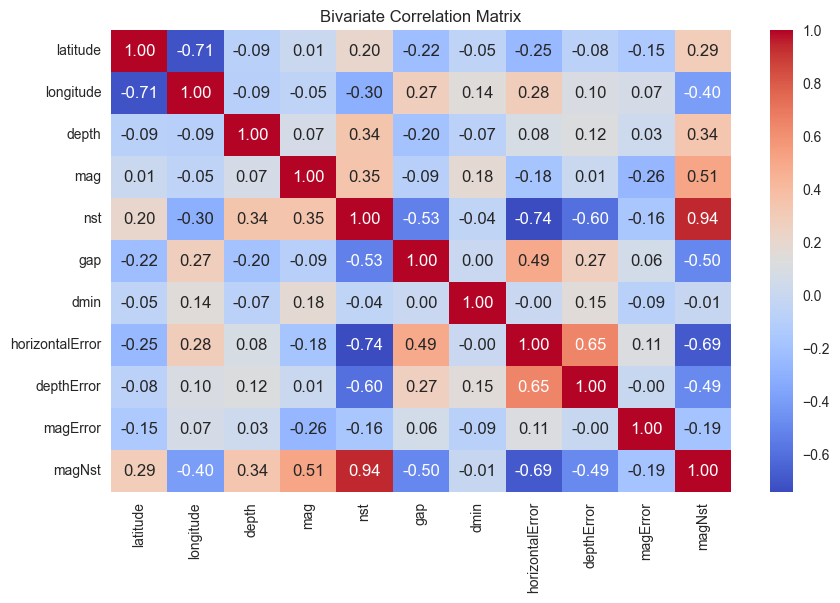

In [1617]:
plt.figure(figsize=(10, 6))
sns.heatmap(df.corr(numeric_only=True), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Bivariate Correlation Matrix")
plt.show()

It is visualization of bivariate correlation analysis using heatmap.

In [1618]:
df.dtypes

latitude           float64
longitude          float64
depth              float64
mag                float64
nst                float64
gap                float64
dmin               float64
horizontalError    float64
depthError         float64
magError           float64
magNst             float64
dtype: object

In [1619]:
df

,latitude,longitude,depth,mag,nst,gap,dmin,horizontalError,depthError,magError,magNst
20,38.823002,-122.807335,2.75,1.08,17.0,61.0,0.002175,0.28,0.50,0.26,18.0
74,38.818668,-122.812836,3.13,0.76,17.0,95.0,0.005189,0.27,0.67,0.07,18.0
76,38.836498,-122.782837,2.03,0.82,17.0,67.0,0.006166,0.26,0.50,0.18,18.0
78,38.828499,-122.800163,2.11,1.04,18.0,43.0,0.012520,0.24,0.56,0.26,19.0
81,38.828499,-122.800835,1.87,1.05,19.0,48.0,0.012850,0.22,0.66,0.08,20.0
...,...,...,...,...,...,...,...,...,...,...,...
9276,38.837334,-122.801834,2.14,0.71,11.0,84.0,0.009038,0.33,0.93,0.09,12.0
9282,38.836834,-122.798836,2.04,1.14,25.0,67.0,0.006816,0.19,0.36,0.12,28.0
9288,38.847000,-122.848167,1.40,0.77,13.0,103.0,0.012980,0.28,0.49,0.14,17.0
9296,38.831501,-122.819832,1.95,1.05,17.0,58.0,0.011120,0.25,0.43,0.29,20.0


In [1620]:
df.shape

(483, 11)

Here we can see that column which are changes from object type to numeric type have deleted. So, we have 483 rows and 11 columns.

Here we calculate multli-collinearityby using Variance Inflation Factor (VIF) for all numeric. If it has  higher values indicate stronger multicollinearity.It should be between 1 to 5,higher than that should be reduced so it does not affect the model.

In [1621]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,latitude,8.924510e+06
1,longitude,8.929802e+06
2,depth,2.404091e+01
3,mag,1.037331e+01
4,nst,1.866745e+02
5,gap,1.730123e+01
6,dmin,7.352838e+00
7,horizontalError,7.767732e+01
8,depthError,2.747448e+01
9,magError,9.535020e+00


Now we see latitude and longitude have high value of 8.924510e+06 correlation.

In [1622]:
df=df.drop(['latitude'],axis=1)

Now we delete latitude from the dataset.

In [1623]:
df.shape

(483, 10)

Now we have  483 rows and 10 columns.

In [1624]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,longitude,200.770593
1,depth,22.743245
2,mag,9.689355
3,nst,180.827322
4,gap,17.227196
5,dmin,7.351438
6,horizontalError,77.673881
7,depthError,27.239685
8,magError,9.328731
9,magNst,160.802329


We have high value in longitude of 200.770593.

In [1625]:
df=df.drop(['longitude'],axis=1)

We are deleting longitude from the dataset.

In [1626]:
df.shape

(483, 9)

We have 483 rows and 9 columns.

In [1627]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,depth,19.732254
1,mag,9.468105
2,nst,139.112992
3,gap,15.490555
4,dmin,7.071162
5,horizontalError,46.087454
6,depthError,23.818119
7,magError,8.408587
8,magNst,160.789367


Now we have high value in magNst of 160.789367.

In [1628]:
df=df.drop(['magNst'],axis=1)

We remove magNst from the dataset.

In [1629]:
df.shape

(483, 8)

Now we have 483 rows and 8 columns.

In [1630]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,depth,19.630615
1,mag,6.411440
2,nst,16.200448
3,gap,15.432961
4,dmin,7.040539
5,horizontalError,45.448999
6,depthError,23.300694
7,magError,8.392265


We have high value in horizontalError of 45.448999.

In [1631]:
df=df.drop(['horizontalError'],axis=1)

We are removing the horizontalError from the dataset.

In [1632]:
df.shape

(483, 7)

Now we have 483 rows and 7 columns.

In [1633]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,depth,17.663117
1,mag,6.410430
2,nst,15.980944
3,gap,10.240767
4,dmin,7.011311
5,depthError,15.772030
6,magError,7.835259


Now we have high value in nst of 15.980944.

In [1634]:
df=df.drop(['nst'],axis=1)

So we remove nst from the dataset.

In [1635]:
df.shape

(483, 6)

We have 483 rows and 6 columns.

In [1636]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,depth,9.731641
1,mag,4.725482
2,gap,10.201268
3,dmin,6.551255
4,depthError,12.762938
5,magError,7.281798


We have high value in depthError of 12.762938.

In [1637]:
df=df.drop(['depthError'],axis=1)

We remove depthError from the dataset.

In [1638]:
df.shape

(483, 5)

We have 483 rows and 5 columns.

In [1639]:
var_inflation=[]
for i in df.columns:
    if((df[i].dtype!='object')&(i!='charges')):
        var_inflation.append(i)
x=df[var_inflation]
vif_data=pd.DataFrame()
vif_data['feature']=x.columns
vif_data['VIF']=[variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif_data

,feature,VIF
0,depth,8.516222
1,mag,4.710026
2,gap,8.014505
3,dmin,6.138280
4,magError,7.229991


We have reduced high value from the datset. But we have depth and gap with 8, magError with 7 it okay because it is moderate value.It will not highly affect the model.

In [1640]:
df.head()

,depth,mag,gap,dmin,magError
20,2.75,1.08,61.0,0.002175,0.26
74,3.13,0.76,95.0,0.005189,0.07
76,2.03,0.82,67.0,0.006166,0.18
78,2.11,1.04,43.0,0.012520,0.26
81,1.87,1.05,48.0,0.012850,0.08


We can see now how many columns are in the dataset and what are the values.

In [1641]:
df.shape

(483, 5)

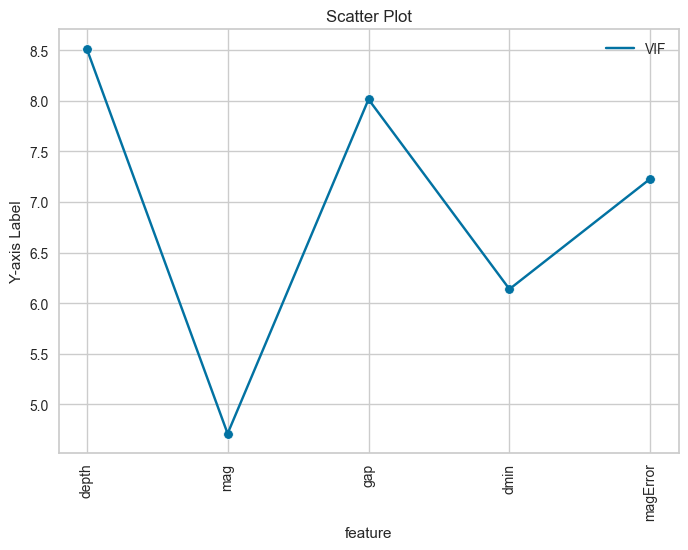

In [1642]:
sns.scatterplot(data=vif_data, x='feature', y='VIF')
sns.lineplot(data=vif_data)
# Add labels and title
plt.xticks(rotation=90)
plt.ylabel('Y-axis Label')
plt.title('Scatter Plot')

# Show plot
plt.show()

It shows  visualize multicollinearity using the scatterplot.The x-axis shows feature names (rotated for readability), and the y-axis represents their corresponding VIF values.

In [1643]:
df.columns

Index(['depth', 'mag', 'gap', 'dmin', 'magError'], dtype='object')

Here we have columns of the datset.

In [1644]:
data = {
    'feature': ['depth', 'mag', 'gap', 'dmin', 'magError', ],
    'VIF': [8.516222, 4.710026, 8.014505, 6.138280, 7.229991]
}
df1 = pd.DataFrame(data)

We are assigning the data from df to df1 as two columns.

In [1645]:
df1

,feature,VIF
0,depth,8.516222
1,mag,4.710026
2,gap,8.014505
3,dmin,6.138280
4,magError,7.229991


we are checking the data of df1

In [1646]:
df1.shape

(5, 2)

We have 5 rows and 2 columns.

In [1647]:
df

,depth,mag,gap,dmin,magError
20,2.75,1.08,61.0,0.002175,0.26
74,3.13,0.76,95.0,0.005189,0.07
76,2.03,0.82,67.0,0.006166,0.18
78,2.11,1.04,43.0,0.012520,0.26
81,1.87,1.05,48.0,0.012850,0.08
...,...,...,...,...,...
9276,2.14,0.71,84.0,0.009038,0.09
9282,2.04,1.14,67.0,0.006816,0.12
9288,1.40,0.77,103.0,0.012980,0.14
9296,1.95,1.05,58.0,0.011120,0.29


In [1648]:
X = df1[['VIF']]


We assigning X as column VIF from df1 dataset

In [1649]:
silhouette_scores = []
K_range = range(2, 5) 

The variable K_range = range(2, 5) defines a range of values from 2 to 4 (inclusive of 2, exclusive of 5) for the number of clusters to evaluate.

In [1650]:
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X)
    score = silhouette_score(X, labels)
    silhouette_scores.append(score)

This loop runs KMeans clustering for each number of clusters (k) in K_range, fits the model, and predicts labels for the data X.For each k, it calculates the silhouette score (a measure of cluster quality) and appends it to silhouette_scores.

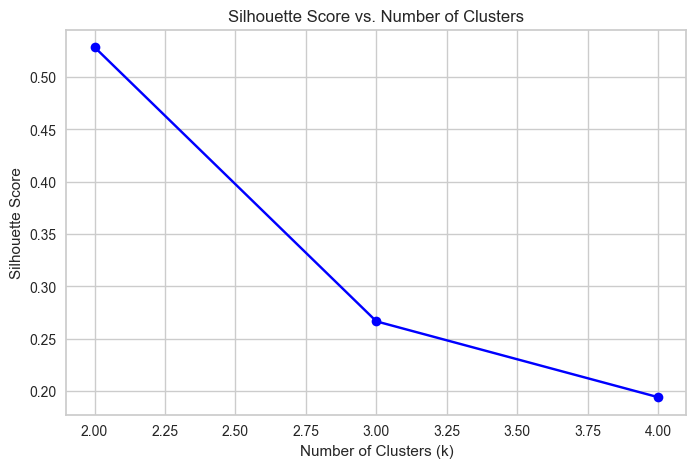

In [1651]:
plt.figure(figsize=(8, 5))
plt.plot(K_range, silhouette_scores, marker='o', linestyle='-', color='blue')
plt.title("Silhouette Score vs. Number of Clusters")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.grid(True)
plt.show()

This code plots a line graph showing the silhouette scores for different numbers of clusters (k) to help identify the optimal number of clusters.It uses markers and a grid for clarity, and labels the axes and title to explain the plotted relationship.

In [1652]:
best_k = K_range[silhouette_scores.index(max(silhouette_scores))]
print(f"Best number of clusters: {best_k}")

Best number of clusters: 2


This code finds the number of clusters (k) that gives the highest silhouette score by locating the index of the maximum score.It then prints the optimal number of clusters (best_k) for the given dataset.

In [1653]:
final_kmeans = KMeans(n_clusters=best_k, random_state=42)
df1['Cluster'] = final_kmeans.fit_predict(X)

A KMeans model is created using the best number of clusters (best_k) and fitted to the data X. The predicted cluster labels are then added as a new column 'Cluster' in the df1 DataFrame.

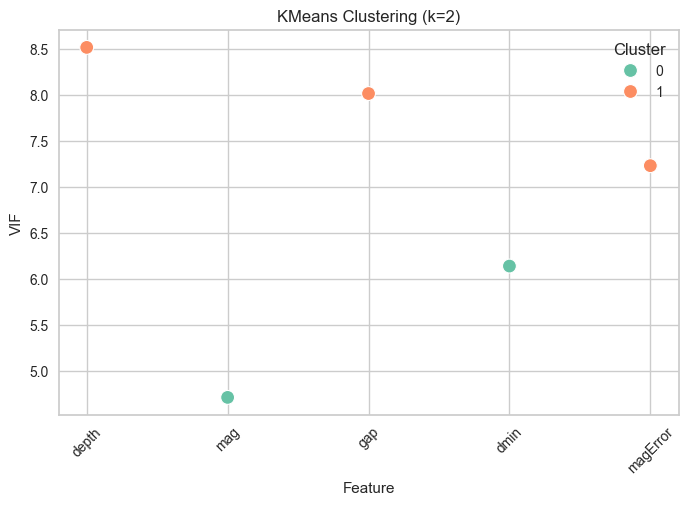

In [1654]:
plt.figure(figsize=(8, 5))
sns.scatterplot(x='feature', y='VIF', hue='Cluster', data=df1, palette='Set2', s=100)
plt.title(f"KMeans Clustering (k={best_k})")
plt.xlabel("Feature")
plt.ylabel("VIF")
plt.xticks(rotation=45)
plt.show()

It shows features vs. their VIF (Variance Inflation Factor) values, colored by cluster labels assigned by KMeans using scatter plot.

In [1655]:
df1

,feature,VIF,Cluster
0,depth,8.516222,1
1,mag,4.710026,0
2,gap,8.014505,1
3,dmin,6.138280,0
4,magError,7.229991,1


We have new column as cluster added to df1 dataset. 

In [1656]:
df1.shape

(5, 3)

We have 5 rows and 3 columns.

In [1657]:
df

,depth,mag,gap,dmin,magError
20,2.75,1.08,61.0,0.002175,0.26
74,3.13,0.76,95.0,0.005189,0.07
76,2.03,0.82,67.0,0.006166,0.18
78,2.11,1.04,43.0,0.012520,0.26
81,1.87,1.05,48.0,0.012850,0.08
...,...,...,...,...,...
9276,2.14,0.71,84.0,0.009038,0.09
9282,2.04,1.14,67.0,0.006816,0.12
9288,1.40,0.77,103.0,0.012980,0.14
9296,1.95,1.05,58.0,0.011120,0.29


In [1658]:
X = df.drop('mag', axis=1)  # features
y = df['mag']  

Now we are seperating the dataset into two so we can build model. We are dropping mag from X dataset and assigning it to y.

In [1659]:
X

,depth,gap,dmin,magError
20,2.75,61.0,0.002175,0.26
74,3.13,95.0,0.005189,0.07
76,2.03,67.0,0.006166,0.18
78,2.11,43.0,0.012520,0.26
81,1.87,48.0,0.012850,0.08
...,...,...,...,...
9276,2.14,84.0,0.009038,0.09
9282,2.04,67.0,0.006816,0.12
9288,1.40,103.0,0.012980,0.14
9296,1.95,58.0,0.011120,0.29


In X dataset we have depth,gap,dmin,magError columns.

In [1660]:
X.shape

(483, 4)

We have 483 rows and 4 columns.

In [1661]:
y

20      1.08
74      0.76
76      0.82
78      1.04
81      1.05
        ... 
9276    0.71
9282    1.14
9288    0.77
9296    1.05
9317    1.40
Name: mag, Length: 483, dtype: float64

We have mag as y dataset.

In [1662]:
y.shape

(483,)

We have 493 rows and no columns.

In [1663]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.80, random_state = 100)
X_train

,depth,gap,dmin,magError
2557,2.01,84.0,0.007652,0.211
8409,2.37,66.0,0.008082,0.134
792,2.51,68.0,0.003418,0.224
918,2.92,65.0,0.010580,0.180
1381,2.47,33.0,0.005082,0.119
...,...,...,...,...
6715,2.60,46.0,0.011420,0.270
7058,2.23,119.0,0.008317,0.060
6387,2.28,69.0,0.006581,0.190
5702,1.86,93.0,0.009906,0.274


This code splits the dataset into training and testing sets, using 80% of the data for training (X_train, y_train) and 20% for testing (X_test, y_test). The random_state=100 ensures reproducibility of the split.

In [1664]:
X_train.shape

(386, 4)

It has 386 rows and 4 columns.

In [1665]:
X_test

,depth,gap,dmin,magError
3344,1.42,75.0,0.009969,0.142
7950,3.45,77.0,0.016460,0.060
6480,0.81,74.0,0.008168,0.226
474,2.38,70.0,0.008042,0.200
8957,1.92,66.0,0.009058,0.160
...,...,...,...,...
6078,1.86,75.0,0.006620,0.204
7314,2.37,119.0,0.009549,0.254
8891,2.78,111.0,0.012380,0.270
3703,2.12,46.0,0.008453,0.120


In [1666]:
X_test.shape

(97, 4)

We have 97 rows and 4 colums.

In [1667]:
y_train

2557    0.36
8409    0.31
792     0.33
918     1.06
1381    0.45
        ... 
6715    0.98
7058    0.22
6387    0.95
5702    0.29
115     0.77
Name: mag, Length: 386, dtype: float64

In [1668]:
y_train.shape

(386,)

It has 386 rows and 0 columns.

In [1669]:
y_test

3344    0.33
7950    1.07
6480    0.23
474     0.76
8957    1.21
        ... 
6078    0.25
7314    0.60
8891    0.45
3703    1.08
8614    0.77
Name: mag, Length: 97, dtype: float64

In [1670]:
y_test.shape

(97,)

It has 97 rows and 0 columns.

In [1671]:
l_model=LinearRegression()
l_model.fit(X_train,y_train)

LinearRegression()

A linear regression model (l_model) is created and trained using the training data (X_train and y_train).

In [1672]:
predictions = l_model.predict(X_test)

The trained linear regression model (l_model) is used to predict target values based on the test input features (X_test).

In [1673]:
predictions

array([0.76915599, 1.10802985, 0.59479278, 0.71652017, 0.76173366,
       0.66427477, 0.83460716, 0.51599031, 0.49113859, 0.60936911,
       0.68988022, 0.73955956, 0.90698764, 0.49832002, 0.62425964,
       0.76790371, 0.44822802, 0.73260533, 0.91386821, 0.89772349,
       0.74981057, 0.7761864 , 0.57841351, 0.7092197 , 0.6199826 ,
       0.82865993, 0.54281914, 0.78718694, 0.75685241, 0.74566055,
       0.77511611, 0.71295304, 0.7055497 , 0.83199504, 0.8726736 ,
       0.78837107, 0.82778531, 0.80334977, 0.9040536 , 0.76156399,
       0.96534244, 0.66723586, 0.57534133, 0.62180011, 0.59783563,
       0.69282396, 0.7327011 , 0.53512606, 0.81703997, 0.80652805,
       0.80776767, 0.68892239, 0.77742988, 0.61702328, 0.692612  ,
       0.82448026, 0.6925763 , 0.79993002, 0.81185577, 0.70858383,
       0.74874414, 0.77427652, 0.91358752, 0.79509324, 0.70816455,
       0.88543493, 0.78701047, 0.80342932, 0.86932459, 0.71641643,
       0.74760848, 0.75682183, 0.81503862, 0.65212189, 0.82331

We are seeing the prediction value from input feature.

In [1674]:
r2score=r2_score(y_test,predictions)
r2score

0.11918965927650038

The r2_score function calculates the R-squared value, which measures how well the model’s predictions match the actual test values (y_test). A higher R² score (closer to 1) indicates better model performance.

In [1675]:
X_test

,depth,gap,dmin,magError
3344,1.42,75.0,0.009969,0.142
7950,3.45,77.0,0.016460,0.060
6480,0.81,74.0,0.008168,0.226
474,2.38,70.0,0.008042,0.200
8957,1.92,66.0,0.009058,0.160
...,...,...,...,...
6078,1.86,75.0,0.006620,0.204
7314,2.37,119.0,0.009549,0.254
8891,2.78,111.0,0.012380,0.270
3703,2.12,46.0,0.008453,0.120


In [1676]:
a=l_model.predict([[3,47488, 18, 3784999]])
a

array([-4812007.07172855])

This line uses the trained linear regression model (l_model) to predict the target value for a new data point with features [3, 47488, 18, 3784999]

In [1677]:
mse = mean_squared_error(y_test, predictions)
print("Mean Squared Error:", mse)

Mean Squared Error: 0.13716580748406715


We are finding mean squared error using y_test and prediction as input

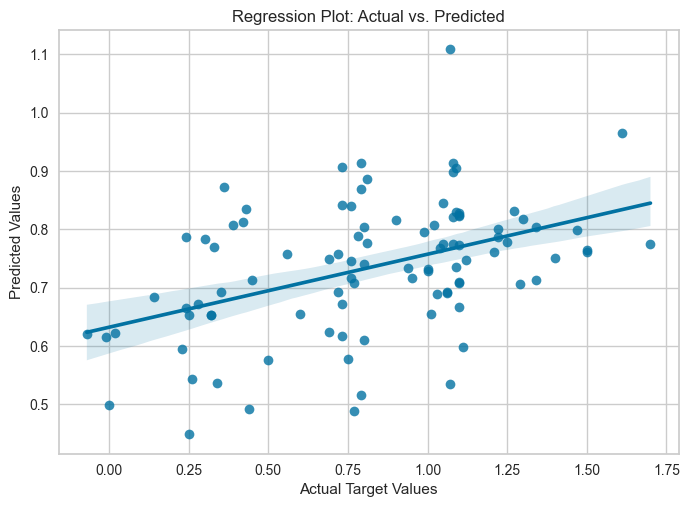

In [1678]:
sns.regplot(x=y_test, y=predictions)

# Set plot labels and title
plt.xlabel("Actual Target Values")
plt.ylabel("Predicted Values")
plt.title("Regression Plot: Actual vs. Predicted")

# Display the plot
plt.show()

It shows the visulation between actual (y_test) and predicted (predictions) values using regression plot.

In [1679]:
print(l_model.coef_)

l_model.intercept_

[ 5.68640722e-02 -4.31037948e-04  1.84941447e+01 -1.27141920e+00]


0.7169102553298563

l_model.coef_ prints the coefficients (slopes) of the linear regression model, showing how each feature influences the target variable.
l_model.intercept_ gives the model's intercept, which is the predicted value when all input features are zero.

In [1680]:
coefficients = pd.DataFrame({'Feature': X.columns, 'Coefficient': l_model.coef_})
coefficients

,Feature,Coefficient
0,depth,0.056864
1,gap,-0.000431
2,dmin,18.494145
3,magError,-1.271419


It create coefficients to display each feature from X alongside its corresponding coefficient from the trained linear regression model.

In [1681]:
y_pred = l_model.predict(X_test)
y_train_pred=l_model.predict(X_train)

results_train_df=pd.DataFrame({'Actual Value':y_train,'Predicted Value': y_train_pred,})
results_test_df = pd.DataFrame({'Actual Value': y_test, 'Predicted Value': y_pred})

It usese trained linear regression model to predict values for both training (X_train) and testing (X_test) data.It then creates results_train_df and results_test_df to compare actual vs. predicted values for model performance analysis.

In [1682]:
results_train_df

,Actual Value,Predicted Value
2557,0.36,0.668248
8409,0.31,0.802329
792,0.33,0.608744
918,1.06,0.821748
1381,0.45,0.785829
...,...,...
6715,0.98,0.712849
7058,0.22,0.869954
6387,0.95,0.696959
5702,0.29,0.617425


It compares the actual value and predicted value of trainig dataset.

In [1683]:
results_test_df

,Actual Value,Predicted Value
3344,0.33,0.769156
7950,1.07,1.108030
6480,0.23,0.594793
474,0.76,0.716520
8957,1.21,0.761734
...,...,...
6078,0.25,0.653411
7314,0.60,0.654045
8891,0.45,0.712821
3703,1.08,0.821395


It compare the actual and predicted value of test dataset.

In [1684]:
train_mse = mean_squared_error(y_train, y_train_pred)
train_rmse = np.sqrt(train_mse)
train_r2 = r2_score(y_train, y_train_pred)

test_mse = mean_squared_error(y_test, y_pred)
test_rmse = np.sqrt(test_mse)
test_r2 = r2_score(y_test, y_pred)

print("Training Set Performance:")
print(f"MSE: {train_mse}")
print(f"RMSE: {train_rmse}")
print(f"R-squared: {train_r2}")

print("\nTesting Set Performance:")
print(f"MSE: {test_mse}")
print(f"RMSE: {test_rmse}")
print(f"R-squared: {test_r2}")

Training Set Performance:
MSE: 0.13758649769045198
RMSE: 0.3709265394797897
R-squared: 0.08727415917988102

Testing Set Performance:
MSE: 0.13716580748406715
RMSE: 0.3703590251149108
R-squared: 0.11918965927650038


It calculate Mean Squared Error (MSE), Root Mean Squared Error (RMSE), and R-squared (R²)—for both the training and testing datasets.

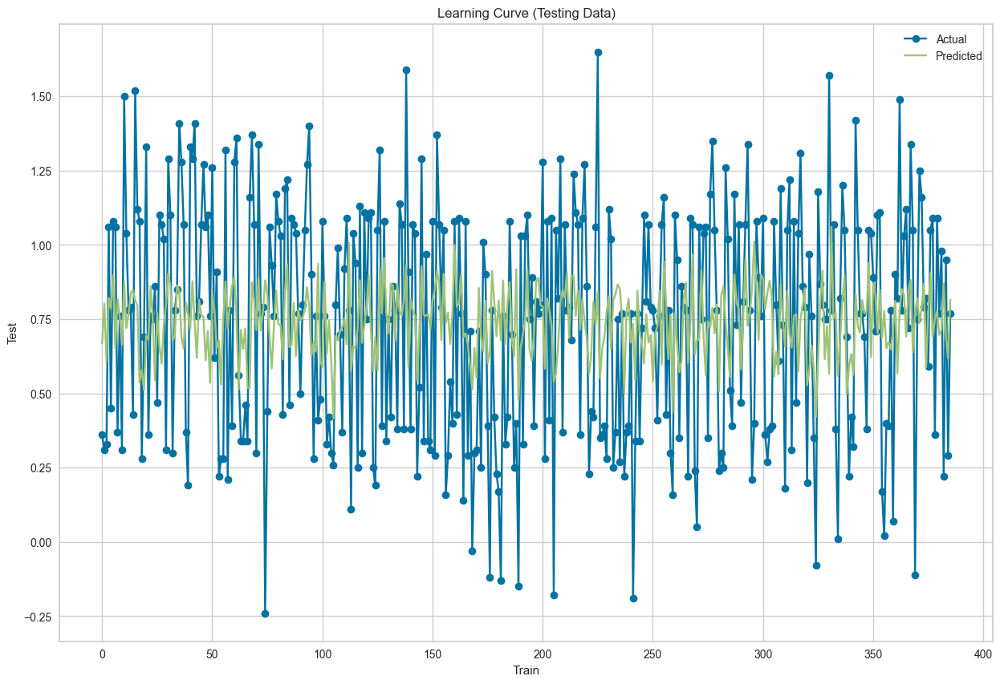

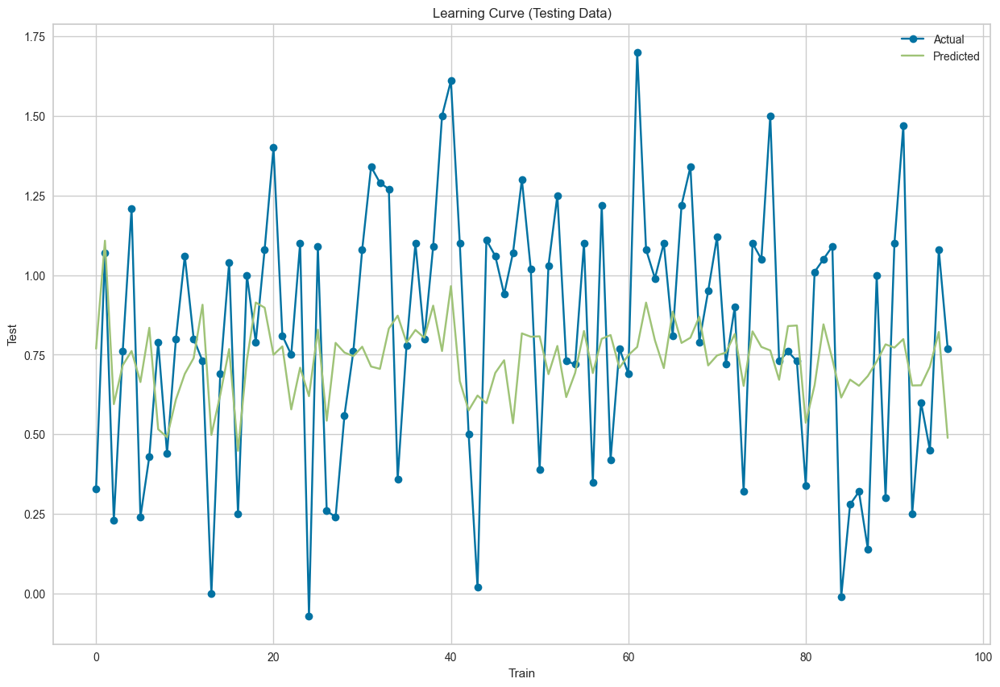

In [1685]:
plt.figure(figsize=(15, 10))
plt.plot(range(len(y_train)), y_train, label='Actual', marker='o')
plt.plot(range(len(y_train_pred)), y_train_pred, label='Predicted', marker='x')
plt.xlabel('Train')
plt.ylabel('Test')
plt.title('Learning Curve (Testing Data)')
plt.legend()
plt.grid(True)
plt.show()


#Plot for testing data
plt.figure(figsize=(15, 10))
plt.plot(range(len(y_test)), y_test, label='Actual', marker='o')
plt.plot(range(len(y_pred)), y_pred, label='Predicted', marker='x')
plt.xlabel('Train')
plt.ylabel('Test')
plt.title('Learning Curve (Testing Data)')
plt.legend()
plt.grid(True)
plt.show()

It visually compare actual vs. predicted values for both training and testing datasets. The closer the predicted line is to the actual line, the better the model's performance.

In [1686]:
results_train_df

,Actual Value,Predicted Value
2557,0.36,0.668248
8409,0.31,0.802329
792,0.33,0.608744
918,1.06,0.821748
1381,0.45,0.785829
...,...,...
6715,0.98,0.712849
7058,0.22,0.869954
6387,0.95,0.696959
5702,0.29,0.617425


In [1687]:
results_test_df


,Actual Value,Predicted Value
3344,0.33,0.769156
7950,1.07,1.108030
6480,0.23,0.594793
474,0.76,0.716520
8957,1.21,0.761734
...,...,...
6078,0.25,0.653411
7314,0.60,0.654045
8891,0.45,0.712821
3703,1.08,0.821395



Feature Importance:
    Feature  Coefficient
2      dmin    18.494145
0     depth     0.056864
1       gap    -0.000431
3  magError    -1.271419


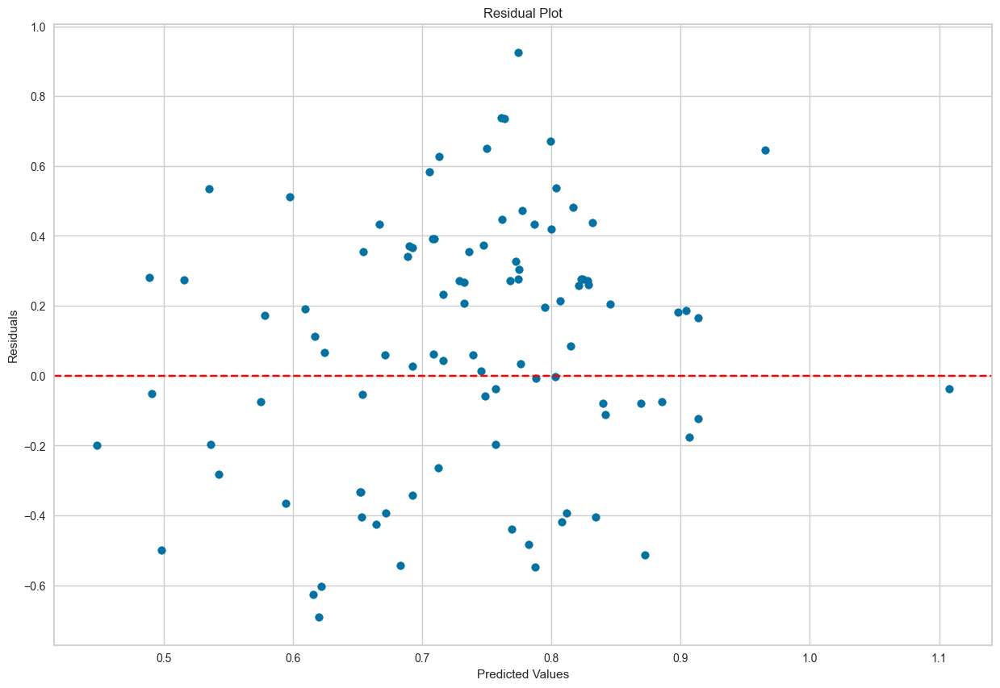

In [1688]:
print("\nFeature Importance:")
print(coefficients.sort_values(by='Coefficient', ascending=False))

# 2. Residual Analysis: Check for patterns in the residuals (the difference between predicted and actual values).
residuals = y_test - y_pred
plt.figure(figsize=(15, 10))
plt.scatter(y_pred, residuals)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
plt.title("Residual Plot")
plt.axhline(y=0, color='red', linestyle='--')
plt.show()

It gives the feature importance based on linear regression coefficients, showing which variables most impact predictions.The residual plot checks if prediction errors are randomly distributed—indicating a good model—or if patterns exist, which may suggest model issues.

In [1689]:
print(f"Coefficients: {l_model.coef_}")
print(f"Intercept: {l_model.intercept_}")

Coefficients: [ 5.68640722e-02 -4.31037948e-04  1.84941447e+01 -1.27141920e+00]
Intercept: 0.7169102553298563


In [1690]:
X_test

,depth,gap,dmin,magError
3344,1.42,75.0,0.009969,0.142
7950,3.45,77.0,0.016460,0.060
6480,0.81,74.0,0.008168,0.226
474,2.38,70.0,0.008042,0.200
8957,1.92,66.0,0.009058,0.160
...,...,...,...,...
6078,1.86,75.0,0.006620,0.204
7314,2.37,119.0,0.009549,0.254
8891,2.78,111.0,0.012380,0.270
3703,2.12,46.0,0.008453,0.120


In [1691]:
y_test

3344    0.33
7950    1.07
6480    0.23
474     0.76
8957    1.21
        ... 
6078    0.25
7314    0.60
8891    0.45
3703    1.08
8614    0.77
Name: mag, Length: 97, dtype: float64

In [1692]:
r2test=r2_score(y_test,predictions)
r2test

0.11918965927650038

It calculate r2 value of test dataset.

In [1693]:
predictions1=l_model.predict(X_train)

It calculate the prediction value for X_train

In [1694]:
predictions1

array([0.6682476 , 0.80232911, 0.60874358, 0.82174848, 0.78582862,
       0.89798352, 0.65259567, 0.81698646, 0.75923686, 0.66452861,
       0.87562285, 0.71933651, 0.76756131, 0.83730567, 0.84821203,
       0.81336405, 0.79589622, 0.53746835, 0.57969842, 0.51105581,
       0.69507915, 0.6812326 , 0.86091298, 0.74913365, 0.54495647,
       0.77175265, 0.66010464, 0.60051844, 0.7317386 , 0.797036  ,
       0.90477866, 0.86135534, 0.67669231, 0.69641412, 0.86414689,
       0.84603161, 0.68877799, 0.65238043, 0.80686159, 0.76884699,
       0.71676139, 0.87806744, 0.74120475, 0.61994245, 0.81556316,
       0.76412308, 0.75791764, 0.6119421 , 0.71028873, 0.53526415,
       0.83517059, 0.78138899, 0.65149793, 0.67778566, 0.52913988,
       0.75706759, 0.87755404, 0.71932504, 0.79716059, 0.86184866,
       0.89047912, 0.75568765, 0.51389164, 0.71355472, 0.65008944,
       0.718407  , 0.51879459, 0.51807848, 0.87434284, 0.81444887,
       0.71348206, 0.89103253, 0.71216889, 0.77507057, 0.88070

In [1695]:
print(X_train.shape)
print(X_test.shape)

(386, 4)
(97, 4)


[Text(0.5835460457960358, 0.9705882352941176, 'magError <= 0.21\nsquared_error = 0.151\nsamples = 386\nvalue = 0.739'),
 Text(0.34271849024936063, 0.9117647058823529, 'dmin <= 0.008\nsquared_error = 0.137\nsamples = 275\nvalue = 0.808'),
 Text(0.17242447250639387, 0.8529411764705882, 'depth <= 1.64\nsquared_error = 0.14\nsamples = 134\nvalue = 0.731'),
 Text(0.030131074168797956, 0.7941176470588235, 'depth <= 0.96\nsquared_error = 0.115\nsamples = 31\nvalue = 0.576'),
 Text(0.01278772378516624, 0.7352941176470589, 'depth <= 0.82\nsquared_error = 0.214\nsamples = 5\nvalue = 0.866'),
 Text(0.0076726342710997444, 0.6764705882352942, 'gap <= 106.0\nsquared_error = 0.067\nsamples = 3\nvalue = 0.547'),
 Text(0.005115089514066497, 0.6176470588235294, 'magError <= 0.055\nsquared_error = 0.0\nsamples = 2\nvalue = 0.73'),
 Text(0.0025575447570332483, 0.5588235294117647, 'squared_error = 0.0\nsamples = 1\nvalue = 0.71'),
 Text(0.0076726342710997444, 0.5588235294117647, 'squared_error = 0.0\nsampl

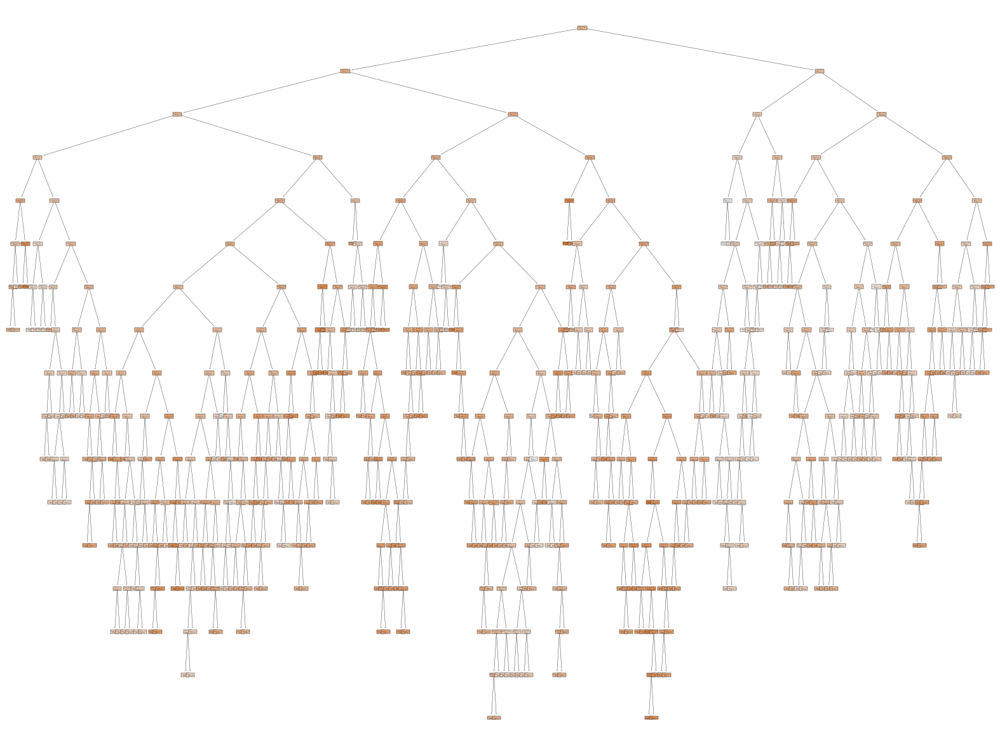

In [1696]:
dtree = DecisionTreeRegressor()
dtree.fit(X_train, y_train)

y_pred = dtree.predict(X_test)
y_pred_train=dtree.predict(X_train)

plt.figure(figsize=(20,15))
tree.plot_tree(dtree,filled=True, feature_names=X.columns,class_names=['0','1'])

Decision Tree Regressor on the training data and predicts both training and test outputs.
It then visualizes the full decision tree structure using plot_tree, showing how splits are made based on feature values.

In [1697]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)

It applies MinMax Scaling to normalize the training data so all feature values range between 0 and 1.

In [1698]:
X_train_scaled

array([[0.45182723, 0.53061224, 0.42675159, 0.5738255 ],
       [0.57142856, 0.34693878, 0.45254117, 0.31543624],
       [0.61794018, 0.36734694, 0.17281418, 0.61744966],
       ...,
       [0.54152822, 0.37755102, 0.36251754, 0.5033557 ],
       [0.40199335, 0.62244898, 0.56193698, 0.7852349 ],
       [0.81063118, 0.45918367, 0.32239375, 0.26845638]])

We have got X_train dataset between 0 and 1.

In [1699]:
X_test_scaled = scaler.transform(X_test)

In [1700]:
X_test_scaled

array([[ 0.25581395,  0.43877551,  0.56571545,  0.34228188],
       [ 0.93023255,  0.45918367,  0.95501817,  0.06711409],
       [ 0.05315615,  0.42857143,  0.45769909,  0.62416107],
       [ 0.57475086,  0.3877551 ,  0.45014214,  0.53691275],
       [ 0.42192689,  0.34693878,  0.51107752,  0.40268456],
       [ 0.23255814,  0.48979592,  0.55060156,  0.59060403],
       [ 1.00332223,  0.08163265,  0.23578874,  0.27852349],
       [ 0.3986711 ,  0.28571429,  0.08974774,  0.70469799],
       [ 0.21594683,  0.39795918,  0.41457651,  0.93959732],
       [ 0.49833889,  0.34693878,  0.38686771,  0.73825503],
       [ 0.82392028,  0.06122449,  0.46933439,  0.77181208],
       [ 0.33554816,  0.36734694,  0.57237276,  0.46979866],
       [ 0.58471762,  0.2755102 ,  0.59336428,  0.16778523],
       [ 0.53156145,  0.24489796,  0.22109468,  0.92281879],
       [ 0.85382057,  0.07142857,  0.10114314,  0.65771812],
       [ 0.74750832,  0.39795918,  0.27489294,  0.33557047],
       [ 0.26910299,  0.

We have changes X_test data between 0 and 1.

In [1701]:
model_scaled = LinearRegression()
model_scaled.fit(X_train_scaled,y_train)

y_pred_scaled = model_scaled.predict(X_test_scaled)
y_pred_train_scaled = model_scaled.predict(X_train_scaled)

mse_scaled = mean_squared_error(y_test,y_pred_scaled)
r2_scaled = r2_score(y_test,y_pred_scaled)

mse_train_scaled = mean_squared_error(y_train,y_pred_train_scaled)
r2_train_scaled = r2_score(y_train,y_pred_train_scaled)

print(f"Mean square error(scaled): {mse_train_scaled}")
print(f"R-squared(scaled:{r2_train_scaled})")

print(f"Mean square error(scaled): {mse_scaled}")
print(f"R-squared(scaled):{r2_scaled}")

Mean square error(scaled): 0.13758649769045198
R-squared(scaled:0.08727415917988102)
Mean square error(scaled): 0.1371658074840656
R-squared(scaled):0.1191896592765106


It prints the Mean Squared Error (MSE) and R-squared (R²) scores for both sets to assess model accuracy after scaling.

In [1702]:
print(f"Coefficients: {l_model.coef_}")
print(f"Intercept: {l_model.intercept_}")

Coefficients: [ 5.68640722e-02 -4.31037948e-04  1.84941447e+01 -1.27141920e+00]
Intercept: 0.7169102553298563


In [1703]:
print(f"Coefficients: {model_scaled.coef_}")
print(f"Intercept: {model_scaled.intercept_}")

Coefficients: [ 0.17116086 -0.04224172  0.30836027 -0.37888292]
Intercept: 0.6991458767403571


In [1704]:
def plot_confusionmatrix(y_train_pred,y_train,dom):
    print(f'{dom} Confusion matrix')
    cf = confusion_matrix(y_train_pred,y_train)
    sns.heatmap(cf,annot=True,cmap='Blues', fmt='g')#For g and G , the maximum number of significant digits
    plt.tight_layout()
    plt.show()

In [1705]:
reg = DecisionTreeRegressor()
reg.fit(X_train, y_train)

DecisionTreeRegressor()

It builds Decision Tree Regressor model and trains (fits) it using the training data (X_train and y_train). It learns decision rules from the input features to predict continuous target values.

In [1706]:
y_pred = reg.predict(X_test)

This line uses the trained DecisionTreeRegressor model reg to predict the target values (y_pred) for the test dataset X_test.

In [1707]:
y_pred

array([ 1.17,  0.4 ,  1.08,  0.47,  0.78,  0.3 ,  1.28,  1.08,  0.28,
        1.04,  1.07,  1.19,  1.34,  0.16,  0.28,  1.09, -0.08,  1.04,
        0.78,  0.78,  0.8 ,  0.78,  0.28,  1.11,  1.05,  1.07,  0.31,
        1.14,  0.75,  0.34,  1.12,  0.39,  1.33,  0.37,  0.38,  0.77,
        0.78,  1.35,  0.76,  1.05,  0.42,  0.95,  0.23,  0.72,  0.35,
        0.7 ,  0.75,  0.56,  0.42,  0.75,  0.47,  1.06,  0.38,  1.08,
        0.77,  1.32,  0.25,  0.69,  0.5 ,  0.91,  0.77,  1.36,  0.21,
        0.16,  1.06,  1.32,  1.09,  1.05,  0.42,  0.34,  1.41,  0.81,
        0.87,  1.06,  0.42,  0.77,  0.29,  0.61,  0.73,  0.27,  0.34,
        0.47,  0.73,  0.47,  1.07,  0.76,  1.07,  1.02,  0.46,  0.78,
        1.27,  0.29,  0.47,  0.23,  0.98,  1.29,  0.22])

In [1708]:
gbm_reg = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
gbm_reg.fit(X_train, y_train.ravel())

GradientBoostingRegressor(random_state=42)

It creates Gradient Boosting Regressor with 100 trees, a learning rate of 0.1, and a maximum depth of 3. It then trains the model on X_train and y_train, using boosting to iteratively reduce prediction errors.

In [1709]:
y_train_pred = gbm_reg.predict(X_train)
y_test_pred = gbm_reg.predict(X_test)

# Evaluate the model
mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)
rmse_test = np.sqrt(mse_test)
rmse_train = np.sqrt(mse_train)

print(f"Training R²: {r2_train:.2f}")
print(f"Testing R²: {r2_test:.2f}")
print(f"Training MSE: {mse_train:.2f}")
print(f"Testing MSE: {mse_test:.2f}")
print(f"Training RMSE: {rmse_train:.2f}")
print(f"Testing RMSE: {rmse_test:.2f}")

Training R²: 0.64
Testing R²: 0.23
Training MSE: 0.05
Testing MSE: 0.12
Training RMSE: 0.23
Testing RMSE: 0.35


It evaluates the performance of the trained Gradient Boosting model by calculating R², MSE, and RMSE for both training and testing datasets.

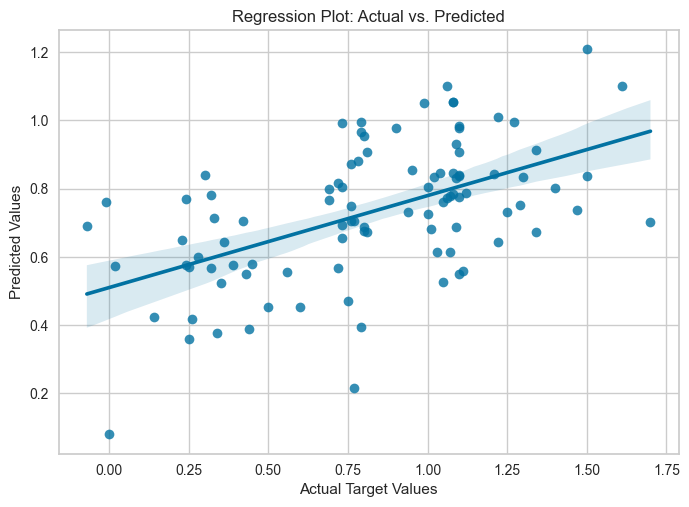

In [1710]:
sns.regplot(x=y_test, y=y_test_pred)

# Set plot labels and title
plt.xlabel("Actual Target Values")
plt.ylabel("Predicted Values")
plt.title("Regression Plot: Actual vs. Predicted")

# Display the plot
plt.show()

It shows the visualization of actual and predicted value using regression plot.

In [1711]:
lasso_model = Lasso(alpha=10)
lasso_model.fit(X_train_scaled,y_train)

y_pred_lasso=lasso_model.predict(X_test_scaled)
y_train_pred_lasso=lasso_model.predict(X_train_scaled)

train_mse_lasso = mean_squared_error(y_train,y_train_pred_lasso)
train_rmse_lasso=np.sqrt(train_mse_lasso)
train_r2_lasso = r2_score(y_train,y_train_pred_lasso)

test_mse_lasso = mean_squared_error(y_test,y_pred_lasso)
test_rmse_lasso = np.sqrt(test_mse_lasso)
test_r2_lasso = r2_score(y_test,y_pred_lasso)

print("Lasso Regression-Training set performance:")
print(f"Mse:{train_mse_lasso}")
print(f"Rmse:{train_rmse_lasso}")
print(f"R2:{train_r2_lasso}")

print("\nLasso Regression-Testing set performace:")
print(f"Mse:{test_mse_lasso}")
print(f"Rmse:{test_rmse_lasso}")
print(f"R2:{test_r2_lasso}")

Lasso Regression-Training set performance:
Mse:0.1507424152326237
Rmse:0.3882556055392165
R2:0.0

Lasso Regression-Testing set performace:
Mse:0.16279182172053053
Rmse:0.4034746853527871
R2:-0.045367811313438144


It creates Lasso Regression model (with L1 regularization, α=10) on scaled training data, then predicts on both training and test sets. It calculates and prints MSE, RMSE, and R² scores for evaluating model accuracy and overfitting on both datasets.

In [1712]:
ridge_model=Ridge(alpha=0.1)
ridge_model.fit(X_train_scaled,y_train)

y_pred_ridge=ridge_model.predict(X_test_scaled)
y_train_pred_ridge=ridge_model.predict(X_train_scaled)

train_mse_ridge=mean_squared_error(y_train,y_train_pred_ridge)
train_rmse_ridge=np.sqrt(train_mse_ridge)
train_r2_ridge=r2_score(y_train,y_train_pred_ridge)

test_mse_ridge=mean_squared_error(y_test,y_pred_ridge)
test_rmse_ridge=np.sqrt(test_mse_ridge)
test_r2_ridge=r2_score(y_test,y_pred_ridge)

print("Ridge regression-training set performance:")
print(f"Mse:{train_mse_ridge}")
print(f"Rmse:{train_rmse_ridge}")
print(f"R2:{test_r2_ridge}")

print("\nRideg regression-testing set performance:")
print(f"Mse:{test_mse_ridge}")
print(f"Rmse:{test_mse_ridge}")
print(f"R2:{test_r2_ridge}")

Ridge regression-training set performance:
Mse:0.13758687271977701
Rmse:0.37092704500990087
R2:0.11885164127948455

Rideg regression-testing set performance:
Mse:0.13721844595725624
Rmse:0.13721844595725624
R2:0.11885164127948455


It creates Ridge Regression (L2 regularization, α=0.1) on scaled data, then predicts and evaluates both training and testing performance.

In [1713]:
scaler=StandardScaler()
X_scaled=scaler.fit_transform(X)

np.random.seed(42)
weights=np.random.rand(X_scaled.shape[1])
bias=np.random.rand()

learning_rate=0.01
epochs=100
n=len(y)

for epoch in range(epochs):
    y_pred=np.dot(X_scaled,weights)+bias
    error=y_pred-y

    dw=(1/n)*np.dot(X_scaled.T,error)
    db=(1/n)*np.sum(error)

    weights-=learning_rate*dw
    bias-=learning_rate*db

    loss=(1/n)*np.sum(error**2)

    if epoch%100==0:
        print(f"Epoch{epoch}:Loss={loss:.2f}")

print("Optimized Weights:",weights)
print("Optimized Bias:",bias)  

final_predictions=np.dot(X_scaled,weights)+bias
print("Predicted Prices:",final_predictions)

lr=LinearRegression()
lr.fit(X_scaled,y)
sklearn_preds=lr.predict(X_scaled)
sklearn_loss=mean_squared_error(y,sklearn_preds)

print("\nScikit_learn Linear REgression Loss:",sklearn_loss)
print("Scikit_Learn Predicted Prices:",sklearn_preds)
print(r2_score(sklearn_preds,y))

Epoch0:Loss=2.34
Optimized Weights: [0.2425729  0.34986503 0.34293962 0.15658142]
Optimized Bias: 0.536075028380028
Predicted Prices: [ 0.17853877  0.70288677  0.21104409  0.68177478  0.2722563   1.07993413
  0.49726651  1.43589162  0.59351488  0.83273869  0.86360068  0.23337401
  0.84277124  0.18271199  0.71836489  0.12092023  1.826778   -0.24554038
  0.18268015  0.03177743  0.19887204  0.23272955  0.12950006  0.06643984
 -0.00910447  0.02929215 -0.31093693  0.24303685  1.01660834  0.62284534
  1.40687434  0.41291892 -0.25171285  0.91001742  0.57997359  0.10412775
  0.04993392  0.77457319  1.67601785  1.34076603  0.64239355  0.9782198
  0.12507041  0.45264397  0.29677979  0.23641923  0.23786263  1.02162867
  0.67014646  1.49851085  0.94718592 -0.72650565  0.94868572 -0.71862207
 -0.06037336  1.18427829  0.29979281 -0.15637206  0.45220572  0.12299222
  0.95494452  1.68447175  0.55524323  0.88784009  0.43896761 -0.39006942
  0.18268277  0.20289197 -0.20251398  0.65616918  0.33917912 -0.

It implements linear regression using gradient descent by initializing weights and bias, updating them over 100 epochs to minimize mean squared error. It compares the custom model's predictions with scikit-learn’s LinearRegression, printing both predictions, loss, and R² score for evaluation.

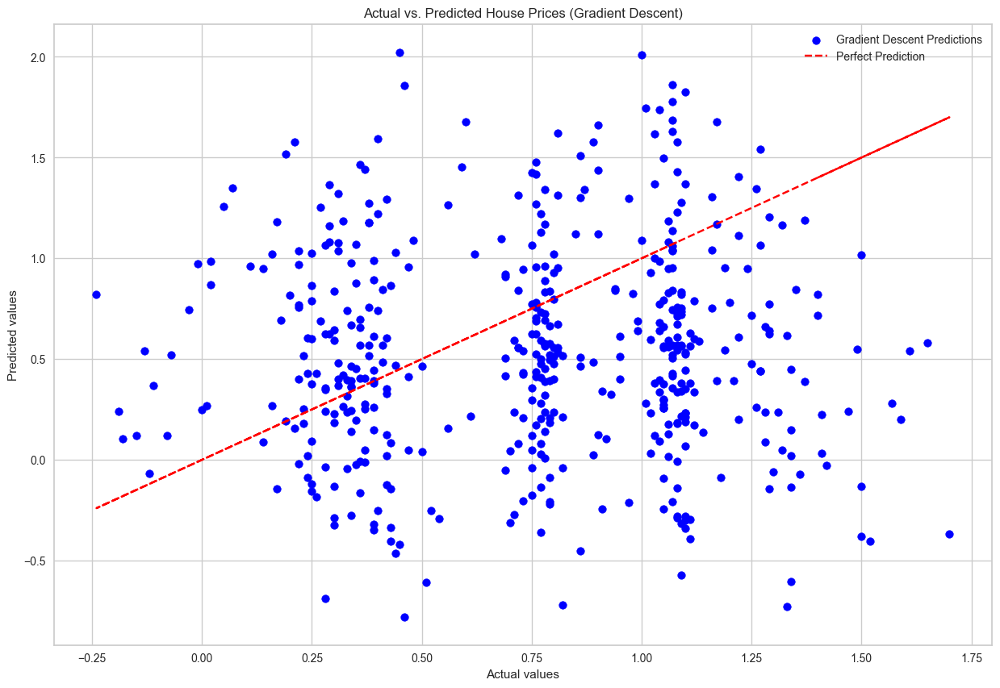

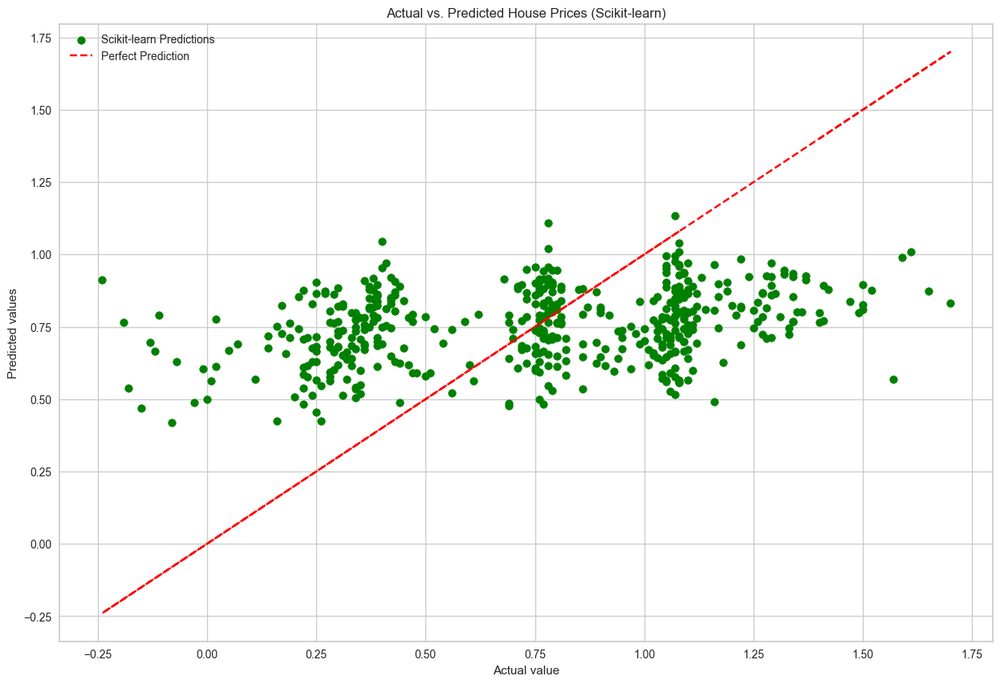

In [1714]:
plt.figure(figsize=(15, 10))
plt.scatter(y, final_predictions, color='blue', label='Gradient Descent Predictions')
plt.plot(y, y, color='red', linestyle='--', label='Perfect Prediction')  # Ideal line
plt.xlabel("Actual values")
plt.ylabel("Predicted values")
plt.title("Actual vs. Predicted House Prices (Gradient Descent)")
plt.legend()
plt.grid(True)
plt.show()


plt.figure(figsize=(15, 10))
plt.scatter(y, sklearn_preds, color='green', label='Scikit-learn Predictions')
plt.plot(y, y, color='red', linestyle='--', label='Perfect Prediction')  # Ideal line
plt.xlabel("Actual value")
plt.ylabel("Predicted values")
plt.title("Actual vs. Predicted House Prices (Scikit-learn)")
plt.legend()
plt.grid(True)
plt.show()

The first plot shows predictions from the gradient descent model, with a red dashed line indicating perfect predictions.

The second plot displays predictions from the scikit-learn Linear Regression, also compared against the ideal prediction line, helping visually assess each model’s accuracy.

Epoch 0: Loss = 0.47


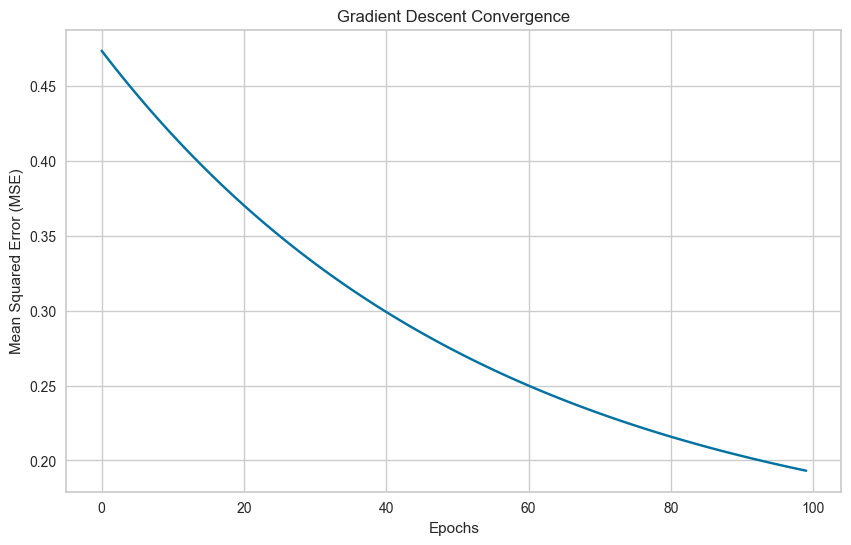

In [1715]:
losses = [] 
for epoch in range(epochs):
    y_pred = np.dot(X_scaled, weights) + bias  
    error = y_pred - y

    dw = (1/n) * np.dot(X_scaled.T, error)
    db = (1/n) * np.sum(error)

    weights -= learning_rate * dw
    bias -= learning_rate * db

    loss = (1/n) * np.sum(error**2)
    losses.append(loss) 
    if epoch % 100 == 0:  
        print(f"Epoch {epoch}: Loss = {loss:.2f}")

plt.figure(figsize=(10, 6))
plt.plot(range(epochs), losses)
plt.xlabel("Epochs")
plt.ylabel("Mean Squared Error (MSE)")
plt.title("Gradient Descent Convergence")
plt.grid(True)
plt.show()

It performs gradient descent for linear regression, updating weights and bias over multiple epochs to minimize prediction error (MSE). The plot visualizes the loss reduction across epochs, showing how the model converges as the training progresses.

In [1716]:
df['mag'] = df['mag'].apply(lambda x: 0 if x <= 1.0 else 1)

It transforms the 'mag' (magnitude) column into binary values using a lambda function. It assigns 0 if the magnitude is ≤ 1.0, and 1 otherwise, effectively converting it into a classification target.

In [1717]:
df

,depth,mag,gap,dmin,magError
20,2.75,1,61.0,0.002175,0.26
74,3.13,0,95.0,0.005189,0.07
76,2.03,0,67.0,0.006166,0.18
78,2.11,1,43.0,0.012520,0.26
81,1.87,1,48.0,0.012850,0.08
...,...,...,...,...,...
9276,2.14,0,84.0,0.009038,0.09
9282,2.04,1,67.0,0.006816,0.12
9288,1.40,0,103.0,0.012980,0.14
9296,1.95,1,58.0,0.011120,0.29


Now we have mag column as 0 and 1 with this it will be easy to build logistic regression model.

In [1718]:
df['target'] = df['mag'] 

We assigning target as mag.

In [1719]:
x1 = df.drop(columns=['mag', 'target'])
y1 = df['target']

We are dropping the mag from dataset and assign it to y1,remaining columns are assign to x1

In [1720]:
y1

20      1
74      0
76      0
78      1
81      1
       ..
9276    0
9282    1
9288    0
9296    1
9317    1
Name: target, Length: 483, dtype: int64

We have seperated the mag column.

In [1721]:
y1.shape

(483,)

We have 483 rows and 0 columns.

In [1722]:
x1_train, x1_test, y1_train, y1_test = train_test_split(x1, y1, test_size=0.2, random_state=42)


We are spilliting the data into train and test to perfrom the logistic regression. We haev assigned 20% of data as test data from the dataset.

In [1723]:
x1_train

,depth,gap,dmin,magError
8013,3.27,43.0,0.005931,0.132
426,1.42,52.0,0.009987,0.140
4291,1.80,85.0,0.004252,0.250
7720,1.98,60.0,0.012330,0.320
4446,1.86,84.0,0.008509,0.170
...,...,...,...,...
2089,1.99,73.0,0.011600,0.282
5559,1.90,66.0,0.011020,0.322
6803,2.36,114.0,0.002019,0.100
8414,3.20,49.0,0.006514,0.250


In [1724]:
x1_train.shape

(386, 4)

We have 386 rows and 4 columns.

In [1725]:
x1_test

,depth,gap,dmin,magError
8069,2.49,66.0,0.002400,0.165
9204,1.31,101.0,0.012570,0.060
3514,0.84,106.0,0.004821,0.190
8564,2.26,59.0,0.009948,0.180
5915,2.04,91.0,0.006840,0.160
...,...,...,...,...
4256,2.29,61.0,0.007793,0.240
7626,3.61,59.0,0.004183,0.243
6362,1.93,55.0,0.010200,0.246
6527,1.98,83.0,0.004062,0.180


In [1726]:
x1_test.shape

(97, 4)

We have 97 rows and 4 columns.

In [1727]:
y1_train

8013    0
426     0
4291    0
7720    0
4446    1
       ..
2089    0
5559    0
6803    0
8414    1
1975    1
Name: target, Length: 386, dtype: int64

In [1728]:
y1_train.shape

(386,)

We have 386 rows and 0 columns.

In [1729]:
y_test

3344    0.33
7950    1.07
6480    0.23
474     0.76
8957    1.21
        ... 
6078    0.25
7314    0.60
8891    0.45
3703    1.08
8614    0.77
Name: mag, Length: 97, dtype: float64

In [1730]:
y_test.shape

(97,)

We have 97 rows and 0 columns.

In [1731]:
scaler = StandardScaler()
x1_train_scaled = scaler.fit_transform(x1_train)
x1_test_scaled = scaler.transform(x1_test)

This code standardizes the training and testing feature sets using StandardScaler, which scales features to have mean = 0 and standard deviation = 1. fit_transform() is applied to the training data to learn scaling parameters, and transform() is applied to the test data using the same parameters.

In [1732]:
model = LogisticRegression()
model.fit(x1_train_scaled, y1_train)

LogisticRegression()

We have build the logistic regression with input as x1_train_scaled and y1_train

In [1733]:
y1_pred = model.predict(x1_test_scaled)


It uses the trained model to predict target values (y1_pred) for the scaled test dataset x1_test_scaled.
The predictions are based on the patterns the model learned during training.

In [1734]:
y1_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int64)

In [1735]:
rfe = RFE(model)

It creates Recursive Feature Elimination (RFE) using the given model (e.g., a linear regression or decision tree). RFE helps in selecting the most important features by recursively removing the least significant ones based on model coefficients or importance.

In [1736]:
rfe.fit(x1, y1)

RFE(estimator=LogisticRegression())

We have build the Recursive Feature Elimination (RFE) model.

In [1737]:
rfe.support_

array([ True, False, False,  True])

rfe.support_ returns a boolean array indicating which features are selected by the Recursive Feature Elimination (RFE) process. True means the feature was selected, while False means it was not chosen among the top features.

In [1738]:
selected_indices = [i for i,data in enumerate(rfe.support_) if data==True ]
selected_indices

[0, 3]

It uses list comprehension to find the indices of features selected by RFE (i.e., where rfe.support_ is True). The resulting selected_indices list contains the positions of the most important features retained by the RFE process.

In [1739]:
column_names = x1.columns

We are assigning the x1.columns to new name.

In [1740]:
selected_column_name = [column_names[i] for i in selected_indices]

It retrieves the names of the features selected by RFE using their indices from selected_indices.

In [1741]:
selected_column_name

['depth', 'magError']

It creates a list selected_column_name containing the actual column names of the important features.

In [1742]:
x1 = x1.loc[:,['depth', 'magError']]

We are the assigning the rest of the columns to x1.

In [1743]:
x1

,depth,magError
20,2.75,0.26
74,3.13,0.07
76,2.03,0.18
78,2.11,0.26
81,1.87,0.08
...,...,...
9276,2.14,0.09
9282,2.04,0.12
9288,1.40,0.14
9296,1.95,0.29


In [1744]:
x1.shape

(483, 2)

It has 483 rows and 2 columns 

In [1745]:
y1

20      1
74      0
76      0
78      1
81      1
       ..
9276    0
9282    1
9288    0
9296    1
9317    1
Name: target, Length: 483, dtype: int64

In [1746]:
y1.shape

(483,)

It has 483 rows and 0 columns.

In [1747]:
accuracy_score(y1_test, y1_pred)

0.5567010309278351

The accuracy_score(y1_test, y1_pred) function compares the actual labels (y1_test) with the predicted labels (y1_pred). It returns the proportion of correct predictions, indicating how accurately the model classified the test data.

In [1748]:
confusion_matrix(y1_test, y1_pred)

array([[47, 12],
       [31,  7]], dtype=int64)

The confusion_matrix(y1_test, y1_pred) function creates a matrix showing the counts of true positives, true negatives, false positives, and false negatives. It helps evaluate the classification model's performance by showing where the predictions were correct or incorrect.

In [1749]:
y1

20      1
74      0
76      0
78      1
81      1
       ..
9276    0
9282    1
9288    0
9296    1
9317    1
Name: target, Length: 483, dtype: int64

In [1750]:
x1

,depth,magError
20,2.75,0.26
74,3.13,0.07
76,2.03,0.18
78,2.11,0.26
81,1.87,0.08
...,...,...
9276,2.14,0.09
9282,2.04,0.12
9288,1.40,0.14
9296,1.95,0.29


In [1751]:
with open("Earthquake Model.pkl","wb") as f:
    pickle.dump(gbm_reg,f)

It saves the trained Gradient Boosting Regressor model (gbm_reg) to a file named "Earthquake Model.pkl" using Python's pickle module. This allows the model to be reused later without retraining.

In [1752]:
with open("Earthquake Model.pkl","rb") as f:
    model=pickle.load(f)

It loads the previously saved model "Earthquake Model.pkl" using pickle. The loaded model is stored in the variable model for making predictions or further analysis.

In [1753]:
model.predict([[4,48488, 28, 278499]])

array([0.57970877])

It uses the loaded model to predict the target value for the input features [4, 48488, 28, 278499]. The model returns the predicted output based on its training, likely representing an earthquake-related parameter such as magnitude or risk level.